# AgriSpectra

AgriSpectra is an AI-powered agricultural platform that will combine smartphone image analysis of crops and satellite data to help diagnose problems early and predict yields, providing care recommendations for each detected crop, growth stage, type and extent of damage.        

# Dataset description

Here I'm going to research Eyes on the ground dataset. Beacuse it already contains smartphone photos, yields estimations and ancillary data.     
       
The "Eyes on the Ground" project ([lacunafund.org](lacunafund.org)) is a collaboration between ACRE Africa, the International Food Policy Research Institute (IFPRI), and the Lacuna Fund, to create a large machine learning (ML) dataset of smallholder farmer's fields based upon previous work within the Picture Based Insurance framework (Ceballos, Kramer and Robles, 2019, [https://doi.org/10.1016/j.deveng.2019.100042](https://doi.org/10.1016/j.deveng.2019.100042)). This is a unique dataset of georeferenced crop images along with labels on input use, crop management, phenology, crop damage, and yields, collected across 8 counties in Kenya. The research leading to this dataset was undertaken as part of the CGIAR research program on Policies, Institutions and Markets (PIM)        
            
Data are anonymized by only providing regional bounding boxes. Their geo-spatial component is therefore explicitly regional. However, to provide opportunities for making links to remote sensing data and using the data in a more varied way we provide a number of ancillary data sets extracted at point locations for farmer fields.         
            
Dataset consists of:          
              
- 28K curated crop images for machine learning
- crop damage labels, either manually provided or automatically determined
- Sentinel 2 data to calculate vegetation indices
- ARC and TAMSAT precipitation estimates
- ERA5 climate variables (limited to 09/07/2021)

In this work I'm going to use only image data and labels, my goal is to predict: - crop, crop damage, crop damage extent, crop growth stage.   
I've made my own dataset on Kaggle and also find some similar dataset here, on Kaggle, which I'm going to use fore fill in the NaN values in labels in my own dataset.    

# Data preparation

Here we are going to extract data from folders (.json files in separated folders), organize it as pandas DataFrames and to check it for NaN and duplicates.

In [1]:
!pip install imagehash --quiet

In [2]:
import os
import json
import copy
import math
import warnings
import imagehash
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import torch
import torchvision.transforms.functional as F
import torch.nn as nn
from torchvision.models import resnet18, efficientnet_b0, ResNet18_Weights, EfficientNet_B0_Weights
from torch.utils.data import Dataset
from torchvision import transforms
from torch.utils.data import DataLoader
from torch.optim.lr_scheduler import ReduceLROnPlateau
from glob import glob
from typing import List, Dict, Any, Optional
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from sklearn.utils.class_weight import compute_class_weight
from collections import defaultdict
from PIL import Image, ImageStat
from tqdm import tqdm
from IPython.display import clear_output


warnings.filterwarnings('ignore')

## Data extraction

In [3]:
def collect_json_files(root_dir: str) -> List[str]:
    """Recursively collect all .json files from the nested folder structure."""
    pattern = os.path.join(root_dir, "**", "*.json")
    return glob(pattern, recursive=True)

In [4]:
def parse_json_file(json_path: str) -> Optional[Dict[str, Any]]:
    """Parse a single JSON file and extract relevant metadata fields."""
    try:
        with open(json_path, 'r') as f:
            data = json.load(f)

        result = {}
        # Extract fields from root
        for field in FIELDS_ROOT:
            result[field] = data.get(field)

        # Extract fields from 'properties'
        properties = data.get("properties", {})
        for field in FIELDS_PROPERTIES:
            result[field] = properties.get(field)

        return result

    except Exception as e:
        print(f"Error parsing {json_path}: {e}")
        return None

In [5]:
def aggregate_metadata(json_files: List[str]) -> pd.DataFrame:
    """Aggregate metadata from all JSON files into a DataFrame."""
    records = []
    for file in json_files:
        metadata = parse_json_file(file)
        if metadata:
            records.append(metadata)

    df = pd.DataFrame(records)
    return df

In [6]:
# Check first folder with images descriptions
ROOT_DIR = "/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/EotG_images"
FIELDS_ROOT = ["id"]
FIELDS_PROPERTIES = [
    "farmer_unique_id",
    "site_id",
    "crop_name",
    "sowing_date",
    "expected_yield",
    "season",
    "spatial_location",
    "spatial_unit",
    "datetime"
]

In [7]:
json_files = collect_json_files(ROOT_DIR)
print(f"Found {len(json_files)} JSON files.")

Found 28130 JSON files.


In [8]:
metadata_df = aggregate_metadata(json_files)
print(f"Aggregated {len(metadata_df)} records.")

Aggregated 28130 records.


In [9]:
# Now check labels data
ROOT_DIR = "/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/labels"

In [10]:
def agregate_labels(json_files):
    """
    Consolidate data from a list of .json file paths into a single pandas DataFrame.
    Args:
        json_files (list): List of paths to .json files.
    Returns:
        pd.DataFrame: Consolidated DataFrame.
        int: Number of files that caused errors.
    """
    records = []
    error_count = 0

    # Process each file
    for json_file in json_files:
        try:
            with open(json_file, 'r') as f:
                data = json.load(f)
                if isinstance(data, list) and len(data) == 1 and isinstance(data[0], dict):
                    records.append(data[0])
                else:
                    error_count += 1
        except Exception:
            error_count += 1

    df = pd.DataFrame(records)
    return df, error_count

In [11]:
json_files_labels = collect_json_files(ROOT_DIR)
print(f"Found {len(json_files_labels)} JSON files.")

Found 28077 JSON files.


In [12]:
labels_df, errors_count = agregate_labels(json_files_labels)
print(f"Aggregated {len(labels_df)} records.")

Aggregated 28077 records.


## Base checking: missed values, duplicates

In [13]:
metadata_df.head(3)

,id,farmer_unique_id,site_id,crop_name,sowing_date,expected_yield,season,spatial_location,spatial_unit,datetime
0,EotG_images,None,NaN,None,None,NaN,None,None,None,None
1,Mwea,None,NaN,None,None,NaN,None,None,None,None
2,img_101_repeat_2_1309_415_287,TN2213,1309.0,maize,2020-02-13,2000.0,LR2020,Mwea,gadm36,2020-05-06T14:21:50Z


Looks like some rows maded from folders names and contains too many NaN values, so we can easely drop NaN.

In [14]:
metadata_df = metadata_df.dropna()
metadata_df.shape

(28077, 10)

The size of metadata_df is similar to dataset size in description, so, our assumption was correct, seems like we didn't lose any necessary data because of droping NaN.

In [15]:
metadata_df.head(3)

,id,farmer_unique_id,site_id,crop_name,sowing_date,expected_yield,season,spatial_location,spatial_unit,datetime
2,img_101_repeat_2_1309_415_287,TN2213,1309.0,maize,2020-02-13,2000.0,LR2020,Mwea,gadm36,2020-05-06T14:21:50Z
3,img_101_initial_1_1309_1309,TN2213,1309.0,maize,2020-02-13,2000.0,LR2020,Mwea,gadm36,2020-04-27T00:00:00Z
4,img_101_repeat_2_1309_295_209,TN2213,1309.0,maize,2020-02-13,2000.0,LR2020,Mwea,gadm36,2020-05-06T09:39:56Z


In [16]:
labels_df.head(3)

,farmer_unique_id,site_id,date,filename,season,growth_stage,damage,extent,drought_probability,drought_extent,growth_sowing,growth_vegetative,growth_flowering,growth_maturity,disturbance_none,disturbance_weeds,disturbance_drought,disturbance_nutrient_deficit,crop_name,spatial_location
0,1309556,1630,2021-01-16 18:14:31,L131F03895C01S01630Rp10906.jpg,SR2020,M,PS,10.0,0.0602,1.0,0.0002,0.0355,0.7163,0.2480,0.0723,0.9024,0.0251,0.0002,maize,Mbeere-South
1,BN032,1526,2020-11-29 16:53:27,L1102F00034C01S01526Rp01944.jpg,SR2020,F,WD,10.0,0.0006,2.0,0.0005,0.3990,0.2286,0.3719,0.0332,0.9643,0.0024,0.0000,maize,Kanduyi
2,BN020,7656,2021-06-18 09:39:55,L1084F00023C01S07656Rp25836.jpg,LR2021,F,WD,30.0,0.1307,31.0,0.0001,0.0192,0.4658,0.5149,0.0419,0.9251,0.0195,0.0135,maize,Teso-North


In [17]:
# Check missed data
labels_df.isna().sum()

farmer_unique_id                   0
site_id                            0
date                               0
filename                           0
season                             0
growth_stage                    6535
damage                          6535
extent                          6535
drought_probability             2708
drought_extent                  2708
growth_sowing                   2708
growth_vegetative               2708
growth_flowering                2708
growth_maturity                 2708
disturbance_none                2708
disturbance_weeds               2708
disturbance_drought             2708
disturbance_nutrient_deficit    2708
crop_name                          0
spatial_location                   0
dtype: int64

In [18]:
# Check some missed labels from Kaggle dataset eyes-on-the-ground with same name and image ids
labels_test = pd.read_csv(
    '/kaggle/input/eyes-on-the-ground/content/drive/MyDrive/machine_learning_stories/Eyes on the ground/test.csv'
)
labels_train = pd.read_csv(
    '/kaggle/input/eyes-on-the-ground/content/drive/MyDrive/machine_learning_stories/Eyes on the ground/train.csv'
)
combined_labels = pd.concat([labels_test,labels_train], axis=0, ignore_index=True)
combined_labels.head(3)

,ID,filename,growth_stage,damage,season,extent
0,ID_ROOWKB90UZ,L122F00315C01S02151Rp04021.jpg,V,WD,SR2020,NaN
1,ID_PTEDRY0CYM,L1089F03254C01S08845Rp25119.jpg,F,WD,LR2021,NaN
2,ID_5WJXDV96R4,L365F01913C39S12578Rp42918.jpg,V,WD,SR2021,NaN


In [19]:
merged = labels_df.merge(
    combined_labels[['filename', 'growth_stage', 'damage', 'extent']],
    on='filename',
    how='left',
    suffixes=('', '_new')
)

for col in ['growth_stage', 'damage', 'extent']:
    merged[col] = merged[col].fillna(merged[f'{col}_new'])

labels_df = merged.drop(columns=[f'{col}_new' for col in ['growth_stage', 'damage', 'extent']])

labels_df.isna().sum()

farmer_unique_id                   0
site_id                            0
date                               0
filename                           0
season                             0
growth_stage                    6535
damage                          6535
extent                          6535
drought_probability             2708
drought_extent                  2708
growth_sowing                   2708
growth_vegetative               2708
growth_flowering                2708
growth_maturity                 2708
disturbance_none                2708
disturbance_weeds               2708
disturbance_drought             2708
disturbance_nutrient_deficit    2708
crop_name                          0
spatial_location                   0
dtype: int64

In [20]:
merged.isna().sum()

farmer_unique_id                    0
site_id                             0
date                                0
filename                            0
season                              0
growth_stage                     6535
damage                           6535
extent                           6535
drought_probability              2708
drought_extent                   2708
growth_sowing                    2708
growth_vegetative                2708
growth_flowering                 2708
growth_maturity                  2708
disturbance_none                 2708
disturbance_weeds                2708
disturbance_drought              2708
disturbance_nutrient_deficit     2708
crop_name                           0
spatial_location                    0
growth_stage_new                 6535
damage_new                       6535
extent_new                      11967
dtype: int64

Dataset eyes-on-the-ground from Kaggle have same missed data, as mine, eyes-on-the-ground-image-data, so all I can do is drop NaN for labels_df. But before let's check columns from labels data.          
                     
From README.md from dataset:        
Machine Learning labels provided consist of:

### Manual labels (json label)

- growth stage (growth_stage)
- damage type (damage)
- damage extent (extent)

### ML labels (json label)

- drought probability (drought_probability)
- drought extent (drought_extent)
- sowing phase (growth_sowing)
- vegetative phase (growth_vegetative)
- flowering phase (growth_flowering)
- maturity phase (growth_maturity)
- no disturbance probability (disturbance_none)
- weed disturbance (disturbance_weed)
- drought disturbance (disturbance_drought)
- nutrient deficit (disturbance_nutrient_deficit)

So, firstly drop ML labels, then drop NaN. Left only those labels, which we are going to predict: 'crop_name', 'growth_stage', 'damage', 'extent'. Also, lets keep information regerding farmer, site and season, we need to use it for leakage prevention while spliting dataset into train\test\valid.

In [21]:
labels_df = labels_df[[
    'filename', 'farmer_unique_id', 'site_id', 'season', 'crop_name', 'growth_stage', 'damage', 'extent'
]]
labels_df.head(3)

,filename,farmer_unique_id,site_id,season,crop_name,growth_stage,damage,extent
0,L131F03895C01S01630Rp10906.jpg,1309556,1630,SR2020,maize,M,PS,10.0
1,L1102F00034C01S01526Rp01944.jpg,BN032,1526,SR2020,maize,F,WD,10.0
2,L1084F00023C01S07656Rp25836.jpg,BN020,7656,LR2021,maize,F,WD,30.0


In [22]:
labels_df.isna().sum()

filename               0
farmer_unique_id       0
site_id                0
season                 0
crop_name              0
growth_stage        6535
damage              6535
extent              6535
dtype: int64

In [23]:
labels_df = labels_df.dropna()
labels_df.isna().sum()

filename            0
farmer_unique_id    0
site_id             0
season              0
crop_name           0
growth_stage        0
damage              0
extent              0
dtype: int64

In [24]:
labels_df.shape

(21577, 8)

In [25]:
# Check for duplicates
# Check for exact row duplicates
duplicate_rows = labels_df[labels_df.duplicated()]
print(f"Exact duplicate rows in labels_df: {len(duplicate_rows)}")

# Check for duplicate filenames only
duplicate_filenames = labels_df[labels_df.duplicated(subset='filename')]
print(f"Duplicate filenames: {len(duplicate_filenames)}")

Exact duplicate rows in labels_df: 35
Duplicate filenames: 35


In [26]:
# Drop exact duplicates
labels_df = labels_df.drop_duplicates()

# Drop any later duplicates by filename, keeping the first
labels_df = labels_df.drop_duplicates(subset='filename', keep='first')

print(f"After deduplication: {len(labels_df)} rows")

After deduplication: 21542 rows


Looks like duplicated filenames were in duplicated rows, because initial size 21577 is equal to resulting size 21542 plus duplicated rows quantity 35 which is the same as duplicated filenames quantity 35.

Seems like we can't add nothing from metadata_df on this stage of the research, beacuse we have all needed for current investigation labels and information in labels_df.    
Now, let's check target distribution and images in the dataset.

# EDA

The meaning of labels.     


Growth Stages:  
 - F	Flowering   
 - M	Maturity   
 - S	Sowing   
 - V	Vegetative    
        
Damage types:    
 - DR	Drought   
 - DS	Disease    
 - FD	Flood    
 - G	Good (growth)    
 - ND	Nutrient Deficient     
 - PS	Pest     
 - WD	Weed     
 - WN	Wind

And let's assume that 'extent' is the percentage of the damage, from 0 to 100.

## Label cardinality 

In [27]:
# Check label cardinality 
for col in ['crop_name', 'growth_stage', 'damage', 'extent']:
    print(f"{col}: {labels_df[col].nunique()} unique classes")

crop_name: 4 unique classes
growth_stage: 4 unique classes
damage: 8 unique classes
extent: 11 unique classes


In [28]:
# Check features cardinality
for col in ['farmer_unique_id', 'site_id', 'season']:
            print(f'{col}: {labels_df[col].nunique()} unique values')

farmer_unique_id: 2753 unique values
site_id: 4151 unique values
season: 3 unique values


## Target distribution


=== Distribution for 'crop_name' ===
crop_name
maize         20910
green gram      411
sorghum         206
soybean          15
Name: count, dtype: int64


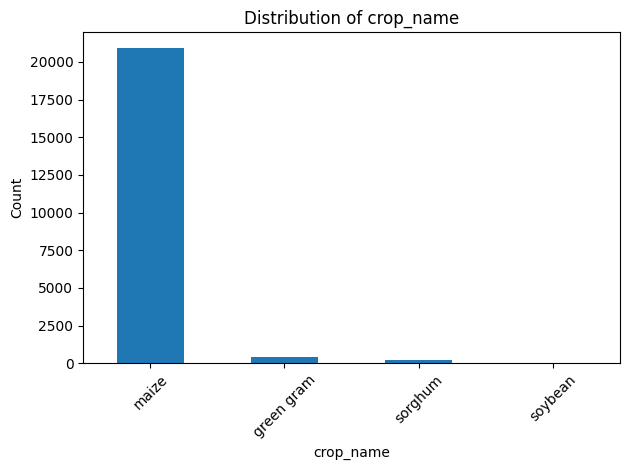


=== Distribution for 'growth_stage' ===
growth_stage
V    8611
F    6069
M    5783
S    1079
Name: count, dtype: int64


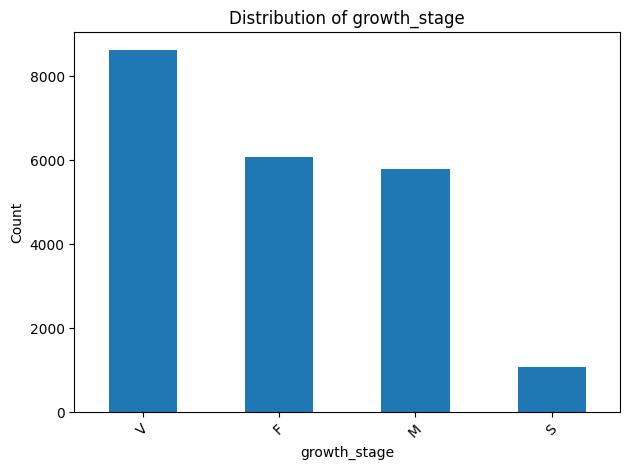


=== Distribution for 'damage' ===
damage
G     8993
WD    7933
DR    3949
ND     327
PS     186
DS     134
WN      17
FD       3
Name: count, dtype: int64


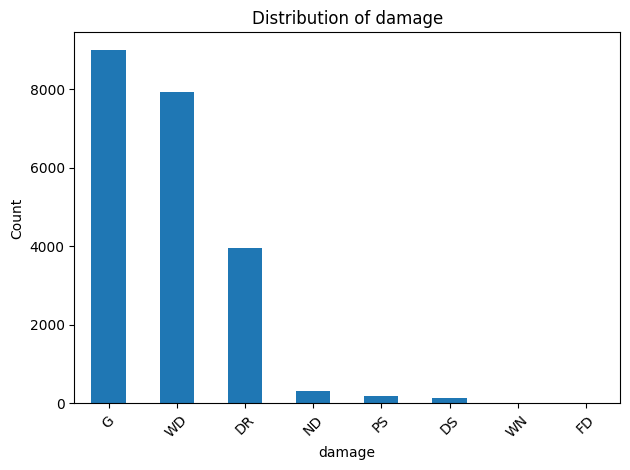


=== Distribution for 'extent' ===
extent
0.0      8984
10.0     4475
20.0     2718
30.0     1856
40.0     1364
50.0      678
60.0      491
80.0      359
90.0      357
70.0      256
100.0       4
Name: count, dtype: int64


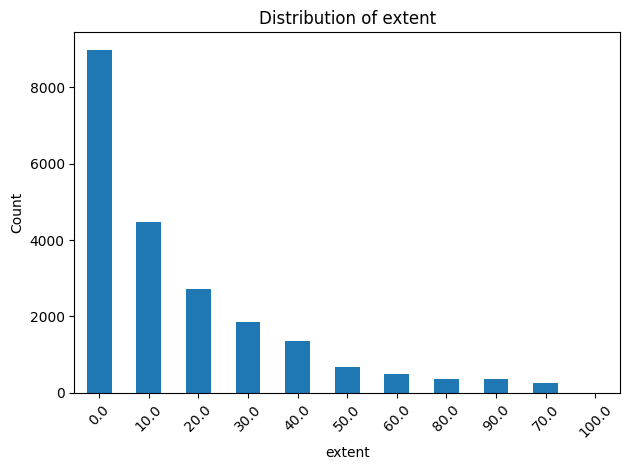


=== Distribution for 'farmer_unique_id' ===
farmer_unique_id
BN004      99
BN020      96
EM1211     77
ME3536     74
ME3541     62
           ..
3983966     1
973510      1
1153551     1
1862150     1
99062       1
Name: count, Length: 2753, dtype: int64


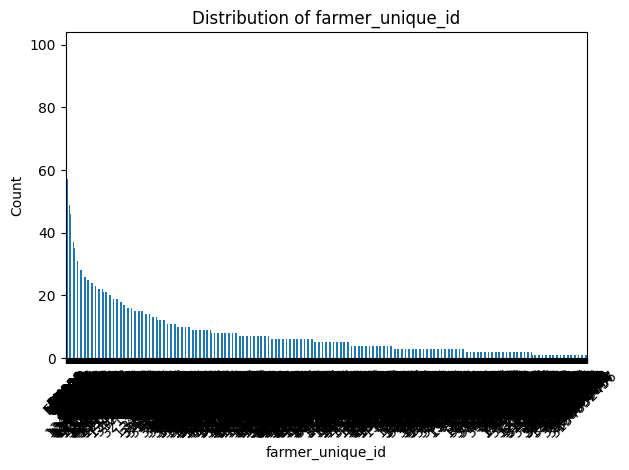


=== Distribution for 'site_id' ===
site_id
1078     57
2052     48
1085     45
2416     40
2419     39
         ..
8372      1
9420      1
11225     1
9295      1
9009      1
Name: count, Length: 4151, dtype: int64


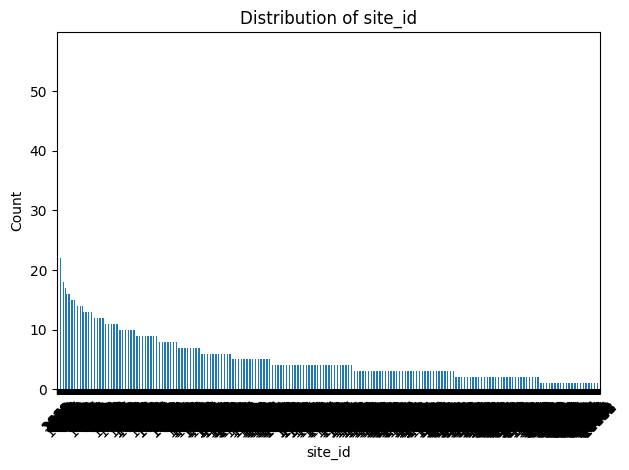


=== Distribution for 'season' ===
season
LR2021    10583
SR2020     8234
LR2020     2725
Name: count, dtype: int64


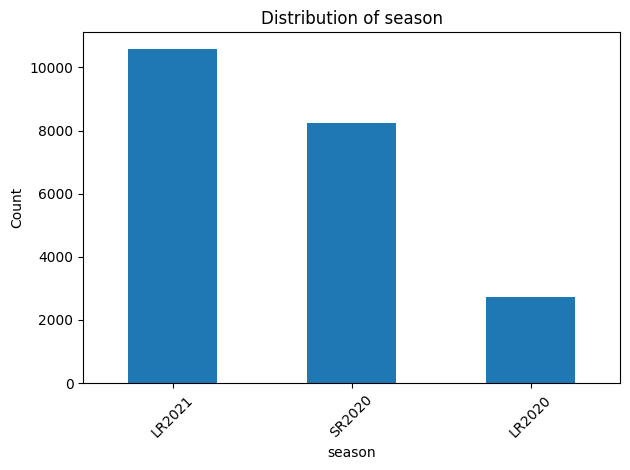

In [29]:
# Lets check the distribution of targets and features
columns_to_analyze = ['crop_name', 'growth_stage', 'damage', 'extent', 'farmer_unique_id', 'site_id', 'season']

# Show unique value counts and plot distributions
for col in columns_to_analyze:
    print(f"\n=== Distribution for '{col}' ===")
    print(labels_df[col].value_counts(dropna=False))
    
    # Plot
    labels_df[col].value_counts(dropna=False).plot(kind='bar', title=f"Distribution of {col}")
    plt.xlabel(col)
    plt.ylabel("Count")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

Let's discuss distribution of features and its usability for stratification in future.
- 'farmer_unique_id', 'site_id': These have too many unique values, so using them as groups for stratification (via GroupKFold or GroupShuffleSplit) could:   
   - Lead to splits that don’t generalize (some groups may appear in only one split).     
   - Introduce over-fragmentation, which destroys stratification quality.      
  Conclusion: not useful as grouping variables here.     
            
- 'season': have some imbalance, but each season is large enough to appear in all splits. So:  
   - No need to group strictly by season.
   - Can just stratify by labels (assuming no known leakage across seasons).
  Conclusion: no grouping needed here either.

So, left only targets in labels_df.

In [30]:
labels_df = labels_df[['filename', 'crop_name', 'growth_stage', 'damage', 'extent']]
labels_df.columns

Index(['filename', 'crop_name', 'growth_stage', 'damage', 'extent'], dtype='object')


=== Class Proportions for 'crop_name' ===
crop_name
maize         0.970662
green gram    0.019079
sorghum       0.009563
soybean       0.000696
Name: proportion, dtype: float64


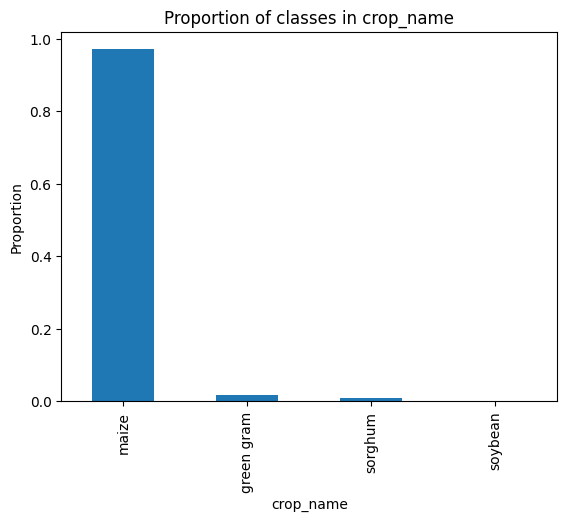


=== Class Proportions for 'growth_stage' ===
growth_stage
V    0.399731
F    0.281729
M    0.268452
S    0.050088
Name: proportion, dtype: float64


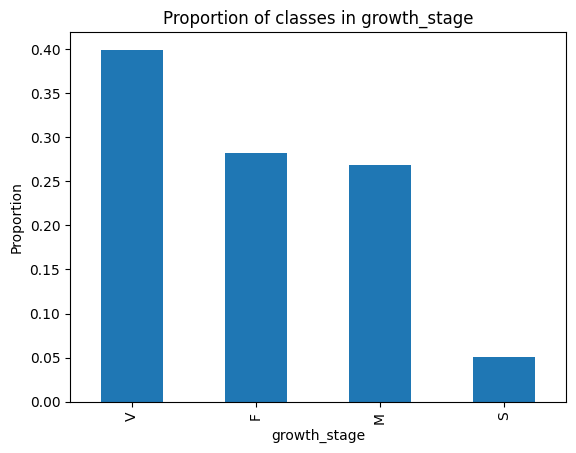


=== Class Proportions for 'damage' ===
damage
G     0.417464
WD    0.368257
DR    0.183316
ND    0.015180
PS    0.008634
DS    0.006220
WN    0.000789
FD    0.000139
Name: proportion, dtype: float64


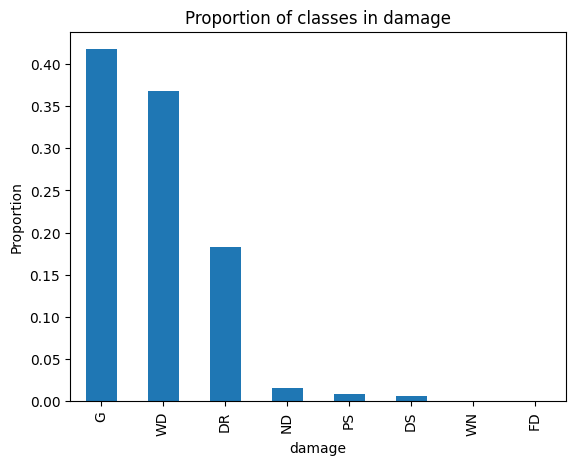


=== Class Proportions for 'extent' ===
extent
0.0      0.417046
10.0     0.207734
20.0     0.126172
30.0     0.086157
40.0     0.063318
50.0     0.031473
60.0     0.022793
80.0     0.016665
90.0     0.016572
70.0     0.011884
100.0    0.000186
Name: proportion, dtype: float64


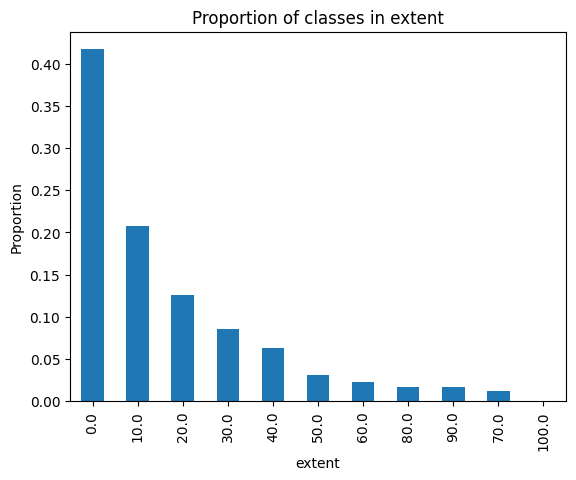

In [31]:
# Lets check the distribution of targets in relative units
for col in ['crop_name', 'growth_stage', 'damage', 'extent']:
    distribution = labels_df[col].value_counts(normalize=True)
    print(f"\n=== Class Proportions for '{col}' ===")
    print(distribution)
    distribution.plot(kind='bar', title=f"Proportion of classes in {col}")
    plt.ylabel("Proportion")
    plt.show()

## Label noise 

In [32]:
# Check for label noise (e.g., conflicting targets for the same filename)
# Count unique label sets per filename
# Group by filename and count unique combinations of targets
conflicting_labels = (
    labels_df
    .groupby('filename')[['crop_name', 'growth_stage', 'damage', 'extent']]
    .nunique()
)

# Filter to rows where any column has more than 1 unique value
conflicting_filenames = conflicting_labels[(conflicting_labels > 1).any(axis=1)]

print(f"Number of potentially conflicting filenames: {len(conflicting_filenames)}")
display(conflicting_filenames.head())

Number of potentially conflicting filenames: 0


,crop_name,growth_stage,damage,extent
filename,,,,


There are no conflicts in labeling.   
     
All labes, especislly, crop_name, are unbalanced. So, we need to try:     
1. Data-Level Techniques (Preprocessing):
   - Oversampling
2. Model-Level Techniques (During Training):
   - Class Weights in Loss Function
3. Algorithmic Techniques:
   - Focal Loss
4. Evaluation Considerations:
   - Don't use accuracy alone. Use:
     - Precision/Recall
     - F1-score
     - AUC-ROC
     - Confusion matrix
5. Data Augmentation
   - Apply image transformations more heavily to underrepresented classes to generate more diverse samples:
     - Rotation, cropping, flipping, color jittering, noise, etc.

## Images existing, sizes, formats

In [33]:
# Check images existing, sizes, formats
image_folder = '/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images'

# Prepare result lists
missing_files = []
bad_format_files = []
image_info = []

# Loop through all filenames in the DataFrame
for fname in tqdm(labels_df['filename'], desc="Checking images"):
    file_path = os.path.join(image_folder, fname)
    
    if not os.path.exists(file_path):
        missing_files.append(fname)
        continue

    try:
        with Image.open(file_path) as img:
            fmt = img.format
            width, height = img.size

            if fmt != 'JPEG':
                bad_format_files.append(fname)
            
            image_info.append({
                'filename': fname,
                'format': fmt,
                'width': width,
                'height': height
            })
    except Exception as e:
        print(f"Error reading {fname}: {e}")
        missing_files.append(fname)  # Treat as missing/broken

# Create DataFrame with image metadata
image_df = pd.DataFrame(image_info)

# Summary
print(f"\nMissing images: {len(missing_files)}")
if missing_files:
    print("Example missing filenames:", missing_files[:5])

print(f"Images with wrong format (not JPEG): {len(bad_format_files)}")
if bad_format_files:
    print("Example wrong-format filenames:", bad_format_files[:5])

print("\nImage size summary:")
print(image_df[['width', 'height']].describe())

# Identify unusual sizes
common_size = image_df[['width', 'height']].mode().iloc[0]
unusual_sizes = image_df[(image_df['width'] != common_size['width']) | (image_df['height'] != common_size['height'])]
print(f"\nImages with unusual sizes: {len(unusual_sizes)}")
if not unusual_sizes.empty:
    print(unusual_sizes.head())

Checking images: 100%|██████████| 21542/21542 [01:58<00:00, 181.42it/s]



Missing images: 0
Images with wrong format (not JPEG): 0

Image size summary:
              width        height
count  21542.000000  21542.000000
mean     699.106861    512.784700
std      469.242818    284.082647
min      240.000000    144.000000
25%      640.000000    480.000000
50%      640.000000    480.000000
75%      640.000000    480.000000
max     4160.000000   4160.000000

Images with unusual sizes: 1395
                           filename format  width  height
4   L1094F01464C01S07531Rp31236.jpg   JPEG    320     240
8    L322F00149C01S07932Rp30117.jpg   JPEG    240     320
26   L371F03158C01S09638Rp28331.jpg   JPEG    320     240
32  L1095F00012C01S07794Rp32208.jpg   JPEG    320     240
39   L221F02754C01S08488Rp28947.jpg   JPEG   3952    1872


- Most common size: 640 × 480 — very standard 4:3 image    
- Min size: 240 × 144 — small, potentially lossy (16:9 aspect)   
- Max size: 4160 × 4160 — huge, square (probably from high-res sources)    
        
Unusual images: ~6.5% of total (1395 out of 21577). It seems to be too huge to drop them.    
So, lets try to determine some tresholds in sizes and proportions. 

<Axes: >

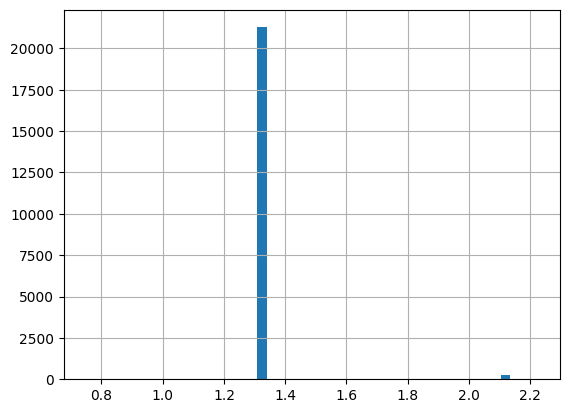

In [34]:
# Check aspect ratio
image_df['aspect_ratio'] = image_df['width'] / image_df['height']
image_df['aspect_ratio'].hist(bins=50)

In [35]:
# Use these tresholds, because aspect ratio grater than 2 seems to be atypical
MIN_WIDTH = 300
MIN_HEIGHT = 200
MAX_DIM = 2048
MAX_ASPECT = 2.0  # wider than 2:1 or taller than 1:2 is suspect

# Filter out extreme cases
extreme_images = image_df[
    (image_df['width'] < MIN_WIDTH) |
    (image_df['height'] < MIN_HEIGHT) |
    (image_df['width'] > MAX_DIM) |
    (image_df['height'] > MAX_DIM) |
    (image_df['aspect_ratio'] > MAX_ASPECT) |
    (image_df['aspect_ratio'] < 1 / MAX_ASPECT)
]

print(f"Images considered extreme: {len(extreme_images)}")

Images considered extreme: 541


We found 541 images with sizes out of the thresholds, that’s only ~2.5% of the data, so dropping them is more likely safe.

In [36]:
extreme_filenames = set(extreme_images['filename'])

# Drop from labels_df all 546 images which sizes are lager than tresholds
labels_df_cleaned = labels_df[~labels_df['filename'].isin(extreme_filenames)].reset_index(drop=True)

print(f"Original size: {len(labels_df)}, After dropping: {len(labels_df_cleaned)}")

Original size: 21542, After dropping: 21001


In [37]:
image_df_cleaned = image_df[~image_df['filename'].isin(extreme_filenames)].reset_index(drop=True)

print("\nImage size summary:")
print(image_df_cleaned[['width', 'height']].describe())

# Identify unusual sizes
common_size = image_df_cleaned[['width', 'height']].mode().iloc[0]
unusual_sizes = image_df_cleaned[
    (image_df_cleaned['width'] != common_size['width']) | (image_df_cleaned['height'] != common_size['height'])
]
print(f"\nImages with unusual sizes: {len(unusual_sizes)}")
if not unusual_sizes.empty:
    print(unusual_sizes.head())


Image size summary:
              width        height
count  21001.000000  21001.000000
mean     626.987286    470.240465
std       63.205442     47.404081
min      320.000000    240.000000
25%      640.000000    480.000000
50%      640.000000    480.000000
75%      640.000000    480.000000
max      640.000000    480.000000

Images with unusual sizes: 854
                           filename format  width  height  aspect_ratio
4   L1094F01464C01S07531Rp31236.jpg   JPEG    320     240      1.333333
25   L371F03158C01S09638Rp28331.jpg   JPEG    320     240      1.333333
31  L1095F00012C01S07794Rp32208.jpg   JPEG    320     240      1.333333
55  L1094F00039C01S07300Rp30215.jpg   JPEG    320     240      1.333333
59   L121F00601C01S08523Rp32104.jpg   JPEG    320     240      1.333333


<Axes: >

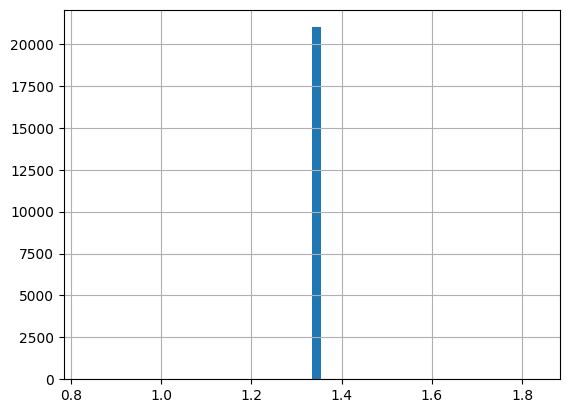

In [38]:
# Check aspect ratio
image_df_cleaned['aspect_ratio'] = image_df_cleaned['width'] / image_df_cleaned['height']
image_df_cleaned['aspect_ratio'].hist(bins=50)

So, now we have only one aspect ratio and 
- Most common size: 640 × 480
- Min size: 320 × 240 — same aspect ratio as most common
- Max size: 640 × 480 - same size as most common
It's good result, let's stop with dimensions checking here.
     
Let's check number of unique label and classes distribution again, to understand, if we safe all classes during cleaning data.

In [39]:
# Check Label Cardinality again
for col in ['crop_name', 'growth_stage', 'damage', 'extent']:
    print(f"{col}: {labels_df_cleaned[col].nunique()} unique classes")

crop_name: 4 unique classes
growth_stage: 4 unique classes
damage: 8 unique classes
extent: 11 unique classes



=== Class Proportions for 'crop_name' ===
crop_name
maize         0.970525
green gram    0.019380
sorghum       0.009571
soybean       0.000524
Name: proportion, dtype: float64


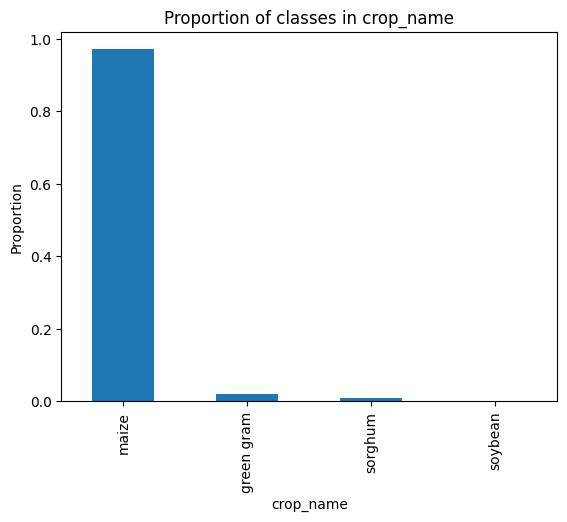


=== Class Proportions for 'growth_stage' ===
growth_stage
V    0.408362
F    0.283558
M    0.257083
S    0.050998
Name: proportion, dtype: float64


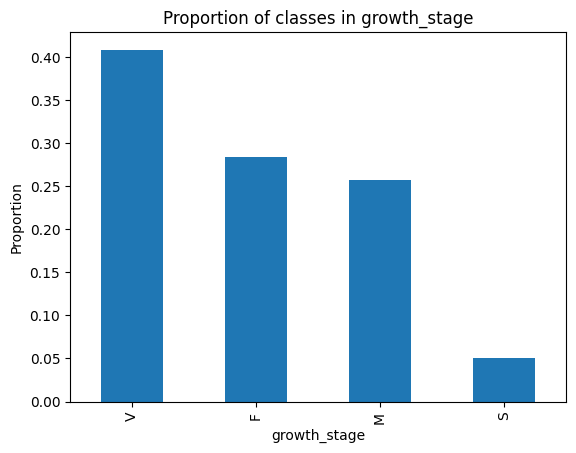


=== Class Proportions for 'damage' ===
damage
G     0.421218
WD    0.375125
DR    0.172087
ND    0.015523
PS    0.008809
DS    0.006285
WN    0.000809
FD    0.000143
Name: proportion, dtype: float64


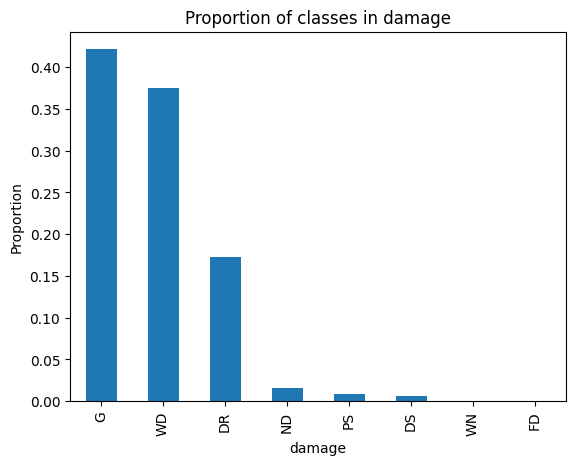


=== Class Proportions for 'extent' ===
extent
0.0      0.420980
10.0     0.211180
20.0     0.126613
30.0     0.084520
40.0     0.060473
50.0     0.029189
60.0     0.021523
80.0     0.016904
90.0     0.016856
70.0     0.011666
100.0    0.000095
Name: proportion, dtype: float64


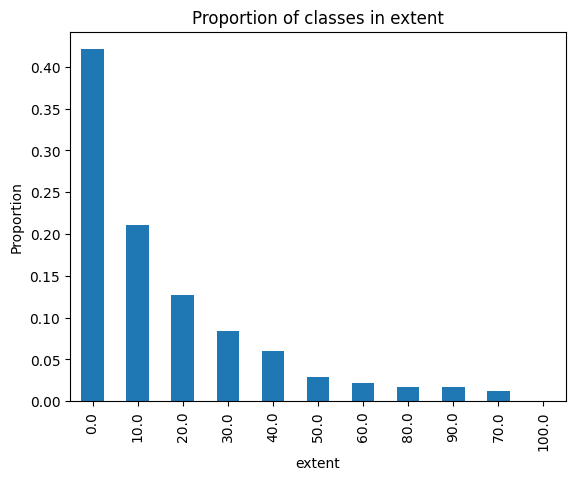

In [40]:
# Check for class imbalance again
for col in ['crop_name', 'growth_stage', 'damage', 'extent']:
    distribution = labels_df_cleaned[col].value_counts(normalize=True)
    print(f"\n=== Class Proportions for '{col}' ===")
    print(distribution)
    distribution.plot(kind='bar', title=f"Proportion of classes in {col}")
    plt.ylabel("Proportion")
    plt.show()

So, all clasess still the same, still unbalanced.
    
Now, let's check brightness and contrast of the images.

## Images brightness and contrast

In [41]:
# Compute brightness and contrast
# Path to images and labels
image_dir = '/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images'
image_filenames = labels_df_cleaned['filename']

# Store brightness and contrast
results = []

for fname in tqdm(image_filenames, desc="Analyzing brightness & contrast"):
    try:
        path = os.path.join(image_dir, fname)
        with Image.open(path).convert('L') as img_gray:  # Convert to grayscale
            stat = ImageStat.Stat(img_gray)
            brightness = stat.mean[0]
            contrast = stat.stddev[0]

            results.append({'filename': fname,
                            'brightness': brightness,
                            'contrast': contrast})
    except Exception as e:
        print(f"Error with image {fname}: {e}")

# Create DataFrame
brightness_df = pd.DataFrame(results)

# Summary statistics
print("\nBrightness summary:")
print(brightness_df['brightness'].describe())

print("\nContrast summary:")
print(brightness_df['contrast'].describe())

Analyzing brightness & contrast: 100%|██████████| 21001/21001 [01:03<00:00, 332.90it/s]


Brightness summary:
count    21001.000000
mean       111.690932
std         13.349741
min         48.693411
25%        103.353050
50%        111.821276
75%        120.300202
max        190.353467
Name: brightness, dtype: float64

Contrast summary:
count    21001.000000
mean        66.196565
std         12.861840
min         13.869232
25%         57.672544
50%         66.027054
75%         74.908984
max        109.617564
Name: contrast, dtype: float64


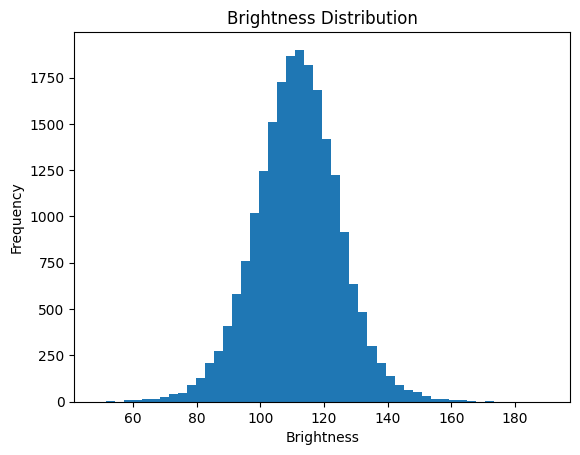

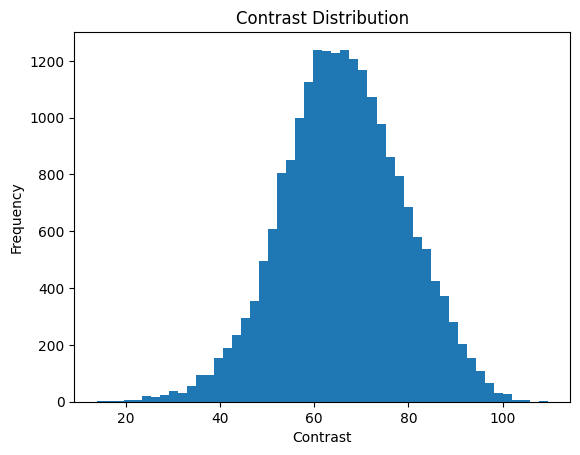

In [42]:
# Let's visualize the distribution of brightness and contrast
plt.hist(brightness_df['brightness'], bins=50)
plt.title("Brightness Distribution")
plt.xlabel("Brightness")
plt.ylabel("Frequency")
plt.show()

plt.hist(brightness_df['contrast'], bins=50)
plt.title("Contrast Distribution")
plt.xlabel("Contrast")
plt.ylabel("Frequency")
plt.show()

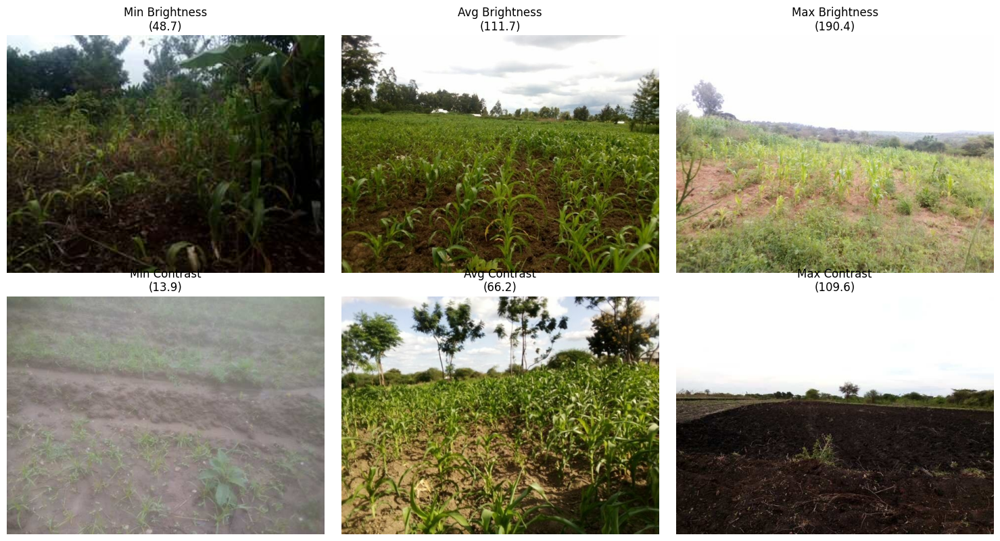

In [43]:
# Now let's look at images with Max, Min, Avg brightness and contrast
def load_image(fname):
    return Image.open(os.path.join(image_dir, fname)).convert("RGB")

# Image folder path
image_dir = '/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images'

# Find brightness extremes
min_bright = brightness_df.loc[brightness_df['brightness'].idxmin()]
max_bright = brightness_df.loc[brightness_df['brightness'].idxmax()]
mean_bright_val = brightness_df['brightness'].mean()
avg_bright = brightness_df.iloc[(brightness_df['brightness'] - mean_bright_val).abs().idxmin()]

# Find contrast extremes
min_contrast = brightness_df.loc[brightness_df['contrast'].idxmin()]
max_contrast = brightness_df.loc[brightness_df['contrast'].idxmax()]
mean_contrast_val = brightness_df['contrast'].mean()
avg_contrast = brightness_df.iloc[(brightness_df['contrast'] - mean_contrast_val).abs().idxmin()]

# Plot images
fig, axs = plt.subplots(2, 3, figsize=(15, 8))

# Brightness images
for ax, item, title in zip(axs[0], 
                           [min_bright, avg_bright, max_bright],
                           ['Min Brightness', 'Avg Brightness', 'Max Brightness']):
    img = load_image(item['filename'])
    ax.imshow(img)
    ax.set_title(f"{title}\n({item['brightness']:.1f})")
    ax.axis('off')

# Contrast images
for ax, item, title in zip(axs[1], 
                           [min_contrast, avg_contrast, max_contrast],
                           ['Min Contrast', 'Avg Contrast', 'Max Contrast']):
    img = load_image(item['filename'])
    ax.imshow(img)
    ax.set_title(f"{title}\n({item['contrast']:.1f})")
    ax.axis('off')

plt.tight_layout()
plt.show()

Looks like brightness and contrast have normal distribution, small variativity (because stds are small), images with min and max brightness and contrast seems to be recognizable, so, we don't need to clear data from  them.

## Vizual check random images with different labels


Showing one example for each value of 'crop_name'


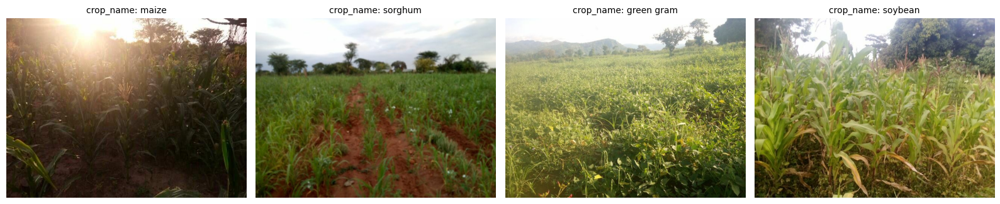


Showing one example for each value of 'growth_stage'


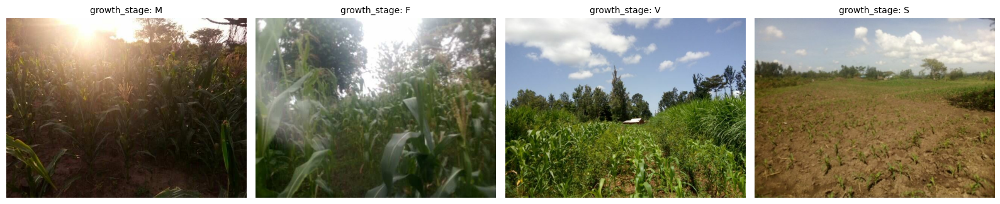


Showing one example for each value of 'damage'


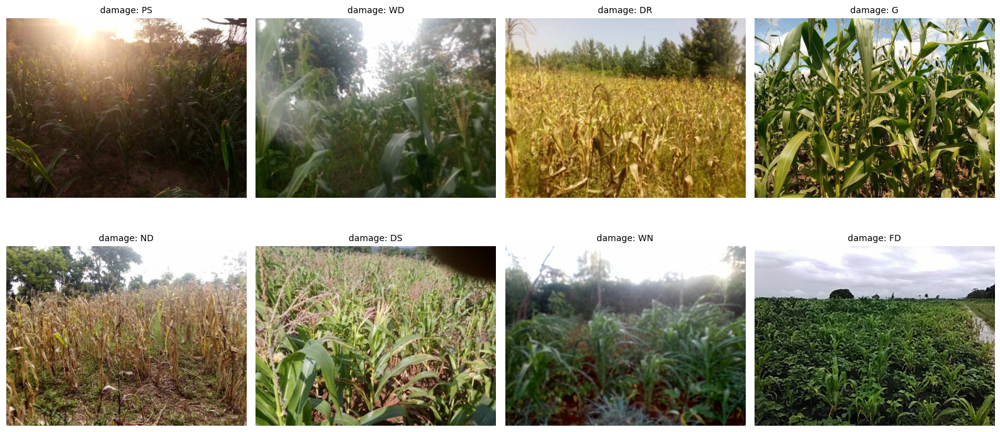

In [44]:
# Now let's check random images with different labels
# Helper function to load and display images for a given column
def show_one_example_per_label(df, column, image_dir, max_per_row=4):
    labels = df[column].unique()
    n = len(labels)
    rows = (n + max_per_row - 1) // max_per_row

    fig, axs = plt.subplots(rows, max_per_row, figsize=(max_per_row * 4, rows * 4))
    axs = axs.flatten()

    for i, label in enumerate(labels):
        example_row = df[df[column] == label].iloc[0]
        image = Image.open(os.path.join(image_dir, example_row['filename'])).convert("RGB")
        axs[i].imshow(image)
        axs[i].set_title(f"{column}: {label}", fontsize=10)
        axs[i].axis('off')

    # Hide unused subplots
    for j in range(i + 1, len(axs)):
        axs[j].axis('off')

    plt.tight_layout()
    plt.show()

# Set path and DataFrame
image_dir = '/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images'
df = labels_df_cleaned

# Show one image per unique label value
for col in ['crop_name', 'growth_stage', 'damage']:
    print(f"\nShowing one example for each value of '{col}'")
    show_one_example_per_label(df, col, image_dir)

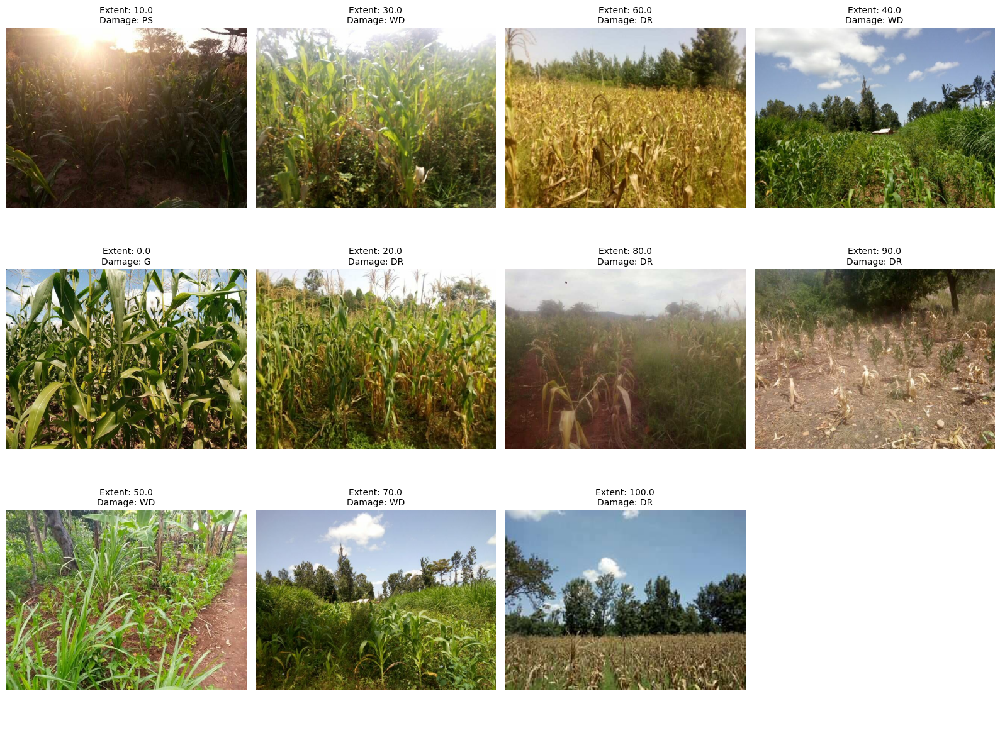

In [45]:
# Now let's look at damages & its extents
def show_extent_with_damage(df, image_dir, max_per_row=4):
    labels = df['extent'].unique()
    n = len(labels)
    rows = (n + max_per_row - 1) // max_per_row

    fig, axs = plt.subplots(rows, max_per_row, figsize=(max_per_row * 4, rows * 4))
    axs = axs.flatten()

    for i, extent_val in enumerate(labels):
        example_row = df[df['extent'] == extent_val].iloc[0]
        image = Image.open(os.path.join(image_dir, example_row['filename'])).convert("RGB")
        damage_val = example_row['damage']
        axs[i].imshow(image)
        axs[i].set_title(f"Extent: {extent_val}\nDamage: {damage_val}", fontsize=10)
        axs[i].axis('off')

    for j in range(i + 1, len(axs)):
        axs[j].axis('off')

    plt.tight_layout()
    plt.show()

show_extent_with_damage(df, image_dir)

## Check if there any B&W images, blank images, check color channel balance, check for duplicates using perceptual hashing

In [46]:
# Check if there any B&W images, empty/near-empty (blank) images, check color channel balance,
# Check for duplicates using perceptual hashing
image_folder = '/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images'
filenames = labels_df_cleaned['filename']

bw_images = []
empty_images = []
unbalanced_images = []
hash_dict = {}

# Thresholds
STD_THRESHOLD = 5
COLOR_DOMINANCE_THRESHOLD = 80  # for unbalanced RGB
BW_DOMINANCE_RATIO = 0.95       # e.g., one channel is >95% of total intensity

for fname in tqdm(filenames, desc="Auditing images"):
    path = os.path.join(image_folder, fname)
    try:
        img = Image.open(path).convert("RGB")
        img_np = np.array(img)  # shape: (H, W, 3)

        # === 1. Check for empty image (low std across whole image)
        if img_np.std() < STD_THRESHOLD:
            empty_images.append(fname)

        # === 2. Check for black-and-white (one dominant channel)
        channel_sums = img_np.sum(axis=(0, 1))  # total R, G, B
        total_sum = channel_sums.sum()
        dominant_ratio = channel_sums.max() / total_sum if total_sum > 0 else 0

        # e.g., if red channel is 97% of total and green/blue are negligible
        if dominant_ratio > BW_DOMINANCE_RATIO:
            bw_images.append(fname)

        # === 3. Check for unbalanced color (channels differ strongly)
        channel_means = img_np.mean(axis=(0, 1))
        max_diff = np.abs(channel_means.max() - channel_means.min())
        if max_diff > COLOR_DOMINANCE_THRESHOLD:
            unbalanced_images.append(fname)

        # === 4. Perceptual hash (for duplicate detection)
        hash_val = str(imagehash.phash(img))
        hash_dict.setdefault(hash_val, []).append(fname)

    except Exception as e:
        print(f"Error processing {fname}: {e}")

Auditing images: 100%|██████████| 21001/21001 [07:51<00:00, 44.57it/s]


In [47]:
# Analyze and display results
# 1. BW Images
print(f"Black-and-white images (dominant one channel): {len(bw_images)}")

# 2. Empty Images
print(f"Empty images (very low std): {len(empty_images)}")

# 3. Unbalanced color
print(f"Color-unbalanced images: {len(unbalanced_images)}")

# 4. Duplicates
duplicates = {k: v for k, v in hash_dict.items() if len(v) > 1}
print(f"Perceptual duplicate groups found: {len(duplicates)}")
for k, v in list(duplicates.items())[:5]:
    print(f"Hash {k}: {v}")

Black-and-white images (dominant one channel): 0
Empty images (very low std): 0
Color-unbalanced images: 228
Perceptual duplicate groups found: 1
Hash 808381a4b73f7d79: ['L231F03543C03S08756Rp24776.jpg', 'L231F03543C03S08756Rp24823.jpg']


Let's look at duplicated images

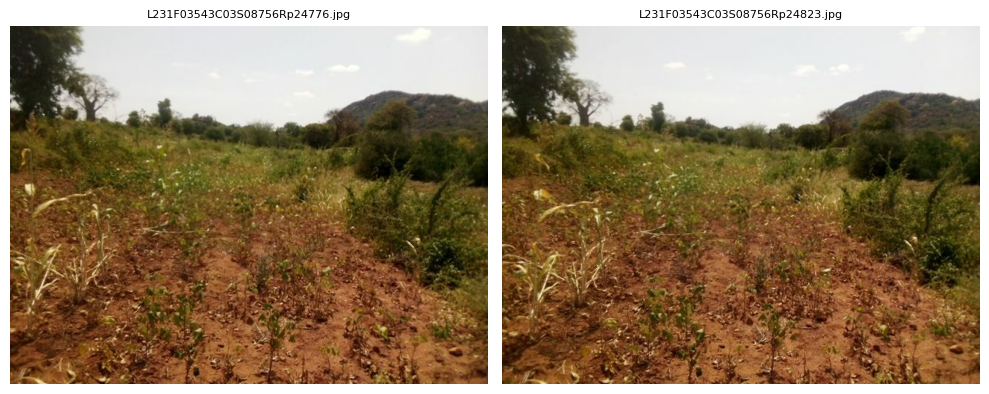

In [48]:
# List of duplicate filenames
for dup_list in duplicates.values():
    dups = dup_list
    
    plt.figure(figsize=(10, 5))
    for i, fname in enumerate(dups):
        img = Image.open(os.path.join(image_folder, fname)).convert("RGB")
        plt.subplot(1, 2, i + 1)
        plt.imshow(img)
        plt.title(fname, fontsize=8)
        plt.axis('off')
    plt.tight_layout()
    plt.show()

Yes, seems like it totally same.   
Also, let's look at color-unbalanced images

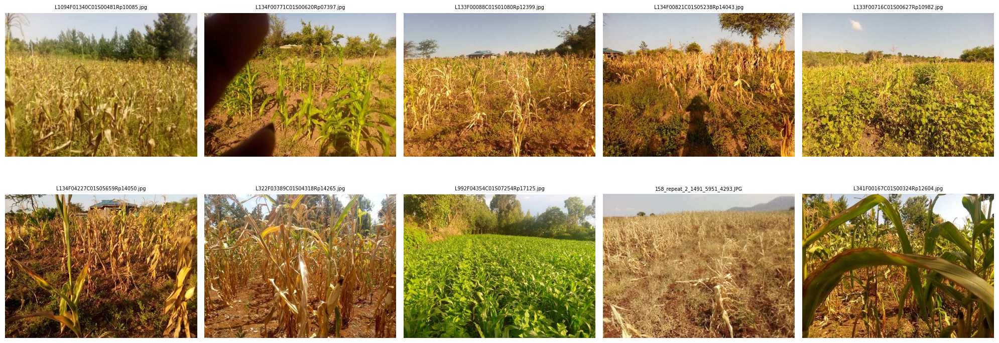

In [49]:
# Just show the first 10 unbalanced images
sample_unbalanced = unbalanced_images[:10]

plt.figure(figsize=(20, 8))
for i, fname in enumerate(sample_unbalanced):
    img = Image.open(os.path.join(image_folder, fname)).convert("RGB")
    plt.subplot(2, 5, i + 1)
    plt.imshow(img)
    plt.title(fname, fontsize=7)
    plt.axis('off')
plt.tight_layout()
plt.show()

These images looks normal. Let's left them in the dataset.

So, let's delete one row for duplicated images, but firstly check are the labes same for these two rows.

In [50]:
for dup_list in duplicates.values():
    base_fname = dup_list[0]
    base_row = df[df['filename'] == base_fname]

    for other_fname in dup_list[1:]:
        other_row = df[df['filename'] == other_fname]

        # Check if labels match
        if not base_row.empty and not other_row.empty:
            if base_row[['crop_name', 'growth_stage', 'damage', 'extent']].values[0].tolist() == \
               other_row[['crop_name', 'growth_stage', 'damage', 'extent']].values[0].tolist():
                rows_to_drop.append(other_fname)  # safe to drop duplicate label
            else:
                print(base_row)
                print(other_row)

                             filename   crop_name growth_stage damage  extent
11848  L231F03543C03S08756Rp24776.jpg  green gram            V     DR    30.0
                             filename   crop_name growth_stage damage  extent
19760  L231F03543C03S08756Rp24823.jpg  green gram            V     DR    40.0


The difference is in 'extent' label. We can't use the average, because step of extent is 10. Based on previously viewed images let's assume that here extent of the drought is 40 and drop row with extent 30.

In [51]:
# Drop row with filename== 'L231F03543C03S08756Rp24776.jpg' from DataFrame
rows_to_drop = ['L231F03543C03S08756Rp24776.jpg']
labels_df_cleaned = labels_df_cleaned[~labels_df_cleaned['filename'].isin(rows_to_drop)].reset_index(drop=True)

print(f"Size afted droping 1 duplicated row: {labels_df_cleaned.shape}")

Size afted droping 1 duplicated row: (21000, 5)


We get nice round number and perform all reasonable data checking.   
Let's perform spliting dataset into train, valid and test.

## Train, valid, test splits

In [52]:
# 1. Composite label for stratification
labels_df_cleaned['stratify_label'] = (
    labels_df_cleaned['crop_name'].astype(str) + '_' +
    labels_df_cleaned['growth_stage'].astype(str) + '_' +
    labels_df_cleaned['damage'].astype(str)
)

# 2. Separate out rare classes (occurring < 2 times)
label_counts = labels_df_cleaned['stratify_label'].value_counts()
rare_labels = label_counts[label_counts < 2].index

rare_samples = labels_df_cleaned[labels_df_cleaned['stratify_label'].isin(rare_labels)]
stratifiable_df = labels_df_cleaned[~labels_df_cleaned['stratify_label'].isin(rare_labels)]

# 3. Stratified split on stratifiable data
train_val_df, test_df = train_test_split(
    stratifiable_df,
    test_size=0.15,
    stratify=stratifiable_df['stratify_label'],
    random_state=42
)

train_df, val_df = train_test_split(
    train_val_df,
    test_size=0.15 / 0.85,  # ~17.6% of train_val
    stratify=train_val_df['stratify_label'],
    random_state=42
)

# 4. Add rare samples to training set
train_df = pd.concat([train_df, rare_samples], ignore_index=True)

# 5. Clean up
for d in [train_df, val_df, test_df]:
    d.drop(columns=['stratify_label'], inplace=True)

print(f"Train size: {len(train_df)}")
print(f"Val size: {len(val_df)}")
print(f"Test size: {len(test_df)}")

# 6. Inspect distribution
def inspect_splits(*splits, target='crop_name'):
    for i, split in enumerate(splits):
        print(f"Split {i}:")
        print(split[target].value_counts(normalize=True))
        print()

inspect_splits(train_df, val_df, test_df, target='crop_name')
inspect_splits(train_df, val_df, test_df, target='growth_stage')
inspect_splits(train_df, val_df, test_df, target='damage')
inspect_splits(train_df, val_df, test_df, target='extent')

Train size: 14702
Val size: 3149
Test size: 3149
Split 0:
crop_name
maize         0.970208
green gram    0.019385
sorghum       0.009795
soybean       0.000612
Name: proportion, dtype: float64

Split 1:
crop_name
maize         0.971737
green gram    0.019054
sorghum       0.008892
soybean       0.000318
Name: proportion, dtype: float64

Split 2:
crop_name
maize         0.971102
green gram    0.019371
sorghum       0.009209
soybean       0.000318
Name: proportion, dtype: float64

Split 0:
growth_stage
V    0.408380
F    0.283499
M    0.257040
S    0.051081
Name: proportion, dtype: float64

Split 1:
growth_stage
V    0.408384
F    0.283582
M    0.257225
S    0.050810
Name: proportion, dtype: float64

Split 2:
growth_stage
V    0.408066
F    0.283900
M    0.257225
S    0.050810
Name: proportion, dtype: float64

Split 0:
damage
G     0.421303
WD    0.374915
DR    0.172017
ND    0.015576
PS    0.008774
DS    0.006326
WN    0.000884
FD    0.000204
Name: proportion, dtype: float64

Split 1:
d

So, some rare clasess for damage (FD) and extent (100) we have only in train. For now, left it as it is, for baseline model. Lately, at the developing for lesson 5 - Model improvement - we perform oversampling, so that we can increase data for rare classes.

In [53]:
train_df.to_csv("/kaggle/working/train.csv", index=False)
val_df.to_csv("/kaggle/working/valid.csv", index=False)
test_df.to_csv("/kaggle/working/test.csv", index=False)
labels_df_cleaned.to_csv("/kaggle/working/crop_labels_cleaned.csv", index=False) # just in case keep whole dataset

# Dataset creation

## Class Dataset creation

In [54]:
# Dataset that returns all 4 labels as separate integers
class MultiHeadEotGDataset(Dataset):
    def __init__(self, csv_file, image_dir, transform=None):
        self.df = pd.read_csv(csv_file)
        self.image_dir = image_dir
        self.transform = transform

        self.label_cols = ['crop_name', 'growth_stage', 'damage', 'extent']

        # Create and save two mappings: str -> int и int -> str so that we can use classes names after
        self.label_maps = {}
        self.inverse_label_maps = {}

        for col in self.label_cols:
            unique_vals = sorted(self.df[col].unique())
            self.label_maps[col] = {val: i for i, val in enumerate(unique_vals)}
            self.inverse_label_maps[col] = {i: val for val, i in self.label_maps[col].items()}

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img_path = os.path.join(self.image_dir, row['filename'])
        image = Image.open(img_path).convert("RGB")

        if self.transform:
            image = self.transform(image)

        labels = {
            col: torch.tensor(self.label_maps[col][row[col]], dtype=torch.long)
            for col in self.label_cols
        }

        return image, labels

In [55]:
csv_path = "/kaggle/working/crop_labels_cleaned.csv"
image_dir = "/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images"
dataset = MultiHeadEotGDataset(csv_path, image_dir)

## Showing images

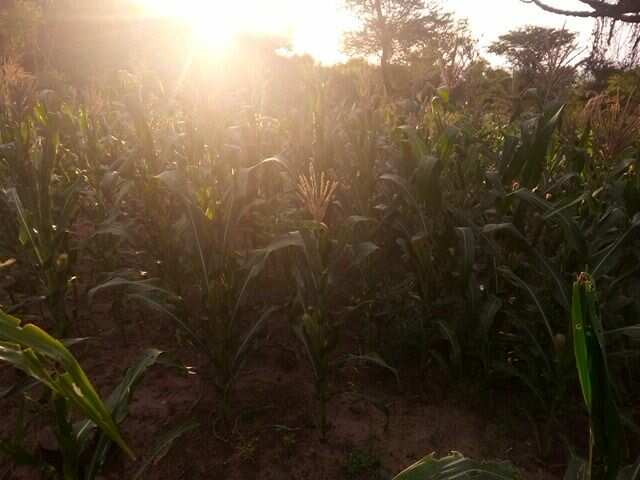

In [56]:
dataset[0][0]

In [57]:
def show_dataset_samples(dataset, num_samples=5):
    indices = random.sample(range(len(dataset)), num_samples)
    
    plt.figure(figsize=(num_samples * 3, 4))

    for i, idx in enumerate(indices):
        image, label = dataset[idx]
        
        plt.subplot(1, num_samples, i + 1)
        plt.imshow(image)
        
        # Handle label type (int or dict)
        if isinstance(label, dict):
            title = "\n".join([f"{k}: {v.item()}" for k, v in label.items()])
        else:
            title = f"Label: {label.item()}"
        
        plt.title(title, fontsize=9)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

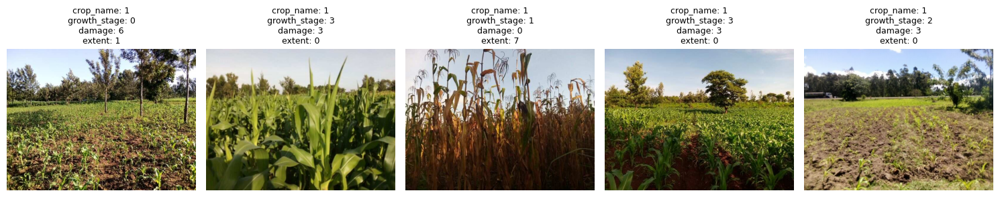

In [58]:
show_dataset_samples(dataset, num_samples=5)

## Data normalization

We are going to use normalization of the data. Normalization helps by scaling pixel values to a common range, making training more stable and faster. 

In [59]:
# Compute train mean and std for further data normalization
# Paths
csv_path = "/kaggle/working/train.csv"
image_dir = "/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images"

# Load CSV and extract filenames
df = pd.read_csv(csv_path)
image_paths = [os.path.join(image_dir, fname) for fname in df['filename']]

# Transform to tensor (resizing for consistency)
to_tensor = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

# Accumulate sums
n_images = 0
mean = torch.zeros(3)
std = torch.zeros(3)

for img_path in tqdm(image_paths, desc="Processing images"):
    img = Image.open(img_path).convert("RGB")
    tensor = to_tensor(img)

    mean += tensor.mean(dim=(1, 2))
    std += tensor.std(dim=(1, 2))
    n_images += 1

mean /= n_images
std /= n_images

print(f"Mean: {mean}")
print(f"Std: {std}")

Processing images: 100%|██████████| 14702/14702 [01:34<00:00, 155.15it/s]

Mean: tensor([0.4542, 0.4514, 0.3261])
Std: tensor([0.2454, 0.2507, 0.2885])


## Train, valid, test creation

As a baseline we are going to use one transform for train, valid, test, without augmentations. 
Also, we will not use weights for classes at this baseline step.   

In [60]:
# Build train, valid, test from dataset
def get_eotg_datasets(
    image_dir,
    train_csv="/kaggle/working/train.csv",
    valid_csv="/kaggle/working/valid.csv",
    test_csv="/kaggle/working/test.csv",
    image_size=(256, 256),
    mean=(0.4542, 0.4514, 0.3261),
    std=(0.2454, 0.2507, 0.2885)
):
    # Define shared image transform
    transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

    # Create datasets
    train_ds = MultiHeadEotGDataset(train_csv, image_dir, transform=transform)
    valid_ds = MultiHeadEotGDataset(valid_csv, image_dir, transform=transform)
    test_ds = MultiHeadEotGDataset(test_csv, image_dir, transform=transform)

    return train_ds, valid_ds, test_ds

In [61]:
image_dir = "/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images"

train_ds, valid_ds, test_ds = get_eotg_datasets(image_dir)

In [62]:
# Function for checking samples after transformation
def show_dataset_samples_after_transform(dataset, num_samples=5):
    indices = random.sample(range(len(dataset)), num_samples)
    
    plt.figure(figsize=(num_samples * 3, 4))

    for i, idx in enumerate(indices):
        image, label = dataset[idx]
        
        # Convert tensor to PIL for display
        image = F.to_pil_image(image)

        plt.subplot(1, num_samples, i + 1)
        plt.imshow(image)
        
        # Handle label type (int or dict)
        if isinstance(label, dict):
            title = "\n".join([f"{k}: {v.item()}" for k, v in label.items()])
        else:
            title = f"Label: {label.item()}"
        
        plt.title(title, fontsize=9)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

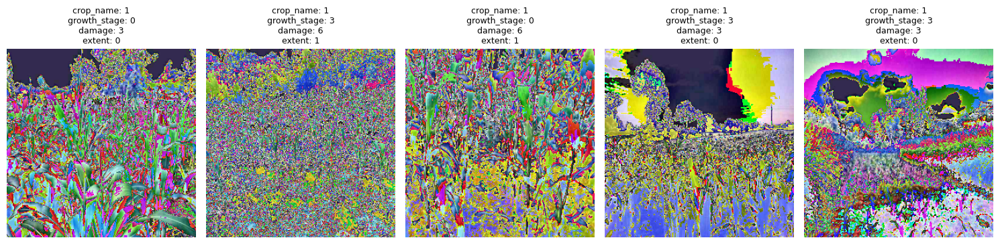

In [63]:
show_dataset_samples_after_transform(train_ds, num_samples=5)

Looks like transformation works. Now, create dataloaders.

In [64]:
print("Train:", train_ds.label_maps['damage'])
print("Valid:", valid_ds.label_maps['damage'])

Train: {'DR': 0, 'DS': 1, 'FD': 2, 'G': 3, 'ND': 4, 'PS': 5, 'WD': 6, 'WN': 7}
Valid: {'DR': 0, 'DS': 1, 'G': 2, 'ND': 3, 'PS': 4, 'WD': 5, 'WN': 6}


In [65]:
# Create dataloaders
train_loader = DataLoader(train_ds, batch_size=32, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_ds, batch_size=32, shuffle=False, num_workers=2)
test_loader  = DataLoader(test_ds, batch_size=32, shuffle=False, num_workers=2)

# Model creation, training and testing

## Baseline models

Take a ResNet18 and EfficientNet-B0 as a baseline, because they are good models for image classification.    
We are going to predict all four classes simultaneously, so we are going to create multihead classifier.   
Сhose macro F1-score as the main metric, since the classes are unbalanced and all types of errors are potentially dangerous.

In [66]:
# Model based on ResNet18
class MultiHeadClassifierRN18(nn.Module):
    def __init__(self, num_classes_dict):
        super().__init__()
        base_model = resnet18(weights=ResNet18_Weights.IMAGENET1K_V1) # pre-trained model weights on the ImageNet-1K dataset
        self.backbone = nn.Sequential(*list(base_model.children())[:-1])  # remove FC

        self.flatten = nn.Flatten()

        self.heads = nn.ModuleDict({
            name: nn.Linear(base_model.fc.in_features, num_classes)
            for name, num_classes in num_classes_dict.items()
        })

    def forward(self, x):
        x = self.backbone(x)
        x = self.flatten(x)

        outputs = {name: head(x) for name, head in self.heads.items()}
        return outputs  # returns dict: {crop_name: logits, growth_stage: logits, ...}

In [67]:
# Model based on EfficientNet-B0
class MultiHeadClassifierEffB0(nn.Module):
    def __init__(self, num_classes_dict):
        super().__init__()
        base_model = efficientnet_b0(weights=EfficientNet_B0_Weights.IMAGENET1K_V1)

        # Delete classification head and replace it with our heads
        self.backbone = base_model.features
        self.pool = base_model.avgpool  # AdaptiveAvgPool2d(output_size=1)
        self.flatten = nn.Flatten()

        in_features = base_model.classifier[1].in_features  # usually 1280

        self.heads = nn.ModuleDict({
            name: nn.Linear(in_features, num_classes)
            for name, num_classes in num_classes_dict.items()
        })

    def forward(self, x):
        x = self.backbone(x)
        x = self.pool(x)
        x = self.flatten(x)

        outputs = {name: head(x) for name, head in self.heads.items()}
        return outputs  # dict: {crop_name: logits, ...}

In [68]:
num_classes = {col: len(map_) for col, map_ in train_ds.label_maps.items()}
num_classes

{'crop_name': 4, 'growth_stage': 4, 'damage': 8, 'extent': 11}

## Baseline train and evaluation functions

In [69]:
def train_one_epoch(model, dataloader, optimizer, criterion, device):
    model.train()
    running_loss = 0.0
    all_preds = defaultdict(list)
    all_labels = defaultdict(list)

    for inputs, labels in tqdm(dataloader, desc='Train'):
        inputs = inputs.to(device)
        labels = {k: v.to(device) for k, v in labels.items()}

        outputs = model(inputs)
        loss = sum(criterion(outputs[k], labels[k]) for k in outputs)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        for key in outputs:
            preds = torch.argmax(outputs[key], dim=1)
            all_preds[key].extend(preds.cpu().numpy())
            all_labels[key].extend(labels[key].cpu().numpy())

    avg_loss = running_loss / len(dataloader)
    avg_acc = np.mean([accuracy_score(all_labels[k], all_preds[k]) for k in all_preds])
    avg_f1 = np.mean([f1_score(all_labels[k], all_preds[k], average='macro', zero_division=0) for k in all_preds])

    return avg_loss, avg_acc, avg_f1

In [70]:
@torch.inference_mode()
def evaluate(model, dataloader, criterion, inverse_label_maps, device, print_reports=True):
    model.eval()
    running_loss = 0.0
    all_preds = defaultdict(list)
    all_labels = defaultdict(list)

    with torch.no_grad():
        for inputs, labels in tqdm(dataloader, desc='Valid'):
            inputs = inputs.to(device)
            labels = {k: v.to(device) for k, v in labels.items()}

            outputs = model(inputs)
            loss = sum(criterion(outputs[k], labels[k]) for k in outputs)
            running_loss += loss.item()

            for key in outputs:
                preds = torch.argmax(outputs[key], dim=1)
                all_preds[key].extend(preds.cpu().numpy())
                all_labels[key].extend(labels[key].cpu().numpy())

    avg_loss = running_loss / len(dataloader)
    avg_acc = np.mean([accuracy_score(all_labels[k], all_preds[k]) for k in all_preds])
    avg_f1 = np.mean([f1_score(all_labels[k], all_preds[k], average='macro', zero_division=0) for k in all_preds])

    if print_reports:
        for key in all_preds:
            y_true = list(map(int, all_labels[key]))
            y_pred = list(map(int, all_preds[key]))
            unique_labels = sorted(set(y_true + y_pred))
            target_names = [str(inverse_label_maps[key][i]) for i in unique_labels]

            print(f"\n[Validation Report] Task: {key}")
            print(classification_report(y_true, y_pred, target_names=target_names, zero_division=0))

    return avg_loss, avg_acc, avg_f1

In [71]:
def train_and_validate(model, inverse_label_maps, num_epochs=10, lr=1e-4, model_path='/kaggle/working/best_model.pth'):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    best_f1 = 0.0
    best_model_state = None

    history = {
        "train_loss": [], "val_loss": [],
        "train_acc": [], "val_acc": [],
        "train_f1": [], "val_f1": [],
    }

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")

        train_loss, train_acc, train_f1 = train_one_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, val_f1 = evaluate(
            model,
            valid_loader,
            criterion,
            inverse_label_maps,
            device,
            print_reports=True
        )

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_f1'].append(train_f1)
        history['val_f1'].append(val_f1)

        print(f"[Train] Loss: {train_loss:.4f} | Acc: {train_acc:.4f} | F1: {train_f1:.4f}")
        print(f"[Valid] Loss: {val_loss:.4f} | Acc: {val_acc:.4f} | F1: {val_f1:.4f}")

        # Save best model
        if val_f1 > best_f1:
            best_f1 = val_f1
            best_model_state = model.state_dict()
            torch.save(best_model_state, model_path)
            print(f"✅ Saved new best model with F1 = {best_f1:.4f}")

    return history

In [72]:
def plot_history(history):
    for metric in ['loss', 'acc', 'f1']:
        plt.figure(figsize=(8, 5))
        plt.plot(history[f"train_{metric}"], label='Train')
        plt.plot(history[f"val_{metric}"], label='Validation')
        plt.title(metric.upper())
        plt.xlabel("Epoch")
        plt.ylabel(metric.upper())
        plt.legend()
        plt.grid(True)
        plt.show()

In [73]:
def test_model(model, dataloader, inverse_label_maps, device=None, print_reports=True, model_path='/kaggle/working/best_model.pth'):
    if device is None:
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    # Load best model
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.to(device)
    model.eval()

    all_preds = defaultdict(list)
    all_labels = defaultdict(list)

    with torch.no_grad():
        for inputs, labels in tqdm(dataloader, desc='Test'):
            inputs = inputs.to(device)
            labels = {k: v.to(device) for k, v in labels.items()}

            outputs = model(inputs)
            for key in outputs:
                preds = torch.argmax(outputs[key], dim=1)
                all_preds[key].extend(preds.cpu().numpy())
                all_labels[key].extend(labels[key].cpu().numpy())

    print("\n=== Test Evaluation ===")
    for key in all_preds:
        y_true = list(map(int, all_labels[key]))
        y_pred = list(map(int, all_preds[key]))
        unique_labels = sorted(set(y_true + y_pred))
        target_names = [str(inverse_label_maps[key][i]) for i in unique_labels]

        acc = accuracy_score(y_true, y_pred)
        f1 = f1_score(y_true, y_pred, average='macro', zero_division=0)

        print(f"[{key}] Accuracy: {acc:.4f}, Macro-F1: {f1:.4f}")
        if print_reports:
            print(classification_report(y_true, y_pred, target_names=target_names, zero_division=0))

## Baseline training model based on ResNet18

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 150MB/s] 



Epoch 1/10


Valid: 100%|██████████| 99/99 [00:12<00:00,  8.03it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       1.00      0.32      0.48        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.49      0.33      0.37      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.71      0.72       893
           M       0.79      0.79      0.79       810
           S       0.83      0.78      0.81       160
           V       0.87      0.90      0.88      1286

    accuracy                           0.81      3149
   macro avg       0.81      0.79      0.80      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.95it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.80      0.33      0.47        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.44      0.33      0.36      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.73      0.73       893
           M       0.79      0.76      0.77       810
           S       0.80      0.86      0.83       160
           V       0.89      0.90      0.90      1286

    accuracy                           0.81      3149
   macro avg       0.80      0.81      0.81      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.08it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.82      0.55      0.66        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.45      0.39      0.41      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.71      0.71       893
           M       0.77      0.78      0.78       810
           S       0.81      0.86      0.83       160
           V       0.90      0.89      0.89      1286

    accuracy                           0.81      3149
   macro avg       0.80      0.81      0.80      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.95it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.86      0.62      0.72        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.46      0.40      0.43      3149
weighted avg       0.97      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.68      0.75      0.71       893
           M       0.79      0.75      0.77       810
           S       0.84      0.80      0.82       160
           V       0.90      0.86      0.88      1286

    accuracy                           0.80      3149
   macro avg       0.80      0.79      0.80      3149
weighted avg       0.80      0.80      0.80      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.91it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.96      0.38      0.55        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.48      0.35      0.38      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.67      0.75      0.71       893
           M       0.80      0.70      0.75       810
           S       0.84      0.81      0.83       160
           V       0.88      0.89      0.88      1286

    accuracy                           0.80      3149
   macro avg       0.80      0.79      0.79      3149
weighted avg       0.80      0.80      0.80      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.12it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.75      0.60      0.67        60
       maize       0.98      0.99      0.99      3060
     sorghum       0.43      0.11      0.17        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.54      0.43      0.46      3149
weighted avg       0.97      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.68      0.71      0.69       893
           M       0.76      0.72      0.74       810
           S       0.80      0.83      0.82       160
           V       0.88      0.87      0.88      1286

    accuracy                           0.79      3149
   macro avg       0.78      0.78      0.78      3149
weighted avg       0.79      0.79      0.79      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.09it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.84      0.60      0.70        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.33      0.04      0.06        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.54      0.41      0.44      3149
weighted avg       0.97      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.66      0.69       893
           M       0.74      0.82      0.78       810
           S       0.80      0.82      0.81       160
           V       0.89      0.88      0.88      1286

    accuracy                           0.80      3149
   macro avg       0.79      0.79      0.79      3149
weighted avg       0.80      0.80      0.80      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.10it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.85      0.68      0.76        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.40      0.14      0.21        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.56      0.46      0.49      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.66      0.75      0.70       893
           M       0.79      0.74      0.76       810
           S       0.79      0.87      0.82       160
           V       0.89      0.83      0.86      1286

    accuracy                           0.79      3149
   macro avg       0.78      0.80      0.79      3149
weighted avg       0.79      0.79      0.79      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.24it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.75      0.67      0.71        60
       maize       0.98      0.99      0.99      3060
     sorghum       0.14      0.04      0.06        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.47      0.42      0.44      3149
weighted avg       0.97      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.60      0.82      0.69       893
           M       0.85      0.54      0.66       810
           S       0.78      0.85      0.81       160
           V       0.89      0.86      0.87      1286

    accuracy                           0.77      3149
   macro avg       0.78      0.77      0.76      3149
weighted avg       0.79      0.77      0.76      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.83it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.74      0.67      0.70        60
       maize       0.99      0.99      0.99      3060
     sorghum       0.43      0.11      0.17        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.54      0.44      0.47      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.54      0.62       893
           M       0.71      0.80      0.75       810
           S       0.76      0.84      0.80       160
           V       0.83      0.91      0.87      1286

    accuracy                           0.77      3149
   macro avg       0.76      0.77      0.76      3149
weighted avg       0.77      0.77      0.77      3149


[Validation Report] Task: damage
              preci

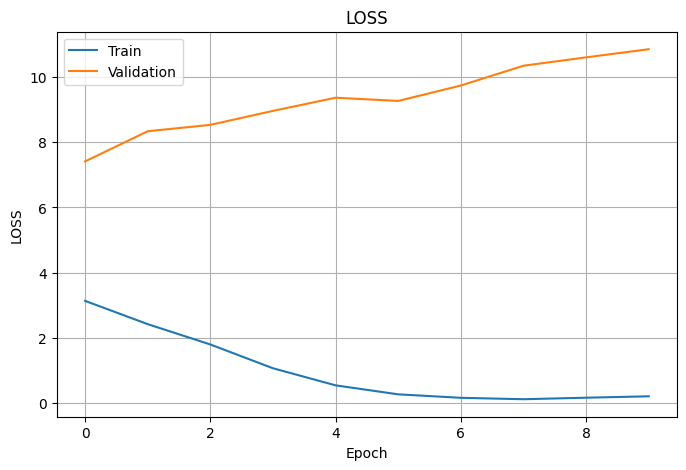

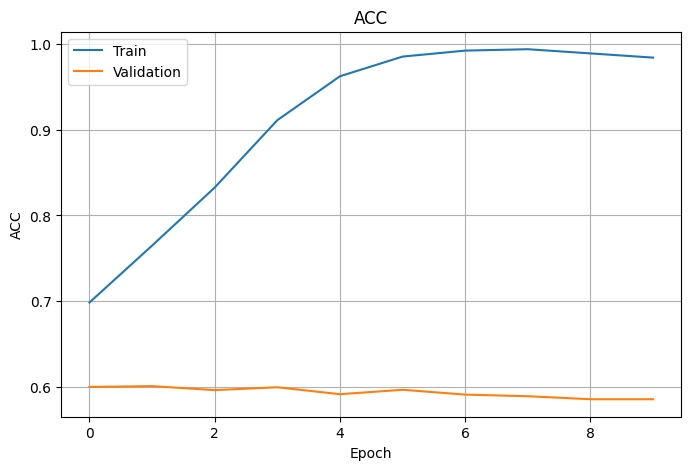

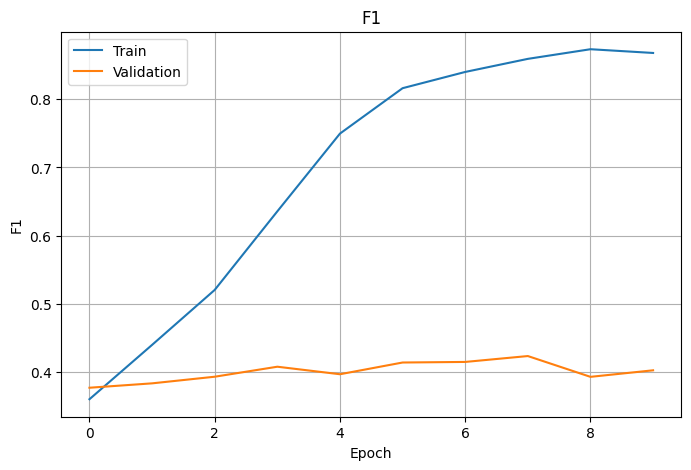

In [74]:
# Try ResNet18
model_rn = MultiHeadClassifierRN18(num_classes)
history_rn = train_and_validate(
    model_rn,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    model_path='best_model_rn.pth'
)
plot_history(history_rn)

## Baseline training model based on EfficientNet-B0

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 146MB/s]



Epoch 1/10


Valid: 100%|██████████| 99/99 [00:12<00:00,  8.09it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.80      0.20      0.32        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.97      3149
   macro avg       0.44      0.30      0.33      3149
weighted avg       0.96      0.97      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.63      0.68       893
           M       0.79      0.76      0.77       810
           S       0.78      0.89      0.83       160
           V       0.83      0.90      0.87      1286

    accuracy                           0.79      3149
   macro avg       0.78      0.80      0.79      3149
weighted avg       0.79      0.79      0.79      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.89it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.68      0.70      0.69        60
       maize       0.98      0.99      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.42      0.42      0.42      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.68      0.70       893
           M       0.78      0.80      0.79       810
           S       0.87      0.78      0.83       160
           V       0.87      0.90      0.88      1286

    accuracy                           0.81      3149
   macro avg       0.81      0.79      0.80      3149
weighted avg       0.80      0.81      0.80      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.98it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.75      0.65      0.70        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.43      0.41      0.42      3149
weighted avg       0.97      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.69      0.71       893
           M       0.76      0.82      0.79       810
           S       0.85      0.82      0.83       160
           V       0.90      0.89      0.89      1286

    accuracy                           0.81      3149
   macro avg       0.81      0.80      0.80      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.13it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.61      0.73      0.67        60
       maize       0.99      0.99      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.40      0.43      0.41      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.66      0.70       893
           M       0.78      0.81      0.79       810
           S       0.79      0.87      0.83       160
           V       0.87      0.90      0.88      1286

    accuracy                           0.81      3149
   macro avg       0.79      0.81      0.80      3149
weighted avg       0.80      0.81      0.80      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.04it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.67      0.65      0.66        60
       maize       0.98      0.99      0.99      3060
     sorghum       1.00      0.04      0.07        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.66      0.42      0.43      3149
weighted avg       0.98      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.76      0.73       893
           M       0.84      0.74      0.79       810
           S       0.75      0.86      0.80       160
           V       0.88      0.88      0.88      1286

    accuracy                           0.81      3149
   macro avg       0.79      0.81      0.80      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.88it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.70      0.62      0.65        60
       maize       0.98      0.99      0.99      3060
     sorghum       0.50      0.04      0.07        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.55      0.41      0.43      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.72      0.71       893
           M       0.80      0.76      0.78       810
           S       0.83      0.81      0.82       160
           V       0.88      0.89      0.88      1286

    accuracy                           0.81      3149
   macro avg       0.80      0.80      0.80      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.74it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.76      0.68      0.72        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.67      0.07      0.13        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.60      0.44      0.46      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.69      0.75      0.72       893
           M       0.82      0.73      0.77       810
           S       0.80      0.84      0.82       160
           V       0.88      0.88      0.88      1286

    accuracy                           0.80      3149
   macro avg       0.80      0.80      0.80      3149
weighted avg       0.81      0.80      0.80      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.96it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.77      0.62      0.69        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.60      0.11      0.18        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.59      0.43      0.46      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.69      0.72      0.71       893
           M       0.82      0.72      0.77       810
           S       0.84      0.82      0.83       160
           V       0.86      0.90      0.88      1286

    accuracy                           0.80      3149
   macro avg       0.80      0.79      0.80      3149
weighted avg       0.80      0.80      0.80      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.10it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.59      0.73      0.66        60
       maize       0.99      0.99      0.99      3060
     sorghum       0.40      0.07      0.12        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.50      0.45      0.44      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.70      0.71       893
           M       0.78      0.80      0.79       810
           S       0.82      0.83      0.82       160
           V       0.87      0.89      0.88      1286

    accuracy                           0.81      3149
   macro avg       0.80      0.80      0.80      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.91it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.73      0.60      0.66        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.50      0.11      0.18        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.55      0.43      0.46      3149
weighted avg       0.97      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.70      0.71       893
           M       0.77      0.78      0.78       810
           S       0.84      0.80      0.82       160
           V       0.88      0.89      0.88      1286

    accuracy                           0.80      3149
   macro avg       0.80      0.79      0.80      3149
weighted avg       0.80      0.80      0.80      3149


[Validation Report] Task: damage
              preci

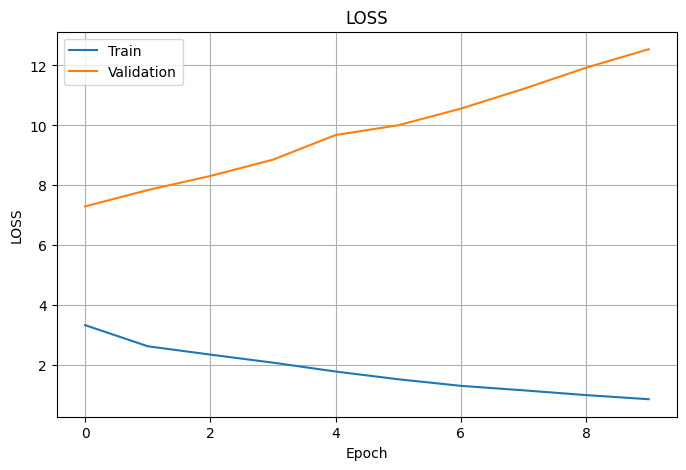

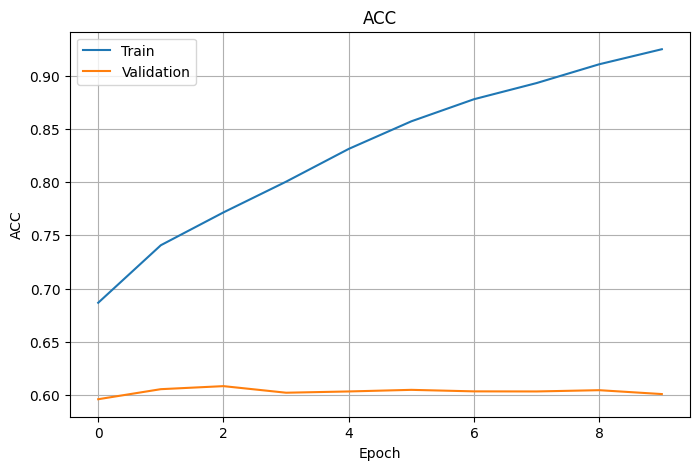

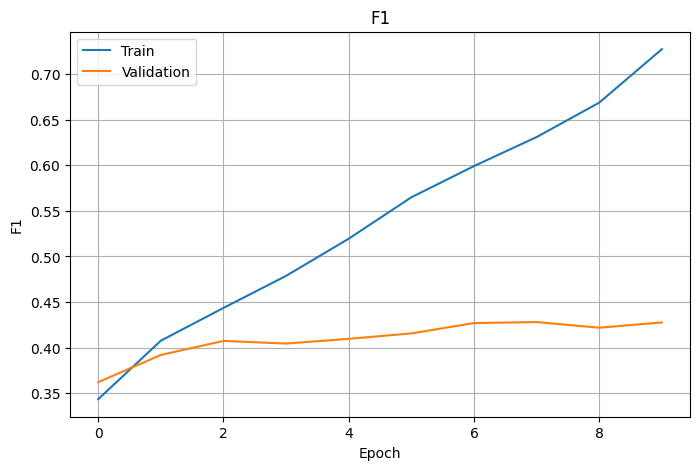

In [75]:
# Try EffB0
model_effb0 = MultiHeadClassifierEffB0(num_classes)
history_effb0 = train_and_validate(
    model_effb0,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    model_path='best_model_effb0.pth'
)
plot_history(history_effb0)

## Conclusions on first baseline trainings

So, as we can see, Train loss ↓, but Valid loss ↑ — this is classical sign of overfitting. Also, accuracy and F1 for train increase, but for valid almost not changed. That is also could be sign of overfitting.        
The reasons could be:
- Multi-task classification
- Unbalanced classes
- Most likely one or two of the outputs strongly dominate the gradient
- And the model "remembers" the training, but does not learn to generalize

Possible ways for solving this overfitting are:
- Early stopping - stop training when val_loss or val_f1 stop improving.
- Add  ReduceLROnPlateau - decrease learning rate when gradient stuck
- Weight decay (L2 regularization) - smooths out weights.
- Augmentations - the most powerful solution against overfitting for CV, improves generalization.
- Automatic adjustment of task weights - methods like uncertainty weighting, GradNorm or DWA (Dynamic Weight Averaging) really help if:
  - One task converges faster (e.g. crop_name is easy to solve)
  - One task overfits, the other does not
  - Distribute model "attention" dynamically      
  But:     
  - This is not a panacea for overfitting
  - They regulate the balance between tasks, but do not solve the problem of the generalization ability of the model
  - They should be used in addition to, not instead of, augmentations and regularization

Based on arguments above, let's start with Early stopping, Add  ReduceLROnPlateau, Weight decay (L2 regularization) and Augmentations.

##  Add Early stopping, ReduceLROnPlateau, Weight decay (L2 regularization) and Augmentations

In [76]:
# Let's re-create datasets and transforms
train_csv="/kaggle/working/train.csv"
valid_csv="/kaggle/working/valid.csv"
test_csv="/kaggle/working/test.csv"

image_dir = "/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images"

image_size=(256, 256)
mean=(0.4542, 0.4514, 0.3261)
std=(0.2454, 0.2507, 0.2885)

# Define train image transform
train_transform = transforms.Compose([
    transforms.RandomResizedCrop(image_size, scale=(0.8, 1.0)),
    transforms.RandomHorizontalFlip(p=0.5),                             
    transforms.RandomVerticalFlip(p=0.2),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.02),
    transforms.RandomRotation(degrees=15), 
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std),
])

# Define test/valid image transform
test_transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

# Create datasets
train_ds = MultiHeadEotGDataset(train_csv, image_dir, transform=train_transform)
valid_ds = MultiHeadEotGDataset(valid_csv, image_dir, transform=test_transform)
test_ds = MultiHeadEotGDataset(test_csv, image_dir, transform=test_transform)

# Create dataloaders
train_loader = DataLoader(train_ds, batch_size=32, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_ds, batch_size=32, shuffle=False, num_workers=2)
test_loader  = DataLoader(test_ds, batch_size=32, shuffle=False, num_workers=2)

In [77]:
# Re-create training and evaluation function
def train_and_validate_reg(
    model,
    inverse_label_maps,
    num_epochs=10, 
    lr=1e-4,
    weight_decay=1e-5,
    model_path='/kaggle/working/best_model.pth',
    patience=5
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
    scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)

    best_f1 = 0.0
    best_model_state = copy.deepcopy(model.state_dict())
    epochs_no_improve = 0

    history = {
        "train_loss": [], "val_loss": [],
        "train_acc": [], "val_acc": [],
        "train_f1": [], "val_f1": [],
    }

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")

        train_loss, train_acc, train_f1 = train_one_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, val_f1 = evaluate(
            model,
            valid_loader,
            criterion,
            inverse_label_maps,
            device,
            print_reports=True
        )

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_f1'].append(train_f1)
        history['val_f1'].append(val_f1)

        print(f"[Train] Loss: {train_loss:.4f} | Acc: {train_acc:.4f} | F1: {train_f1:.4f}")
        print(f"[Valid] Loss: {val_loss:.4f} | Acc: {val_acc:.4f} | F1: {val_f1:.4f}")

        scheduler.step(val_loss)

        # Early stopping
        if val_f1 > best_f1:
            best_f1 = val_f1
            best_model_state = copy.deepcopy(model.state_dict())
            torch.save(best_model_state, model_path)
            print(f"✅ Saved new best model with F1 = {best_f1:.4f}")
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1
            print(f"No improvement for {epochs_no_improve} epoch(s)")

            if epochs_no_improve >= patience:
                print(f"Early stopping triggered after {epoch+1} epochs.")
                break
    return history

## ResNet18-based model training


Epoch 1/10


Valid: 100%|██████████| 99/99 [00:12<00:00,  8.10it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.94      0.25      0.39        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.48      0.31      0.35      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.62      0.67       893
           M       0.71      0.85      0.77       810
           S       0.86      0.74      0.80       160
           V       0.88      0.87      0.88      1286

    accuracy                           0.79      3149
   macro avg       0.79      0.77      0.78      3149
weighted avg       0.79      0.79      0.79      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.06it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       1.00      0.13      0.24        60
       maize       0.97      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.97      3149
   macro avg       0.49      0.28      0.31      3149
weighted avg       0.97      0.97      0.96      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.70      0.74      0.72       893
           M       0.83      0.72      0.77       810
           S       0.91      0.69      0.78       160
           V       0.85      0.92      0.89      1286

    accuracy                           0.81      3149
   macro avg       0.82      0.77      0.79      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.97it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.89      0.40      0.55        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.47      0.35      0.39      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.70      0.76      0.73       893
           M       0.83      0.72      0.77       810
           S       0.86      0.82      0.84       160
           V       0.88      0.91      0.89      1286

    accuracy                           0.81      3149
   macro avg       0.82      0.80      0.81      3149
weighted avg       0.82      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.19it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.80      0.58      0.67        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.44      0.40      0.42      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.74      0.73       893
           M       0.83      0.73      0.78       810
           S       0.83      0.82      0.83       160
           V       0.87      0.92      0.89      1286

    accuracy                           0.81      3149
   macro avg       0.81      0.80      0.81      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.11it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.76      0.73      0.75        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.44      0.43      0.43      3149
weighted avg       0.97      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.76      0.73      0.74       893
           M       0.82      0.79      0.80       810
           S       0.80      0.88      0.84       160
           V       0.89      0.92      0.91      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.25it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.97      0.48      0.64        60
       maize       0.98      1.00      0.99      3060
     sorghum       1.00      0.04      0.07        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.74      0.38      0.43      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.78      0.75       893
           M       0.82      0.76      0.79       810
           S       0.82      0.83      0.83       160
           V       0.91      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.82      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.07it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.96      0.40      0.56        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.67      0.07      0.13        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.65      0.37      0.42      3149
weighted avg       0.98      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.76      0.75       893
           M       0.82      0.79      0.80       810
           S       0.89      0.74      0.81       160
           V       0.89      0.91      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.83      0.80      0.81      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.00it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.96      0.43      0.60        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.67      0.07      0.13        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.65      0.38      0.43      3149
weighted avg       0.98      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.76      0.75      0.75       893
           M       0.85      0.78      0.81       810
           S       0.79      0.86      0.83       160
           V       0.88      0.92      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.88it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.92      0.60      0.73        60
       maize       0.98      1.00      0.99      3060
     sorghum       1.00      0.11      0.19        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.73      0.43      0.48      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.75      0.76      0.76       893
           M       0.85      0.75      0.80       810
           S       0.82      0.82      0.82       160
           V       0.88      0.93      0.91      1286

    accuracy                           0.83      3149
   macro avg       0.83      0.82      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.87it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.84      0.63      0.72        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.44      0.14      0.22        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.57      0.44      0.48      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.81      0.76       893
           M       0.87      0.72      0.79       810
           S       0.82      0.81      0.82       160
           V       0.89      0.90      0.90      1286

    accuracy                           0.82      3149
   macro avg       0.82      0.81      0.81      3149
weighted avg       0.83      0.82      0.83      3149


[Validation Report] Task: damage
              preci

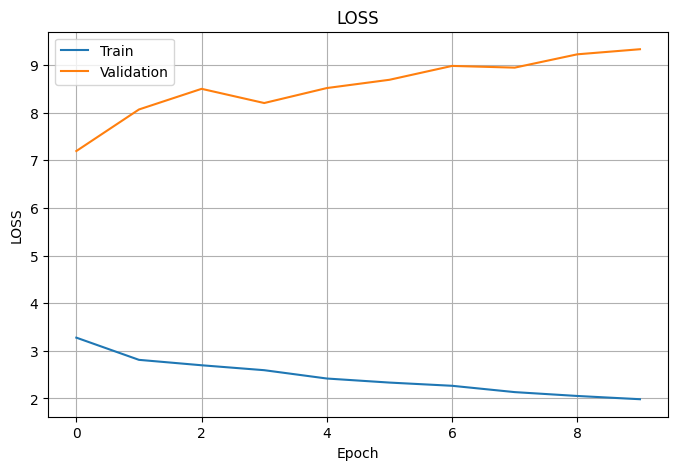

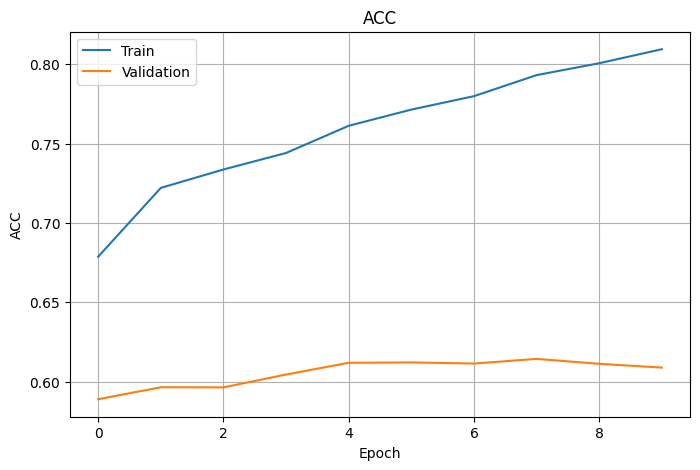

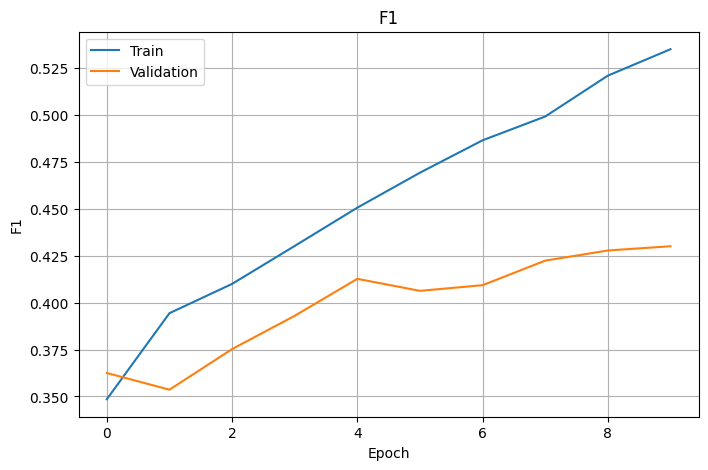

In [78]:
# Try ResNet18 again
model_rn = MultiHeadClassifierRN18(num_classes)
history_rn = train_and_validate_reg(
    model_rn,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    lr=1e-4,
    weight_decay=1e-5,
    patience=5,
    model_path='best_model_rn_reg.pth'
)
plot_history(history_rn)

## EfficientNet-B0-based model training


Epoch 1/10


Valid: 100%|██████████| 99/99 [00:12<00:00,  7.99it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.00      0.00      0.00        60
       maize       0.97      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.97      3149
   macro avg       0.24      0.25      0.25      3149
weighted avg       0.94      0.97      0.96      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.67      0.77      0.72       893
           M       0.82      0.72      0.77       810
           S       0.82      0.86      0.84       160
           V       0.89      0.86      0.88      1286

    accuracy                           0.80      3149
   macro avg       0.80      0.81      0.80      3149
weighted avg       0.81      0.80      0.80      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.85it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.92      0.18      0.31        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.97      3149
   macro avg       0.47      0.30      0.32      3149
weighted avg       0.97      0.97      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.73      0.72       893
           M       0.83      0.74      0.78       810
           S       0.88      0.84      0.86       160
           V       0.87      0.93      0.90      1286

    accuracy                           0.82      3149
   macro avg       0.83      0.81      0.82      3149
weighted avg       0.82      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.97it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.79      0.50      0.61        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.44      0.37      0.40      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.76      0.74       893
           M       0.81      0.77      0.79       810
           S       0.84      0.88      0.86       160
           V       0.90      0.88      0.89      1286

    accuracy                           0.82      3149
   macro avg       0.82      0.82      0.82      3149
weighted avg       0.82      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.89it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.78      0.58      0.67        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.44      0.40      0.41      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.76      0.75       893
           M       0.82      0.79      0.81       810
           S       0.85      0.86      0.85       160
           V       0.90      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.83      0.83      0.83      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.97it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.69      0.63      0.66        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.42      0.41      0.41      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.74      0.74       893
           M       0.82      0.81      0.82       810
           S       0.81      0.89      0.85       160
           V       0.90      0.89      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.83      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.87it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.75      0.67      0.71        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.43      0.42      0.42      3149
weighted avg       0.97      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.75      0.74       893
           M       0.83      0.77      0.80       810
           S       0.88      0.84      0.86       160
           V       0.88      0.93      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.83      0.82      0.83      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.80it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.75      0.65      0.70        60
       maize       0.98      1.00      0.99      3060
     sorghum       1.00      0.04      0.07        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.68      0.42      0.44      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.76      0.75       893
           M       0.83      0.79      0.81       810
           S       0.83      0.88      0.85       160
           V       0.90      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.83      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.02it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.75      0.70      0.72        60
       maize       0.99      1.00      0.99      3060
     sorghum       1.00      0.04      0.07        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.68      0.43      0.45      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.75      0.76      0.76       893
           M       0.84      0.80      0.82       810
           S       0.85      0.84      0.85       160
           V       0.90      0.91      0.90      1286

    accuracy                           0.84      3149
   macro avg       0.83      0.83      0.83      3149
weighted avg       0.84      0.84      0.84      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.99it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.76      0.62      0.68        60
       maize       0.98      1.00      0.99      3060
     sorghum       1.00      0.04      0.07        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.68      0.41      0.43      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.75      0.77      0.76       893
           M       0.85      0.79      0.82       810
           S       0.85      0.84      0.84       160
           V       0.89      0.92      0.91      1286

    accuracy                           0.84      3149
   macro avg       0.84      0.83      0.83      3149
weighted avg       0.84      0.84      0.84      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.84it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.79      0.63      0.70        60
       maize       0.98      1.00      0.99      3060
     sorghum       1.00      0.04      0.07        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.69      0.42      0.44      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.76      0.74      0.75       893
           M       0.82      0.81      0.82       810
           S       0.84      0.86      0.85       160
           V       0.89      0.92      0.90      1286

    accuracy                           0.84      3149
   macro avg       0.83      0.83      0.83      3149
weighted avg       0.83      0.84      0.84      3149


[Validation Report] Task: damage
              preci

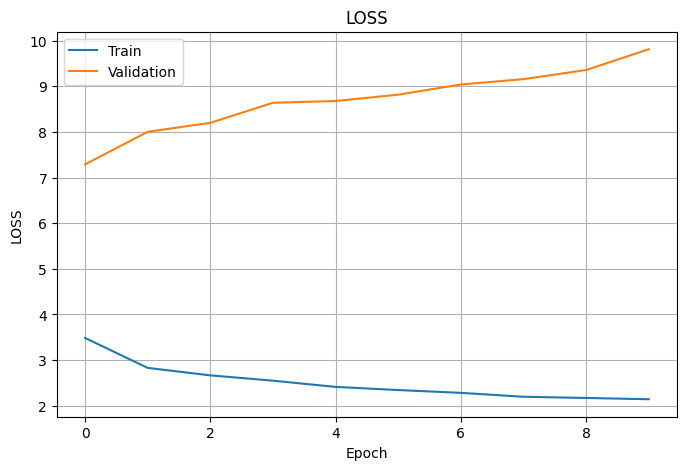

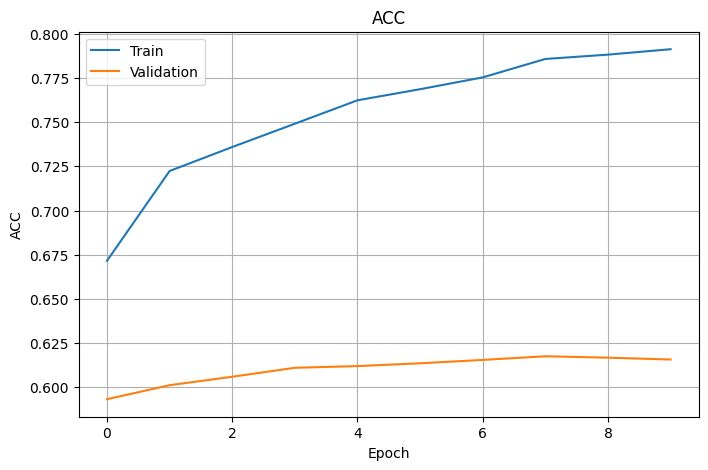

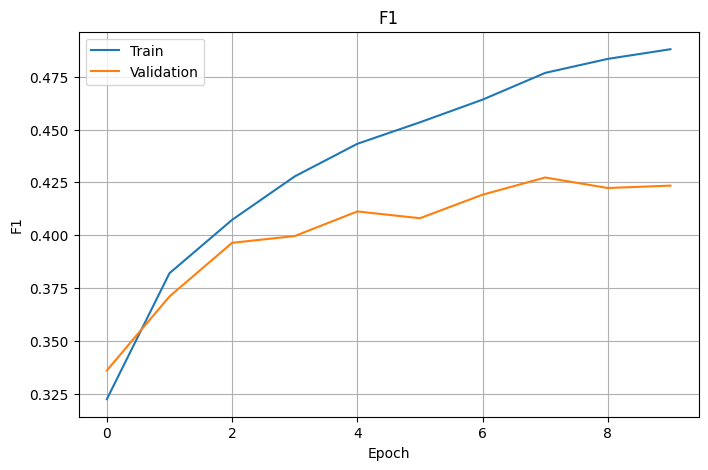

In [79]:
# Try EfficientNet-B0 again
model_effb0 = MultiHeadClassifierEffB0(num_classes)
history_effb0 = train_and_validate_reg(
    model_effb0,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    lr=1e-4,
    weight_decay=1e-5,
    patience=5,
    model_path='best_model_effb0_reg.pth'
)
plot_history(history_effb0)

In [80]:
# Test ResNet18
test_rn = test_model(
    model_rn,
    test_loader,
    train_ds.inverse_label_maps,
    device=None,
    print_reports=True,
    model_path='/kaggle/working/best_model_rn_reg.pth'
)

Test: 100%|██████████| 99/99 [00:14<00:00,  6.98it/s]


=== Test Evaluation ===
[crop_name] Accuracy: 0.9778, Macro-F1: 0.4489
              precision    recall  f1-score   support

  green gram       0.72      0.51      0.60        61
       maize       0.98      1.00      0.99      3058
     sorghum       0.44      0.14      0.21        29
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.54      0.41      0.45      3149
weighted avg       0.97      0.98      0.97      3149

[growth_stage] Accuracy: 0.8190, Macro-F1: 0.8163
              precision    recall  f1-score   support

           F       0.70      0.80      0.75       894
           M       0.83      0.69      0.75       810
           S       0.88      0.84      0.86       160
           V       0.90      0.91      0.90      1285

    accuracy                           0.82      3149
   macro avg       0.83      0.81      0.82      3149
weighted avg       0.82      0.82      0.82      3149

[damage]

In [81]:
# Test EfficientNet-B0
test_rn = test_model(
    model_effb0,
    test_loader,
    train_ds.inverse_label_maps,
    device=None,
    print_reports=True, 
    model_path='/kaggle/working/best_model_effb0_reg.pth'
)

Test: 100%|██████████| 99/99 [00:12<00:00,  8.02it/s]



=== Test Evaluation ===
[crop_name] Accuracy: 0.9765, Macro-F1: 0.4195
              precision    recall  f1-score   support

  green gram       0.65      0.49      0.56        61
       maize       0.98      1.00      0.99      3058
     sorghum       1.00      0.07      0.13        29
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.66      0.39      0.42      3149
weighted avg       0.97      0.98      0.97      3149

[growth_stage] Accuracy: 0.8196, Macro-F1: 0.8168
              precision    recall  f1-score   support

           F       0.72      0.75      0.74       894
           M       0.79      0.76      0.77       810
           S       0.89      0.82      0.85       160
           V       0.90      0.90      0.90      1285

    accuracy                           0.82      3149
   macro avg       0.82      0.81      0.82      3149
weighted avg       0.82      0.82      0.82      3149

[damage]

## Conclusions on adjusted training

**Conclusion:** before augmentation best F1-score on valid for model based on ResNet18 was F1 = 0.4136, after -  F1 = 0.4389. For model, based on EfficientNet-B0 - F1 = 0.4206 and F1 = 0.4326 respectively. So, as we can see, augmentation, ReduceLROnPlateau, Weight decay (L2 regularization) helps to improve quality.      
Also we can see that F1 has improved for the valid, almost same as for train. That is good result. However, the losses on the train and the valid are still very different, increasing on valid, that is indicating overfitting.It might be because of the unbalanced classes and different "difficulty" of training for different tasks (crop name and growth stage have better results than damage and extent).   
As for difference between models - they demonstrate almost same metrics, but model, based on EfficientNet-B0 better for targets with worst performance - damage and extent.   
   
We need to try also to adjust weights of classes losses, e.g. dynamic weighting of losses between tasks.    
Method selection: Dynamic Weight Averaging (DWA).    
Why DWA:
- Simple to implement.
- Does not require additional parameters (unlike GradNorm or trainable weights).
- Takes into account the dynamics of change in losses of each task.
- Works well in tasks with very different complexity/convergence of tasks, like this (damage vs crop_name).

## Training with Dynamic Weight Averaging (DWA)

In [82]:
# Let's change train_one_epoch to return losses by tasks
def train_one_epoch_dwa(model, dataloader, optimizer, criterion, device, task_weights=None):
    model.train()
    running_loss = 0.0
    all_preds = defaultdict(list)
    all_labels = defaultdict(list)
    task_losses = defaultdict(float)

    for inputs, labels in tqdm(dataloader, desc='Train'):
        inputs = inputs.to(device)
        labels = {k: v.to(device) for k, v in labels.items()}

        outputs = model(inputs)

        losses = {
            k: criterion(outputs[k], labels[k])
            for k in outputs
        }

        # Sum up the losses with the weights
        loss = sum(task_weights.get(k, 1.0) * losses[k] for k in outputs)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        for k in losses:
            task_losses[k] += losses[k].item()

        for key in outputs:
            preds = torch.argmax(outputs[key], dim=1)
            all_preds[key].extend(preds.cpu().numpy())
            all_labels[key].extend(labels[key].cpu().numpy())

    avg_loss = running_loss / len(dataloader)
    avg_acc = np.mean([accuracy_score(all_labels[k], all_preds[k]) for k in all_preds])
    avg_f1 = np.mean([f1_score(all_labels[k], all_preds[k], average='macro', zero_division=0) for k in all_preds])
    avg_task_losses = {k: v / len(dataloader) for k, v in task_losses.items()}

    return avg_loss, avg_acc, avg_f1, avg_task_losses

In [83]:
# Helper function for weights plot
def plot_task_weights(task_weight_log):
    epochs = list(range(1, len(next(iter(task_weight_log.values()))) + 1))
    plt.figure(figsize=(10, 6))
    for task, weights in task_weight_log.items():
        plt.plot(epochs, weights, marker='o', label=task)
    plt.xlabel("Epoch")
    plt.ylabel("Task Weight (DWA)")
    plt.title("Dynamic Task Weights per Epoch")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

In [84]:
# Integration DWA logic into train_and_validate function
def train_and_validate_dwa(
    model,
    inverse_label_maps,
    num_epochs=50,
    lr=1e-4,
    weight_decay=1e-5,
    model_path='best_model.pth',
    patience=5,
    temperature=2.0
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
    scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)

    task_names = list(train_loader.dataset.label_cols)
    task_weights = {k: 1.0 for k in task_names}
    task_loss_history = {k: [] for k in task_names}
    task_weight_log = {k: [] for k in task_names}

    best_f1 = 0.0
    best_model_state = copy.deepcopy(model.state_dict())
    epochs_no_improve = 0

    history = {f"{p}_{m}": [] for p in ['train', 'val'] for m in ['loss', 'acc', 'f1']}

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")

        train_loss, train_acc, train_f1, train_task_losses = train_one_epoch_dwa(
            model, train_loader, optimizer, criterion, device, task_weights=task_weights
        )

        val_loss, val_acc, val_f1 = evaluate(
            model, valid_loader, criterion, inverse_label_maps, device
        )

        for k in train_task_losses:
            task_loss_history[k].append(train_task_losses[k])

        # DWA weights update since epoch 2
        if epoch >= 2:
            w = {}
            for k in task_names:
                prev = task_loss_history[k][-2]
                curr = task_loss_history[k][-1]
                w[k] = prev / (curr + 1e-8)

            exp_w = {k: math.exp(w[k] / temperature) for k in w}
            sum_exp = sum(exp_w.values())
            task_weights = {k: exp_w[k] * len(w) / sum_exp for k in w}

        # Logging weights
        for k in task_names:
            task_weight_log[k].append(task_weights.get(k, 1.0))

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_f1'].append(train_f1)
        history['val_f1'].append(val_f1)

        print(f"[Train] Loss: {train_loss:.4f} | Acc: {train_acc:.4f} | F1: {train_f1:.4f}")
        print(f"[Valid] Loss: {val_loss:.4f} | Acc: {val_acc:.4f} | F1: {val_f1:.4f}")

        scheduler.step(val_loss)

        if val_f1 > best_f1:
            best_f1 = val_f1
            best_model_state = copy.deepcopy(model.state_dict())
            torch.save(best_model_state, model_path)
            print(f"✅ Saved new best model with F1 = {best_f1:.4f}")
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1
            if epochs_no_improve >= patience:
                print(f"Early stopping triggered at epoch {epoch+1}")
                break
                
    # Plot task weights
    plot_task_weights(task_weight_log)

    return history

## ResNet18-based model training with DWA


Epoch 1/15


Valid: 100%|██████████| 99/99 [00:12<00:00,  8.22it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.73      0.13      0.23        60
       maize       0.97      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.97      3149
   macro avg       0.43      0.28      0.30      3149
weighted avg       0.96      0.97      0.96      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.69      0.71       893
           M       0.77      0.82      0.80       810
           S       0.84      0.80      0.82       160
           V       0.88      0.89      0.88      1286

    accuracy                           0.81      3149
   macro avg       0.81      0.80      0.80      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.88it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.59      0.67      0.62        60
       maize       0.99      0.99      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.39      0.41      0.40      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.66      0.84      0.74       893
           M       0.86      0.67      0.75       810
           S       0.79      0.87      0.82       160
           V       0.92      0.86      0.89      1286

    accuracy                           0.81      3149
   macro avg       0.81      0.81      0.80      3149
weighted avg       0.82      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.90it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.73      0.50      0.59        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.43      0.37      0.40      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.69      0.82      0.75       893
           M       0.87      0.71      0.78       810
           S       0.83      0.84      0.83       160
           V       0.90      0.89      0.90      1286

    accuracy                           0.82      3149
   macro avg       0.82      0.81      0.81      3149
weighted avg       0.83      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.98it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.74      0.58      0.65        60
       maize       0.98      1.00      0.99      3060
     sorghum       1.00      0.04      0.07        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.68      0.40      0.43      3149
weighted avg       0.98      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.76      0.74       893
           M       0.82      0.78      0.80       810
           S       0.79      0.86      0.82       160
           V       0.89      0.89      0.89      1286

    accuracy                           0.82      3149
   macro avg       0.81      0.82      0.81      3149
weighted avg       0.82      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.95it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.92      0.57      0.70        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.33      0.04      0.06        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.56      0.40      0.44      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.75      0.72      0.74       893
           M       0.83      0.79      0.81       810
           S       0.83      0.82      0.83       160
           V       0.87      0.92      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.82      0.82      3149
weighted avg       0.82      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.22it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.91      0.53      0.67        60
       maize       0.98      1.00      0.99      3060
     sorghum       1.00      0.04      0.07        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.72      0.39      0.43      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.70      0.80      0.75       893
           M       0.86      0.73      0.79       810
           S       0.75      0.88      0.81       160
           V       0.90      0.88      0.89      1286

    accuracy                           0.82      3149
   macro avg       0.80      0.82      0.81      3149
weighted avg       0.82      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.21it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.80      0.62      0.70        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.50      0.11      0.18        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.57      0.43      0.47      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.75      0.74      0.75       893
           M       0.82      0.79      0.81       810
           S       0.81      0.85      0.83       160
           V       0.89      0.91      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.82      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:13<00:00,  7.37it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.90      0.62      0.73        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.43      0.11      0.17        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.58      0.43      0.47      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.79      0.76       893
           M       0.85      0.78      0.81       810
           S       0.81      0.85      0.83       160
           V       0.90      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.83      3149
weighted avg       0.84      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.39it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.88      0.58      0.70        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.43      0.11      0.17        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.57      0.42      0.47      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.79      0.76       893
           M       0.86      0.77      0.81       810
           S       0.83      0.84      0.83       160
           V       0.89      0.91      0.90      1286

    accuracy                           0.84      3149
   macro avg       0.83      0.83      0.83      3149
weighted avg       0.84      0.84      0.84      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.20it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.85      0.73      0.79        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.50      0.14      0.22        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.58      0.47      0.50      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.75      0.76      0.76       893
           M       0.84      0.79      0.81       810
           S       0.85      0.82      0.83       160
           V       0.89      0.92      0.90      1286

    accuracy                           0.84      3149
   macro avg       0.83      0.82      0.83      3149
weighted avg       0.84      0.84      0.84      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.06it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.89      0.68      0.77        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.38      0.11      0.17        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.56      0.45      0.48      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.76      0.74      0.75       893
           M       0.81      0.81      0.81       810
           S       0.82      0.84      0.83       160
           V       0.90      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.34it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.89      0.67      0.76        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.60      0.11      0.18        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.62      0.44      0.48      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.79      0.76       893
           M       0.85      0.76      0.80       810
           S       0.79      0.84      0.82       160
           V       0.90      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.82      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.38it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.84      0.70      0.76        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.50      0.14      0.22        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.58      0.46      0.49      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.78      0.75       893
           M       0.85      0.76      0.80       810
           S       0.82      0.84      0.83       160
           V       0.90      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.82      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.08it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.82      0.68      0.75        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.57      0.14      0.23        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.59      0.46      0.49      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.77      0.76       893
           M       0.85      0.76      0.80       810
           S       0.84      0.83      0.83       160
           V       0.88      0.92      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.83      0.82      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.43it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.87      0.68      0.77        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.57      0.14      0.23        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.61      0.46      0.50      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.78      0.76       893
           M       0.84      0.78      0.81       810
           S       0.81      0.84      0.83       160
           V       0.90      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

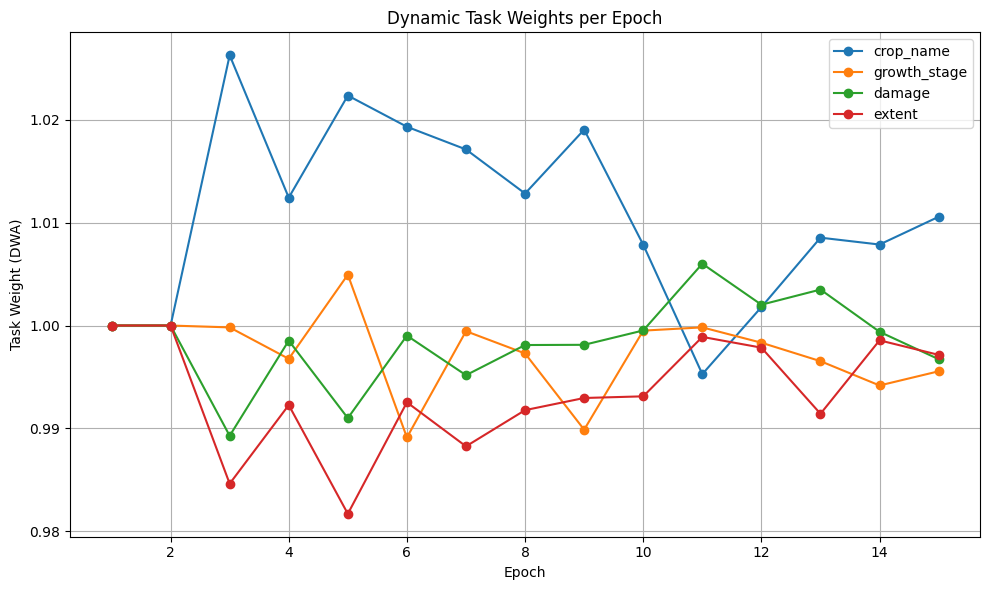

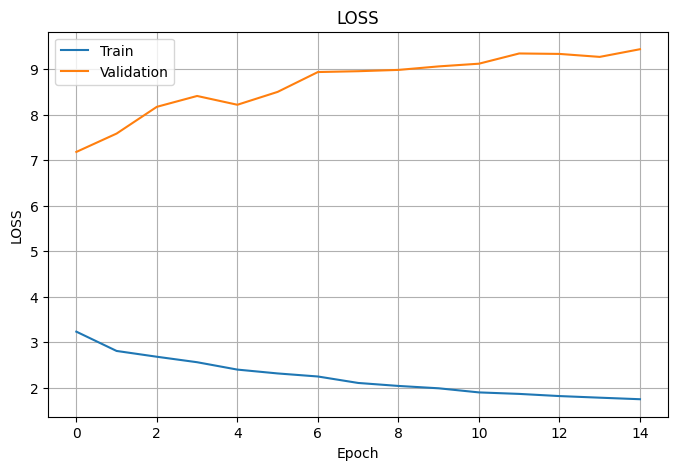

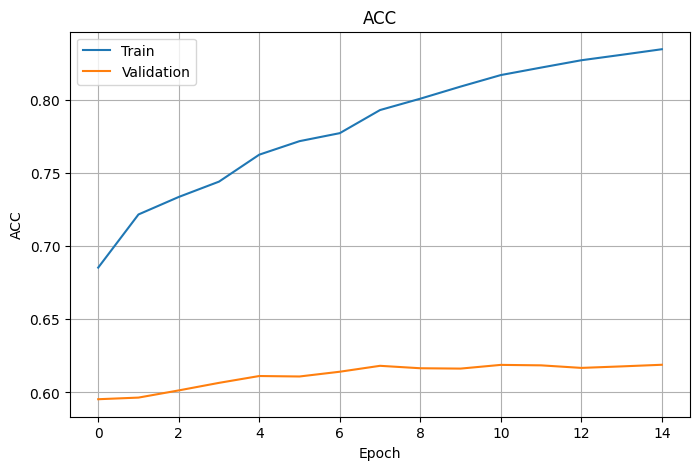

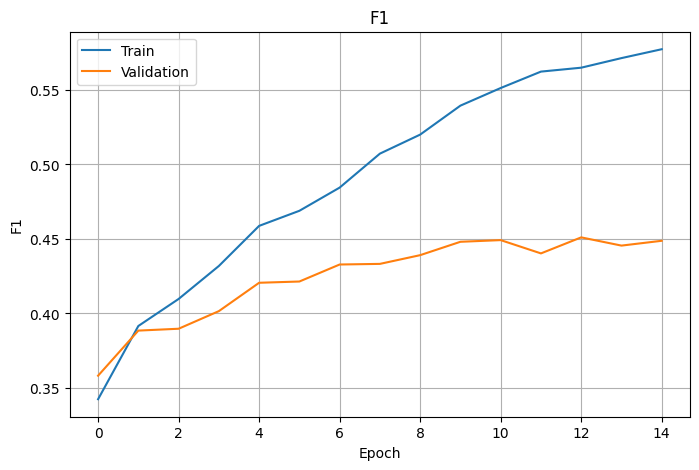

In [85]:
# ResNet18 training and evaluation with DWA
model_rn = MultiHeadClassifierRN18(num_classes)
history_rn = train_and_validate_dwa(
    model_rn,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=15,
    lr=1e-4,
    weight_decay=1e-5,
    model_path='best_model_rn_dwa.pth',
    temperature=2.0
)
plot_history(history_rn)

## EfficientNet-B0-based model training with DWA


Epoch 1/15


Valid: 100%|██████████| 99/99 [00:12<00:00,  7.99it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       1.00      0.05      0.10        60
       maize       0.97      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.97      3149
   macro avg       0.49      0.26      0.27      3149
weighted avg       0.96      0.97      0.96      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.67      0.72      0.70       893
           M       0.80      0.72      0.76       810
           S       0.87      0.78      0.82       160
           V       0.86      0.89      0.87      1286

    accuracy                           0.79      3149
   macro avg       0.80      0.77      0.79      3149
weighted avg       0.79      0.79      0.79      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.07it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.96      0.37      0.53        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.48      0.34      0.38      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.70      0.75      0.73       893
           M       0.81      0.74      0.78       810
           S       0.81      0.89      0.85       160
           V       0.89      0.88      0.88      1286

    accuracy                           0.81      3149
   macro avg       0.80      0.82      0.81      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.06it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.85      0.55      0.67        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.46      0.39      0.41      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.70      0.77      0.73       893
           M       0.82      0.74      0.78       810
           S       0.85      0.86      0.85       160
           V       0.90      0.89      0.89      1286

    accuracy                           0.81      3149
   macro avg       0.82      0.81      0.81      3149
weighted avg       0.82      0.81      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.06it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.94      0.50      0.65        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.48      0.37      0.41      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.77      0.67      0.71       893
           M       0.78      0.82      0.80       810
           S       0.84      0.86      0.85       160
           V       0.87      0.92      0.90      1286

    accuracy                           0.82      3149
   macro avg       0.81      0.82      0.81      3149
weighted avg       0.82      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.82it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.83      0.65      0.73        60
       maize       0.98      1.00      0.99      3060
     sorghum       1.00      0.04      0.07        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.70      0.42      0.45      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.75      0.74       893
           M       0.81      0.78      0.80       810
           S       0.82      0.88      0.85       160
           V       0.90      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.84it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.74      0.70      0.72        60
       maize       0.99      1.00      0.99      3060
     sorghum       1.00      0.04      0.07        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.68      0.43      0.44      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.76      0.74       893
           M       0.83      0.76      0.79       810
           S       0.81      0.88      0.84       160
           V       0.90      0.90      0.90      1286

    accuracy                           0.82      3149
   macro avg       0.81      0.83      0.82      3149
weighted avg       0.83      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.13it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.66      0.70      0.68        60
       maize       0.99      0.99      0.99      3060
     sorghum       0.33      0.04      0.06        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.49      0.43      0.43      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.77      0.75       893
           M       0.83      0.76      0.80       810
           S       0.83      0.88      0.85       160
           V       0.90      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.06it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.83      0.63      0.72        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.67      0.07      0.13        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.62      0.43      0.46      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.75      0.75      0.75       893
           M       0.83      0.79      0.81       810
           S       0.82      0.88      0.85       160
           V       0.89      0.92      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.83      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.73it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.84      0.63      0.72        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.67      0.07      0.13        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.62      0.43      0.46      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.76      0.75       893
           M       0.85      0.76      0.80       810
           S       0.81      0.88      0.84       160
           V       0.89      0.93      0.91      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.19it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.78      0.65      0.71        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.75      0.11      0.19        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.63      0.44      0.47      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.77      0.75       893
           M       0.84      0.78      0.81       810
           S       0.83      0.88      0.85       160
           V       0.90      0.91      0.91      1286

    accuracy                           0.84      3149
   macro avg       0.83      0.84      0.83      3149
weighted avg       0.84      0.84      0.84      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.11it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.79      0.63      0.70        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.60      0.11      0.18        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.59      0.43      0.47      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.75      0.76      0.75       893
           M       0.84      0.78      0.81       810
           S       0.86      0.85      0.86       160
           V       0.89      0.92      0.91      1286

    accuracy                           0.84      3149
   macro avg       0.84      0.83      0.83      3149
weighted avg       0.84      0.84      0.84      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.81it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.81      0.63      0.71        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.75      0.11      0.19        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.64      0.43      0.47      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.76      0.75       893
           M       0.84      0.78      0.81       810
           S       0.81      0.86      0.83       160
           V       0.89      0.91      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.00it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.74      0.65      0.69        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.60      0.11      0.18        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.58      0.44      0.47      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.78      0.75       893
           M       0.85      0.74      0.79       810
           S       0.81      0.89      0.85       160
           V       0.90      0.91      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.09it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.69      0.72      0.70        60
       maize       0.99      0.99      0.99      3060
     sorghum       0.60      0.11      0.18        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.57      0.45      0.47      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.77      0.75       893
           M       0.82      0.79      0.81       810
           S       0.82      0.88      0.85       160
           V       0.91      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.83      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.71it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.71      0.68      0.69        60
       maize       0.99      0.99      0.99      3060
     sorghum       0.60      0.11      0.18        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.57      0.45      0.47      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.78      0.76       893
           M       0.84      0.77      0.80       810
           S       0.83      0.86      0.84       160
           V       0.90      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.83      0.83      0.83      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

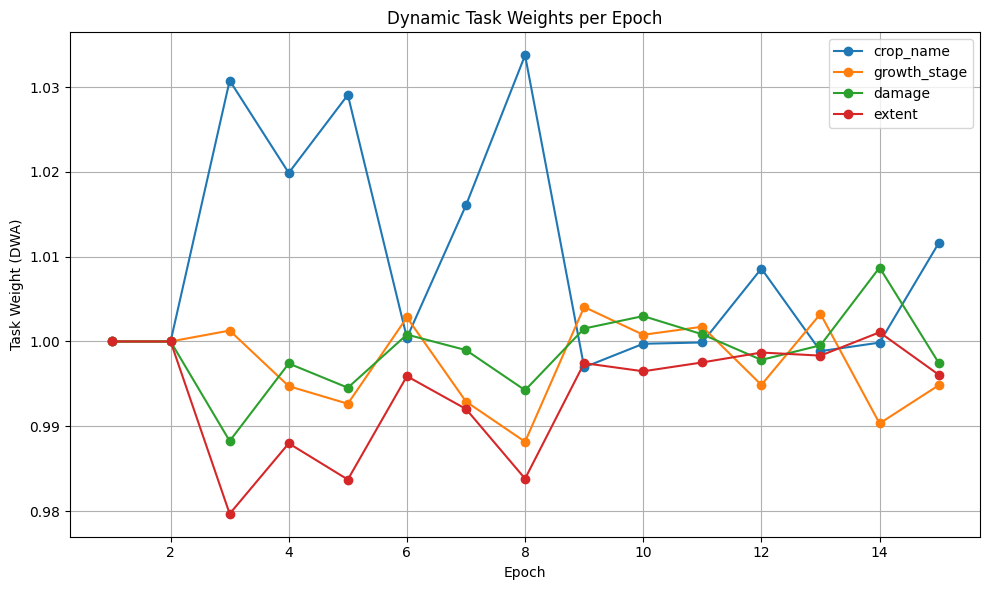

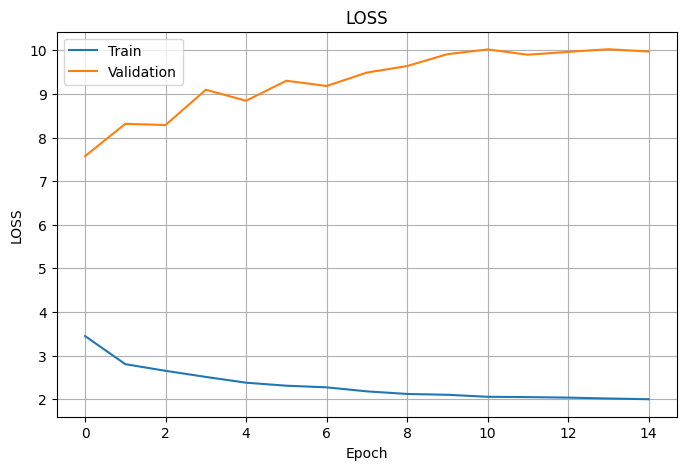

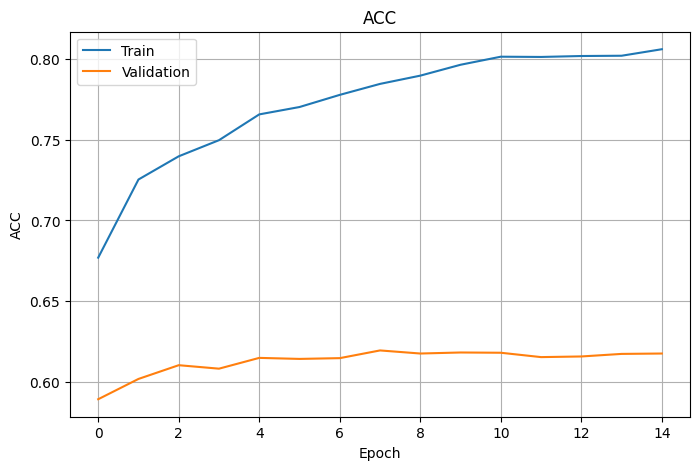

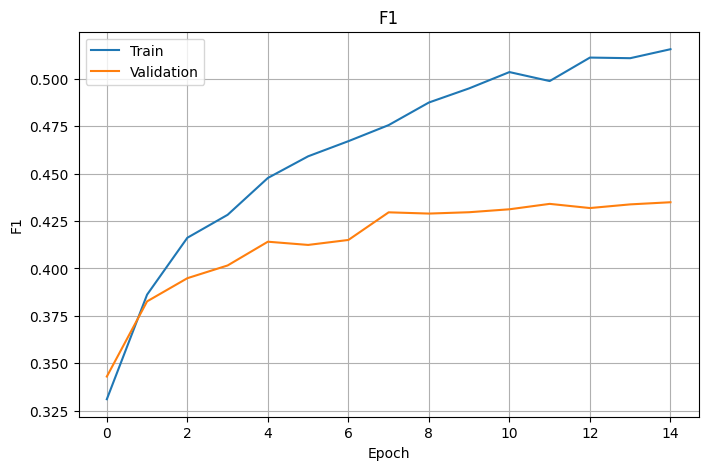

In [86]:
# EfficientNet-B0 training and evaluation with DWA
model_effb0 = MultiHeadClassifierEffB0(num_classes)
history_effb0 = train_and_validate_dwa(
    model_effb0,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=15,
    lr=1e-4,
    weight_decay=1e-5,
    model_path='best_model_effb0_dwa.pth',
    temperature=2.0
)
plot_history(history_effb0)

In [87]:
warnings.filterwarnings('ignore')

In [88]:
# Test ResNet18 trained with DWA
test_rn = test_model(
    model_rn,
    test_loader,
    train_ds.inverse_label_maps,
    device=None,
    print_reports=True,
    model_path='/kaggle/working/best_model_rn_dwa.pth'
)

Test: 100%|██████████| 99/99 [00:14<00:00,  6.66it/s]


=== Test Evaluation ===
[crop_name] Accuracy: 0.9790, Macro-F1: 0.4913
              precision    recall  f1-score   support

  green gram       0.78      0.52      0.63        61
       maize       0.98      1.00      0.99      3058
     sorghum       0.47      0.28      0.35        29
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.56      0.45      0.49      3149
weighted avg       0.98      0.98      0.98      3149

[growth_stage] Accuracy: 0.8238, Macro-F1: 0.8218
              precision    recall  f1-score   support

           F       0.72      0.77      0.75       894
           M       0.82      0.75      0.78       810
           S       0.87      0.85      0.86       160
           V       0.89      0.91      0.90      1285

    accuracy                           0.82      3149
   macro avg       0.83      0.82      0.82      3149
weighted avg       0.83      0.82      0.82      3149

[damage]

In [89]:
# Test EfficientNet-B0 trained with DWA
test_effb0 = test_model(
    model_effb0,
    test_loader,
    train_ds.inverse_label_maps,
    device=None,
    print_reports=True, 
    model_path='/kaggle/working/best_model_effb0_dwa.pth'
)

Test: 100%|██████████| 99/99 [00:12<00:00,  7.80it/s]



=== Test Evaluation ===
[crop_name] Accuracy: 0.9784, Macro-F1: 0.4379
              precision    recall  f1-score   support

  green gram       0.69      0.59      0.64        61
       maize       0.98      1.00      0.99      3058
     sorghum       0.67      0.07      0.12        29
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.59      0.41      0.44      3149
weighted avg       0.97      0.98      0.97      3149

[growth_stage] Accuracy: 0.8177, Macro-F1: 0.8142
              precision    recall  f1-score   support

           F       0.72      0.76      0.74       894
           M       0.80      0.73      0.77       810
           S       0.86      0.84      0.85       160
           V       0.90      0.91      0.90      1285

    accuracy                           0.82      3149
   macro avg       0.82      0.81      0.81      3149
weighted avg       0.82      0.82      0.82      3149

[damage]

## Conclusions on DWA training



So, we get again some small improvement of average F1 on validation. 
There is still loss increase on validation and a decrease on training. This is a sign of overfitting. Accuracy and F1 also retain their behavior. At the same time, an increase in the number of epochs did not lead to a further increase in F1. After about 10 epochs, F1 grows only in the third decimal place. Accuracy grows very weakly.     
The reason may be that CrossEntropy Loss is sensitive to the confidence of the model: if the model makes a mistake, but is confident (the logit is high), then the penalty is large. On validation, the model can make mistakes with high confidence → high loss, even if it predicts the correct classes more often. F1 and Accuracy are discrete label indicators, and loss is a continuous function. So, loss can grow even when F1/accuracy grow.    
Validation Accuracy grows weakly, most likely due to class imbalance.    
Valid loss increase can be fixed by:
- Using weighted or balanced CrossEntropyLoss - currently, loss estimates errors equally across all classes, which is unfair with strong imbalance.
- Using Label Smoothing - this will reduce model confidence and reduce overconfidence - will help validation loss.
- Increase regularization by dropout: can be added to MultiHeadClassifier, before heads.

## Improved model based on ResNet18

In [90]:
class MultiHeadClassifierRN18Reg(nn.Module):
    def __init__(self, num_classes_dict, dropout_rate=0.1):
        super().__init__()
        base_model = resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)
        self.backbone = nn.Sequential(*list(base_model.children())[:-1])  # remove FC
        self.flatten = nn.Flatten()
        self.bn = nn.BatchNorm1d(base_model.fc.in_features)
        self.dropout = nn.Dropout(p=dropout_rate)

        in_features = base_model.fc.in_features
        self.heads = nn.ModuleDict({
            name: nn.Sequential(
                nn.Dropout(p=dropout_rate),
                nn.Linear(in_features, num_classes)
            )
            for name, num_classes in num_classes_dict.items()
        })

    def forward(self, x):
        x = self.backbone(x)
        x = self.flatten(x)
        x = self.bn(x)
        x = self.dropout(x)
        outputs = {name: head(x) for name, head in self.heads.items()}
        return outputs

## Improved model based on EfficientNet-B0

In [91]:
class MultiHeadClassifierEffB0Reg(nn.Module):
    def __init__(self, num_classes_dict, dropout_rate=0.1):
        super().__init__()
        base_model = efficientnet_b0(weights=EfficientNet_B0_Weights.IMAGENET1K_V1)

        self.backbone = base_model.features
        self.pool = base_model.avgpool
        self.flatten = nn.Flatten()

        in_features = base_model.classifier[1].in_features
        self.bn = nn.BatchNorm1d(in_features)
        self.dropout = nn.Dropout(p=dropout_rate)

        self.heads = nn.ModuleDict({
            name: nn.Sequential(
                nn.Dropout(p=dropout_rate),
                nn.Linear(in_features, num_classes)
            )
            for name, num_classes in num_classes_dict.items()
        })

    def forward(self, x):
        x = self.backbone(x)
        x = self.pool(x)
        x = self.flatten(x)
        x = self.bn(x)
        x = self.dropout(x)
        outputs = {name: head(x) for name, head in self.heads.items()}
        return outputs

## New train and evaluation functions

In [92]:
# Let's add a function that calculates weights from a DataFrame
def compute_task_class_weights(df, label_cols, method='mean'):
    class_weights = {}
    for col in label_cols:
        y = df[col]
        classes = sorted(y.unique())
        weights = compute_class_weight(class_weight='balanced', classes=classes, y=y)
        weights_tensor = torch.tensor(weights, dtype=torch.float)

        # Normalization
        if method == 'max':
            weights_tensor = weights_tensor / weights_tensor.max()
        elif method == 'mean':
            weights_tensor = weights_tensor / weights_tensor.mean()

        class_weights[col] = weights_tensor

    return class_weights

In [93]:
# Getting weights from a dataset
train_df = pd.read_csv("train.csv")
label_cols = ['crop_name', 'growth_stage', 'damage', 'extent']

class_weights_dict = compute_task_class_weights(train_df, label_cols)

In [94]:
# Creating CrossEntropyLoss with label smoothing and weights
def build_loss_functions(class_weights_dict, device, smoothing=0.1):
    loss_fns = {}
    for task, weights in class_weights_dict.items():
        weights = weights.to(device)
        loss = torch.nn.CrossEntropyLoss(weight=weights, label_smoothing=smoothing)
        loss_fns[task] = loss
    return loss_fns

Modify train_one_epoch (and evaluate) to accept a loss_fns dictionary.

In [95]:
def train_one_epoch_wgt(model, dataloader, optimizer, loss_fns, device, task_weights=None):
    model.train()
    running_loss = 0.0
    all_preds = defaultdict(list)
    all_labels = defaultdict(list)
    task_losses = defaultdict(float)

    for inputs, labels in tqdm(dataloader, desc='Train'):
        inputs = inputs.to(device)
        labels = {k: v.to(device) for k, v in labels.items()}

        outputs = model(inputs)

        losses = {
            k: loss_fns[k](outputs[k], labels[k])
            for k in outputs
        }

        loss = sum(task_weights.get(k, 1.0) * losses[k] for k in outputs)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        for k in losses:
            task_losses[k] += losses[k].item()

        for key in outputs:
            preds = torch.argmax(outputs[key], dim=1)
            all_preds[key].extend(preds.cpu().numpy())
            all_labels[key].extend(labels[key].cpu().numpy())

    avg_loss = running_loss / len(dataloader)
    avg_acc = np.mean([accuracy_score(all_labels[k], all_preds[k]) for k in all_preds])
    avg_f1 = np.mean([f1_score(all_labels[k], all_preds[k], average='macro', zero_division=0) for k in all_preds])
    avg_task_losses = {k: v / len(dataloader) for k, v in task_losses.items()}

    return avg_loss, avg_acc, avg_f1, avg_task_losses

In [96]:
def evaluate_wgt(model, dataloader, loss_fns, inverse_label_maps, device, print_reports=True):
    model.eval()
    running_loss = 0.0
    all_preds = defaultdict(list)
    all_labels = defaultdict(list)

    with torch.no_grad():
        for inputs, labels in tqdm(dataloader, desc='Valid'):
            inputs = inputs.to(device)
            labels = {k: v.to(device) for k, v in labels.items()}

            outputs = model(inputs)
            loss = sum(loss_fns[k](outputs[k], labels[k]) for k in outputs)
            running_loss += loss.item()

            for key in outputs:
                preds = torch.argmax(outputs[key], dim=1)
                all_preds[key].extend(preds.cpu().numpy())
                all_labels[key].extend(labels[key].cpu().numpy())

    avg_loss = running_loss / len(dataloader)
    avg_acc = np.mean([accuracy_score(all_labels[k], all_preds[k]) for k in all_preds])
    avg_f1 = np.mean([f1_score(all_labels[k], all_preds[k], average='macro', zero_division=0) for k in all_preds])

    if print_reports:
        for key in all_preds:
            y_true = list(map(int, all_labels[key]))
            y_pred = list(map(int, all_preds[key]))
            unique_labels = sorted(set(y_true + y_pred))
            target_names = [str(inverse_label_maps[key][i]) for i in unique_labels]

            print(f"\n[Validation Report] Task: {key}")
            print(classification_report(y_true, y_pred, target_names=target_names, zero_division=0))

    return avg_loss, avg_acc, avg_f1

In [97]:
def train_and_validate_wgt(
    model,
    inverse_label_maps,
    num_epochs=50,
    lr=1e-4,
    weight_decay=1e-5,
    model_path='best_model.pth',
    patience=5,
    temperature=2.0,
    min_task_weight = 0.2
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)

    # Class weights
    class_weights_dict = compute_task_class_weights(train_df, label_cols)

    # Loss functions с label smoothing
    loss_fns = build_loss_functions(class_weights_dict, device, smoothing=0.1)
    
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
    scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)

    task_names = list(train_loader.dataset.label_cols)
    task_weights = {k: 1.0 for k in task_names}
    task_loss_history = {k: [] for k in task_names}
    task_weight_log = {k: [] for k in task_names}

    best_f1 = 0.0
    best_model_state = copy.deepcopy(model.state_dict())
    epochs_no_improve = 0

    history = {f"{p}_{m}": [] for p in ['train', 'val'] for m in ['loss', 'acc', 'f1']}

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")

        train_loss, train_acc, train_f1, train_task_losses = train_one_epoch_wgt(
            model, train_loader, optimizer, loss_fns, device, task_weights=task_weights
        )

        val_loss, val_acc, val_f1 = evaluate_wgt(
            model, valid_loader, loss_fns, inverse_label_maps, device
        )

        for k in train_task_losses:
            task_loss_history[k].append(train_task_losses[k])

        # DWA weights update since epoch 2
        if epoch >= 2:
            w = {}
            for k in task_names:
                prev = task_loss_history[k][-2]
                curr = task_loss_history[k][-1]
                w[k] = prev / (curr + 1e-8)

            exp_w = {k: math.exp(w[k] / temperature) for k in w}
            sum_exp = sum(exp_w.values())
            task_weights = {
                k: max(exp_w[k] * len(w) / sum_exp, min_task_weight)
                for k in w
            }

        # Logging weights
        for k in task_names:
            task_weight_log[k].append(task_weights.get(k, 1.0))

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_f1'].append(train_f1)
        history['val_f1'].append(val_f1)

        task_loss_str = ' | '.join(f"{k}: {v:.4f}" for k, v in train_task_losses.items())
        print(f"[Train] Loss: {train_loss:.4f} | Acc: {train_acc:.4f} | F1: {train_f1:.4f} | {task_loss_str}")
        print(f"[Valid] Loss: {val_loss:.4f} | Acc: {val_acc:.4f} | F1: {val_f1:.4f}")

        scheduler.step(val_loss)

        if val_f1 > best_f1:
            best_f1 = val_f1
            best_model_state = copy.deepcopy(model.state_dict())
            torch.save(best_model_state, model_path)
            print(f"✅ Saved new best model with F1 = {best_f1:.4f}")
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1
            if epochs_no_improve >= patience:
                print(f"Early stopping triggered at epoch {epoch+1}")
                break
                
    # Plot task weights
    plot_task_weights(task_weight_log)

    return history

## New ResNet18-based model training and evaluation with new loss_fn and weighted classes


Epoch 1/10


Valid: 100%|██████████| 99/99 [00:12<00:00,  7.75it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.00      0.00      0.00        60
       maize       1.00      0.01      0.01      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.01      3149
   macro avg       0.25      0.25      0.00      3149
weighted avg       0.97      0.01      0.01      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.62      0.34      0.44       893
           M       0.67      0.70      0.69       810
           S       0.28      0.97      0.43       160
           V       0.70      0.67      0.69      1286

    accuracy                           0.60      3149
   macro avg       0.57      0.67      0.56      3149
weighted avg       0.65      0.60      0.60      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.85it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.00      0.00      0.00        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.00      0.25      0.00      3149
weighted avg       0.00      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.56      0.66      0.61       893
           M       0.75      0.71      0.73       810
           S       0.49      0.93      0.64       160
           V       0.85      0.67      0.75      1286

    accuracy                           0.69      3149
   macro avg       0.66      0.74      0.68      3149
weighted avg       0.72      0.69      0.70      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.93it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.00      0.00      0.00        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.00      0.25      0.00      3149
weighted avg       0.00      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.58      0.73      0.64       893
           M       0.79      0.68      0.73       810
           S       0.51      0.96      0.67       160
           V       0.87      0.69      0.77      1286

    accuracy                           0.71      3149
   macro avg       0.69      0.77      0.70      3149
weighted avg       0.75      0.71      0.72      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.92it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.00      0.00      0.00        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.00      0.25      0.00      3149
weighted avg       0.00      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.60      0.73      0.66       893
           M       0.77      0.71      0.74       810
           S       0.50      0.95      0.65       160
           V       0.89      0.70      0.79      1286

    accuracy                           0.72      3149
   macro avg       0.69      0.77      0.71      3149
weighted avg       0.76      0.72      0.73      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.79it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.00      0.00      0.00        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.00      0.25      0.00      3149
weighted avg       0.00      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.62      0.75      0.68       893
           M       0.79      0.73      0.76       810
           S       0.46      0.96      0.62       160
           V       0.91      0.70      0.79      1286

    accuracy                           0.73      3149
   macro avg       0.70      0.78      0.71      3149
weighted avg       0.77      0.73      0.74      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.62it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       1.00      0.02      0.03        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.25      0.25      0.01      3149
weighted avg       0.02      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.63      0.77      0.69       893
           M       0.81      0.67      0.73       810
           S       0.57      0.93      0.71       160
           V       0.89      0.78      0.83      1286

    accuracy                           0.76      3149
   macro avg       0.73      0.79      0.74      3149
weighted avg       0.78      0.76      0.76      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.00it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.71      0.50      0.59        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.01      3149
   macro avg       0.18      0.38      0.15      3149
weighted avg       0.01      0.01      0.01      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.64      0.75      0.69       893
           M       0.83      0.66      0.74       810
           S       0.55      0.94      0.70       160
           V       0.88      0.81      0.84      1286

    accuracy                           0.76      3149
   macro avg       0.73      0.79      0.74      3149
weighted avg       0.78      0.76      0.77      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.91it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.89      0.13      0.23        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.22      0.28      0.06      3149
weighted avg       0.02      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.68      0.75      0.72       893
           M       0.80      0.76      0.78       810
           S       0.60      0.93      0.73       160
           V       0.91      0.81      0.86      1286

    accuracy                           0.79      3149
   macro avg       0.75      0.81      0.77      3149
weighted avg       0.80      0.79      0.79      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.02it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.93      0.23      0.37        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.23      0.31      0.09      3149
weighted avg       0.02      0.00      0.01      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.67      0.77      0.71       893
           M       0.82      0.71      0.76       810
           S       0.59      0.93      0.72       160
           V       0.90      0.82      0.86      1286

    accuracy                           0.78      3149
   macro avg       0.74      0.81      0.76      3149
weighted avg       0.80      0.78      0.79      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.09it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       1.00      0.10      0.18        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.25      0.28      0.05      3149
weighted avg       0.02      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.69      0.71      0.70       893
           M       0.77      0.79      0.78       810
           S       0.50      0.94      0.66       160
           V       0.91      0.79      0.85      1286

    accuracy                           0.77      3149
   macro avg       0.72      0.81      0.75      3149
weighted avg       0.79      0.77      0.78      3149


[Validation Report] Task: damage
              preci

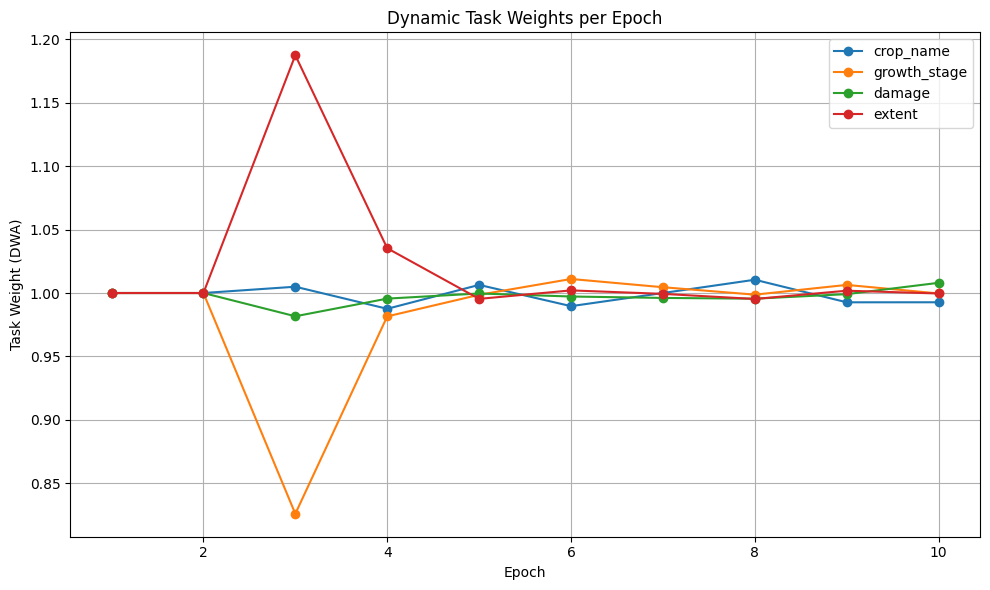

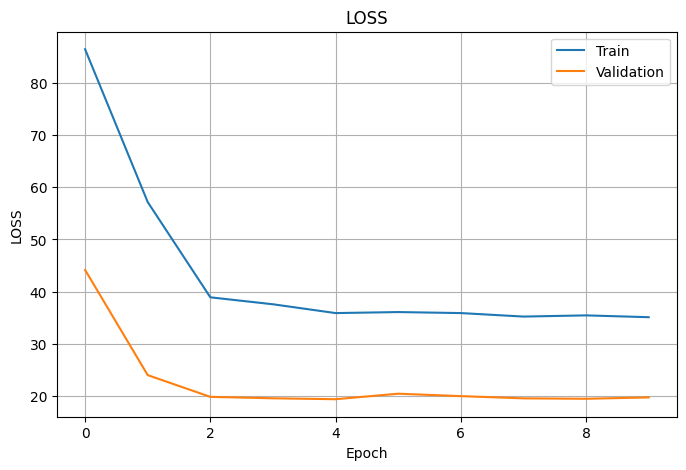

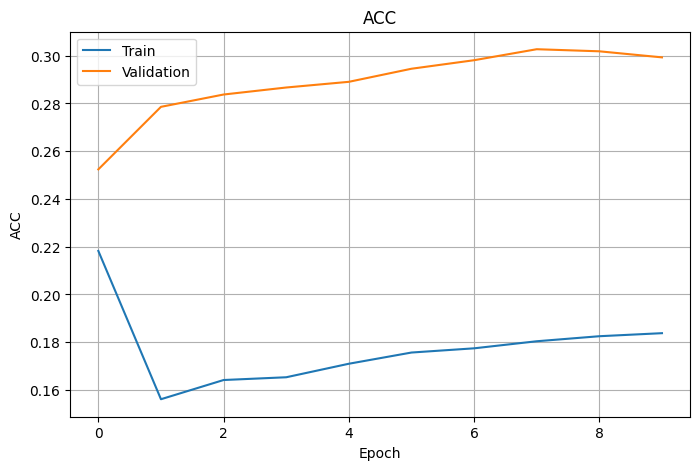

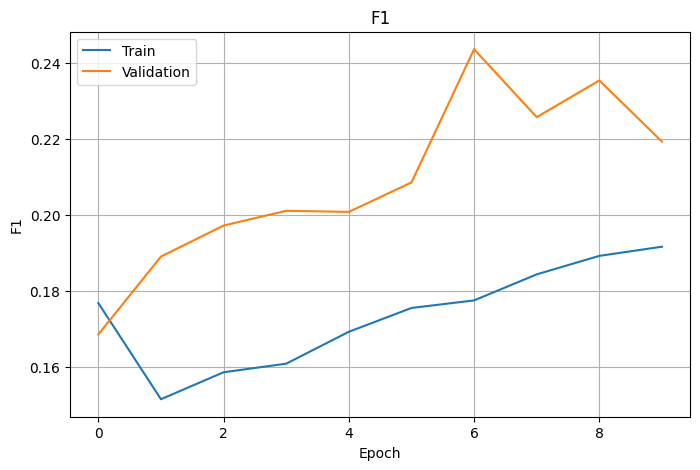

In [98]:
# New ResNet18-based model training and evaluation with new loss_fn and weighted classes
model_rn = MultiHeadClassifierRN18Reg(num_classes)
history_rn = train_and_validate_wgt(
    model_rn,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    lr=1e-4,
    weight_decay=1e-5,
    model_path='best_model_rnreg_wgt.pth',
    temperature=2.0
)
plot_history(history_rn)

## New EfficientNet-B0-based model training and evaluation with new loss_fn and weighted classes


Epoch 1/10


Valid: 100%|██████████| 99/99 [00:12<00:00,  8.08it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.00      0.00      0.00        60
       maize       1.00      0.01      0.02      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.01      3149
   macro avg       0.25      0.25      0.00      3149
weighted avg       0.97      0.01      0.02      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.63      0.39      0.48       893
           M       0.77      0.41      0.54       810
           S       0.10      0.99      0.19       160
           V       0.68      0.34      0.45      1286

    accuracy                           0.40      3149
   macro avg       0.55      0.53      0.41      3149
weighted avg       0.66      0.40      0.47      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.69it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.00      0.00      0.00        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.00      0.25      0.00      3149
weighted avg       0.00      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.61      0.44      0.51       893
           M       0.73      0.57      0.64       810
           S       0.15      0.99      0.25       160
           V       0.73      0.45      0.56      1286

    accuracy                           0.51      3149
   macro avg       0.55      0.61      0.49      3149
weighted avg       0.67      0.51      0.55      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.15it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.00      0.00      0.00        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.00      0.25      0.00      3149
weighted avg       0.00      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.59      0.56      0.58       893
           M       0.74      0.60      0.67       810
           S       0.38      0.96      0.54       160
           V       0.78      0.76      0.77      1286

    accuracy                           0.67      3149
   macro avg       0.62      0.72      0.64      3149
weighted avg       0.70      0.67      0.68      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.25it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.00      0.00      0.00        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.00      0.25      0.00      3149
weighted avg       0.00      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.63      0.59      0.61       893
           M       0.78      0.70      0.74       810
           S       0.37      0.96      0.53       160
           V       0.80      0.73      0.76      1286

    accuracy                           0.69      3149
   macro avg       0.64      0.74      0.66      3149
weighted avg       0.72      0.69      0.70      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.14it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       1.00      0.07      0.12        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.25      0.27      0.03      3149
weighted avg       0.02      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.65      0.70      0.67       893
           M       0.82      0.62      0.71       810
           S       0.43      0.96      0.60       160
           V       0.84      0.79      0.82      1286

    accuracy                           0.73      3149
   macro avg       0.68      0.77      0.70      3149
weighted avg       0.76      0.73      0.74      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.79it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       1.00      0.05      0.10        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.25      0.26      0.02      3149
weighted avg       0.02      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.66      0.73      0.69       893
           M       0.81      0.71      0.76       810
           S       0.54      0.94      0.69       160
           V       0.88      0.80      0.84      1286

    accuracy                           0.76      3149
   macro avg       0.72      0.80      0.74      3149
weighted avg       0.78      0.76      0.77      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.04it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       1.00      0.15      0.26        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.25      0.29      0.07      3149
weighted avg       0.02      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.66      0.73      0.69       893
           M       0.80      0.71      0.75       810
           S       0.49      0.96      0.65       160
           V       0.89      0.78      0.83      1286

    accuracy                           0.76      3149
   macro avg       0.71      0.79      0.73      3149
weighted avg       0.78      0.76      0.76      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.13it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       1.00      0.12      0.21        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.25      0.28      0.05      3149
weighted avg       0.02      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.64      0.75      0.69       893
           M       0.81      0.70      0.75       810
           S       0.55      0.96      0.70       160
           V       0.89      0.78      0.83      1286

    accuracy                           0.76      3149
   macro avg       0.72      0.80      0.74      3149
weighted avg       0.78      0.76      0.77      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.78it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.91      0.50      0.65        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.01      3149
   macro avg       0.23      0.38      0.16      3149
weighted avg       0.02      0.01      0.01      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.65      0.71      0.68       893
           M       0.80      0.70      0.74       810
           S       0.56      0.96      0.71       160
           V       0.87      0.79      0.83      1286

    accuracy                           0.76      3149
   macro avg       0.72      0.79      0.74      3149
weighted avg       0.77      0.76      0.76      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.99it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       1.00      0.13      0.24        60
       maize       0.00      0.00      0.00      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      1.00      0.00         1

    accuracy                           0.00      3149
   macro avg       0.25      0.28      0.06      3149
weighted avg       0.02      0.00      0.00      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.65      0.77      0.70       893
           M       0.84      0.66      0.74       810
           S       0.52      0.96      0.68       160
           V       0.89      0.80      0.84      1286

    accuracy                           0.76      3149
   macro avg       0.72      0.80      0.74      3149
weighted avg       0.79      0.76      0.77      3149


[Validation Report] Task: damage
              preci

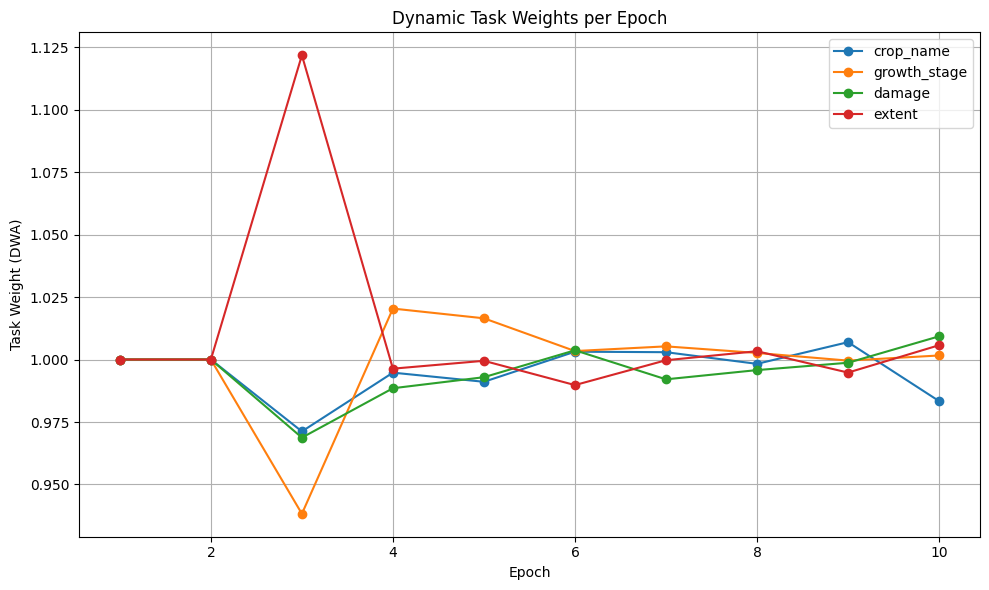

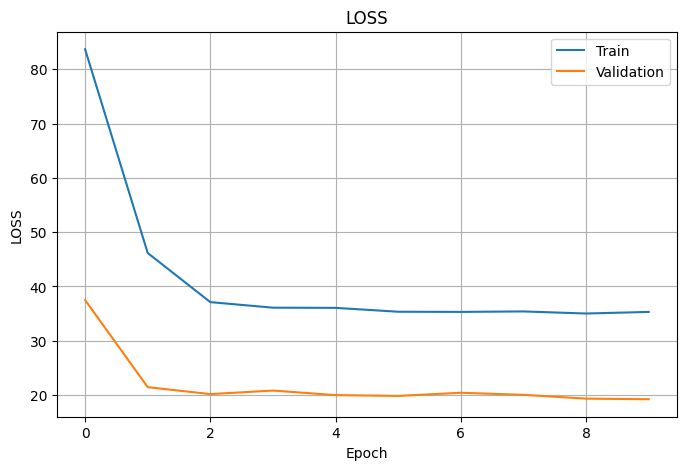

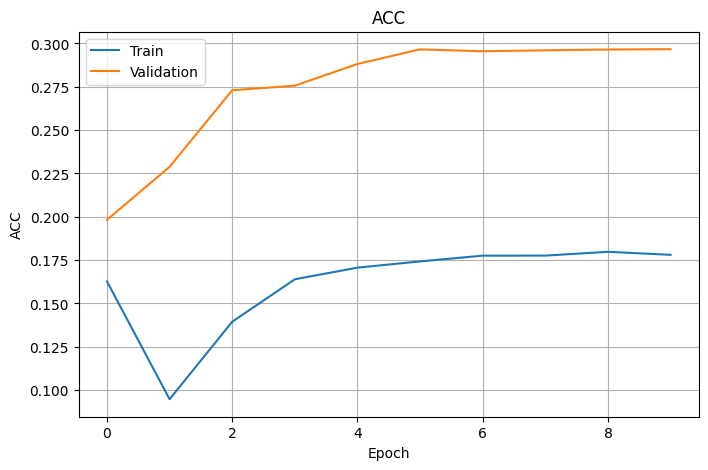

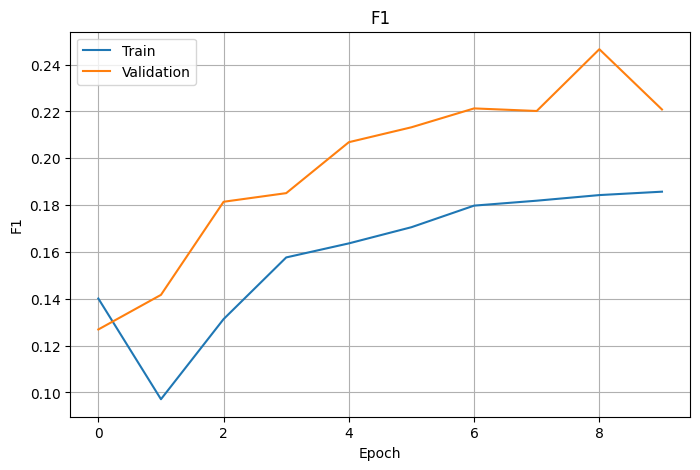

In [99]:
# New EfficientNet-B0-based model training and evaluation with new loss_fn and weighted classes
model_effb0 = MultiHeadClassifierEffB0Reg(num_classes)
history_effb0 = train_and_validate_wgt(
    model_effb0,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    lr=1e-4,
    weight_decay=1e-5,
    model_path='best_model_effb0reg_wgt.pth',
    temperature=2.0
)
plot_history(history_effb0)

In [100]:
# Test New ResNet18-based model trained with new loss_fn
test_rn = test_model(
    model_rn,
    test_loader,
    train_ds.inverse_label_maps,
    device=None,
    print_reports=True,
    model_path='/kaggle/working/best_model_rnreg_wgt.pth'
)

Test: 100%|██████████| 99/99 [00:14<00:00,  6.89it/s]


=== Test Evaluation ===
[crop_name] Accuracy: 0.0086, Macro-F1: 0.1252
              precision    recall  f1-score   support

  green gram       0.60      0.43      0.50        61
       maize       0.00      0.00      0.00      3058
     sorghum       0.00      0.00      0.00        29
     soybean       0.00      1.00      0.00         1

    accuracy                           0.01      3149
   macro avg       0.15      0.36      0.13      3149
weighted avg       0.01      0.01      0.01      3149

[growth_stage] Accuracy: 0.7504, Macro-F1: 0.7352
              precision    recall  f1-score   support

           F       0.62      0.74      0.68       894
           M       0.82      0.63      0.71       810
           S       0.57      0.96      0.71       160
           V       0.87      0.80      0.84      1285

    accuracy                           0.75      3149
   macro avg       0.72      0.78      0.74      3149
weighted avg       0.77      0.75      0.75      3149

[damage]

In [101]:
# Test New EfficientNet-B0-based trained with new loss_fn
test_effb0 = test_model(
    model_effb0,
    test_loader,
    train_ds.inverse_label_maps,
    device=None,
    print_reports=True, 
    model_path='/kaggle/working/best_model_effb0reg_wgt.pth'
)

Test: 100%|██████████| 99/99 [00:12<00:00,  7.80it/s]



=== Test Evaluation ===
[crop_name] Accuracy: 0.0073, Macro-F1: 0.1210
              precision    recall  f1-score   support

  green gram       0.73      0.36      0.48        61
       maize       0.00      0.00      0.00      3058
     sorghum       0.00      0.00      0.00        29
     soybean       0.00      1.00      0.00         1

    accuracy                           0.01      3149
   macro avg       0.18      0.34      0.12      3149
weighted avg       0.01      0.01      0.01      3149

[growth_stage] Accuracy: 0.7463, Macro-F1: 0.7278
              precision    recall  f1-score   support

           F       0.65      0.71      0.68       894
           M       0.77      0.66      0.71       810
           S       0.55      0.93      0.69       160
           V       0.86      0.80      0.83      1285

    accuracy                           0.75      3149
   macro avg       0.71      0.78      0.73      3149
weighted avg       0.76      0.75      0.75      3149

[damage]

## Conclusion on training with weighted loss function

Loss for each task decreases, but for crop name for the largest classes in the metrics there are zeros, for extent for all classes there are zeros. For growing stage the metrics are about the same, even a little worse than before the modification of the models and the addition of the new loss function. For damage, accuracy is better, and F1 is about the same, even a little worse than before all the modifications.This means that:
- model makes predictions within one or two classes, almost always the same, and we can see it from classification reports,
- even if the loss decreases, this does not mean that the model learns to distinguish between classes.
Probably, the class weights + smoothing made the loss function too soft - the gradient for these tasks became weak.
Next steps for improvement: DWA off, weights off for tasks where F1=0.

## Training new models without DWA and weights in loss function


Epoch 1/10


Valid: 100%|██████████| 99/99 [00:12<00:00,  8.12it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.36      0.35      0.35        60
       maize       0.98      0.99      0.98      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.96      3149
   macro avg       0.33      0.33      0.33      3149
weighted avg       0.96      0.96      0.96      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.65      0.77      0.70       893
           M       0.85      0.64      0.73       810
           S       0.85      0.76      0.80       160
           V       0.86      0.90      0.88      1286

    accuracy                           0.79      3149
   macro avg       0.80      0.77      0.78      3149
weighted avg       0.80      0.79      0.79      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.28it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.79      0.18      0.30        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.97      3149
   macro avg       0.44      0.30      0.32      3149
weighted avg       0.96      0.97      0.96      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.69      0.72      0.71       893
           M       0.78      0.76      0.77       810
           S       0.70      0.89      0.78       160
           V       0.89      0.86      0.87      1286

    accuracy                           0.79      3149
   macro avg       0.77      0.81      0.78      3149
weighted avg       0.80      0.79      0.80      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.31it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.56      0.45      0.50        60
       maize       0.98      0.99      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.97      3149
   macro avg       0.39      0.36      0.37      3149
weighted avg       0.96      0.97      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.68      0.78      0.73       893
           M       0.85      0.68      0.76       810
           S       0.84      0.83      0.84       160
           V       0.88      0.90      0.89      1286

    accuracy                           0.81      3149
   macro avg       0.81      0.80      0.80      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.35it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.81      0.37      0.51        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.45      0.34      0.37      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.74      0.65      0.70       893
           M       0.73      0.86      0.79       810
           S       0.80      0.90      0.85       160
           V       0.91      0.87      0.89      1286

    accuracy                           0.81      3149
   macro avg       0.80      0.82      0.81      3149
weighted avg       0.81      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.32it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.75      0.45      0.56        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.43      0.36      0.39      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.76      0.74       893
           M       0.86      0.70      0.78       810
           S       0.84      0.84      0.84       160
           V       0.86      0.93      0.89      1286

    accuracy                           0.82      3149
   macro avg       0.82      0.81      0.81      3149
weighted avg       0.82      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.15it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.74      0.48      0.59        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.43      0.37      0.39      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.75      0.69      0.72       893
           M       0.79      0.81      0.80       810
           S       0.83      0.86      0.84       160
           V       0.88      0.91      0.90      1286

    accuracy                           0.82      3149
   macro avg       0.81      0.82      0.81      3149
weighted avg       0.82      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.29it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.66      0.65      0.66        60
       maize       0.99      0.99      0.99      3060
     sorghum       1.00      0.07      0.13        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.66      0.43      0.44      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.75      0.73      0.74       893
           M       0.82      0.80      0.81       810
           S       0.81      0.84      0.82       160
           V       0.88      0.91      0.90      1286

    accuracy                           0.82      3149
   macro avg       0.81      0.82      0.82      3149
weighted avg       0.82      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.31it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.69      0.72      0.70        60
       maize       0.99      0.99      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.42      0.43      0.42      3149
weighted avg       0.97      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.81      0.76       893
           M       0.88      0.72      0.79       810
           S       0.79      0.88      0.83       160
           V       0.89      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.97it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.79      0.57      0.66        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.75      0.11      0.19        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.63      0.42      0.46      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.77      0.75       893
           M       0.85      0.76      0.81       810
           S       0.80      0.88      0.84       160
           V       0.89      0.90      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.83      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.26it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.74      0.70      0.72        60
       maize       0.99      1.00      0.99      3060
     sorghum       0.80      0.14      0.24        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.63      0.46      0.49      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.70      0.81      0.76       893
           M       0.86      0.75      0.80       810
           S       0.82      0.84      0.83       160
           V       0.91      0.88      0.89      1286

    accuracy                           0.83      3149
   macro avg       0.82      0.82      0.82      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

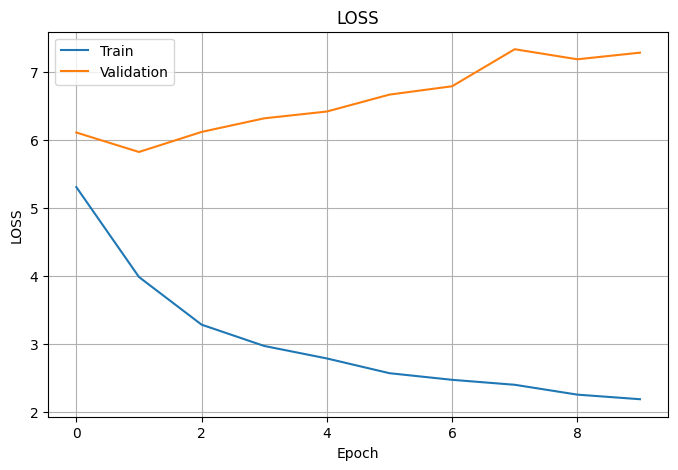

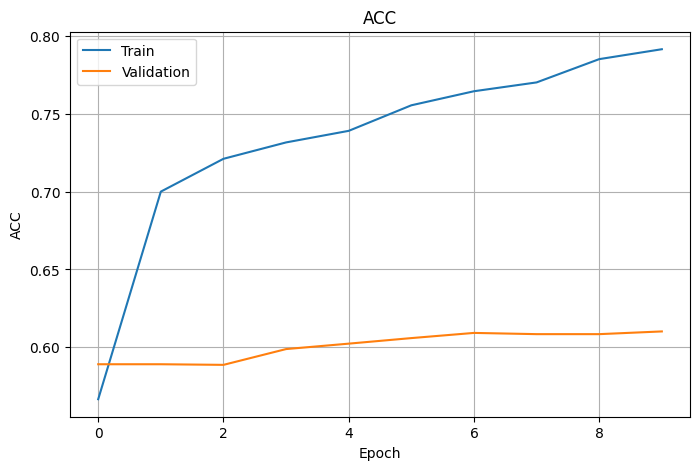

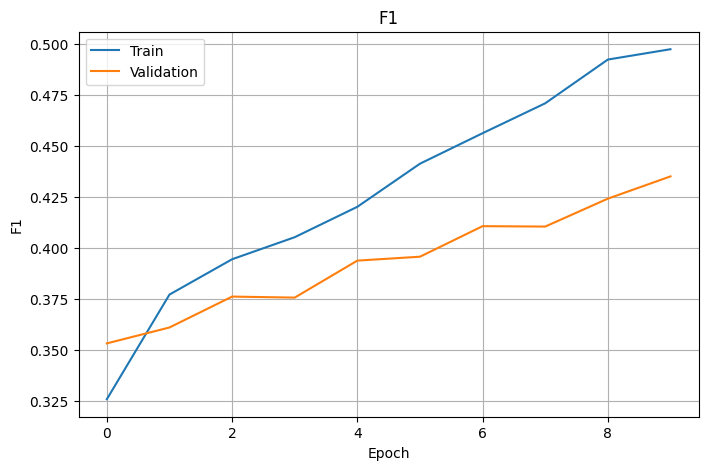

In [102]:
# New ResNet18-based model training and evaluation without dwa and weights but with data augmentation
model_rn = MultiHeadClassifierRN18Reg(num_classes)
history_rn = train_and_validate_reg(
    model_rn,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    lr=1e-4,
    weight_decay=1e-5,
    model_path='best_model_rnreg_reg.pth'
)
plot_history(history_rn)


Epoch 1/10


Valid: 100%|██████████| 99/99 [00:12<00:00,  7.84it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.33      0.43      0.38        60
       maize       0.98      0.98      0.98      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.96      3149
   macro avg       0.33      0.35      0.34      3149
weighted avg       0.96      0.96      0.96      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.63      0.80      0.71       893
           M       0.85      0.63      0.72       810
           S       0.75      0.86      0.80       160
           V       0.88      0.84      0.86      1286

    accuracy                           0.78      3149
   macro avg       0.78      0.78      0.77      3149
weighted avg       0.79      0.78      0.78      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.18it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.67      0.30      0.41        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.97      3149
   macro avg       0.41      0.32      0.35      3149
weighted avg       0.96      0.97      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.69      0.70       893
           M       0.81      0.73      0.76       810
           S       0.76      0.86      0.80       160
           V       0.85      0.91      0.88      1286

    accuracy                           0.80      3149
   macro avg       0.78      0.80      0.79      3149
weighted avg       0.80      0.80      0.79      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.08it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.74      0.43      0.55        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.43      0.36      0.38      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.69      0.70       893
           M       0.80      0.74      0.77       810
           S       0.84      0.78      0.81       160
           V       0.85      0.91      0.88      1286

    accuracy                           0.80      3149
   macro avg       0.80      0.78      0.79      3149
weighted avg       0.80      0.80      0.80      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.20it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.90      0.43      0.58        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.47      0.36      0.39      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.76      0.73       893
           M       0.83      0.72      0.77       810
           S       0.86      0.87      0.86       160
           V       0.88      0.91      0.89      1286

    accuracy                           0.82      3149
   macro avg       0.82      0.81      0.82      3149
weighted avg       0.82      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.71it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.87      0.57      0.69        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.46      0.39      0.42      3149
weighted avg       0.97      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.71      0.75      0.73       893
           M       0.85      0.70      0.77       810
           S       0.86      0.89      0.87       160
           V       0.86      0.93      0.90      1286

    accuracy                           0.81      3149
   macro avg       0.82      0.81      0.82      3149
weighted avg       0.82      0.81      0.81      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.23it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.79      0.57      0.66        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.00      0.00      0.00        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.44      0.39      0.41      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.72      0.76      0.74       893
           M       0.82      0.74      0.78       810
           S       0.83      0.89      0.86       160
           V       0.89      0.91      0.90      1286

    accuracy                           0.82      3149
   macro avg       0.82      0.82      0.82      3149
weighted avg       0.82      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:11<00:00,  8.34it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.86      0.50      0.63        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.33      0.04      0.06        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.54      0.38      0.42      3149
weighted avg       0.97      0.98      0.97      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.75      0.72      0.73       893
           M       0.82      0.77      0.79       810
           S       0.86      0.89      0.87       160
           V       0.87      0.92      0.90      1286

    accuracy                           0.82      3149
   macro avg       0.82      0.82      0.82      3149
weighted avg       0.82      0.82      0.82      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.88it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.84      0.53      0.65        60
       maize       0.98      1.00      0.99      3060
     sorghum       1.00      0.07      0.13        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.71      0.40      0.44      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.73      0.76      0.75       893
           M       0.83      0.76      0.79       810
           S       0.86      0.87      0.86       160
           V       0.89      0.92      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.83      0.82      0.83      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  7.84it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.83      0.58      0.69        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.40      0.07      0.12        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.55      0.41      0.45      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.77      0.72      0.74       893
           M       0.81      0.80      0.81       810
           S       0.84      0.90      0.87       160
           V       0.88      0.92      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.83      0.83      0.83      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

Valid: 100%|██████████| 99/99 [00:12<00:00,  8.17it/s]



[Validation Report] Task: crop_name
              precision    recall  f1-score   support

  green gram       0.85      0.58      0.69        60
       maize       0.98      1.00      0.99      3060
     sorghum       0.67      0.07      0.13        28
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.63      0.41      0.45      3149
weighted avg       0.98      0.98      0.98      3149


[Validation Report] Task: growth_stage
              precision    recall  f1-score   support

           F       0.76      0.72      0.74       893
           M       0.82      0.79      0.80       810
           S       0.88      0.84      0.86       160
           V       0.87      0.93      0.90      1286

    accuracy                           0.83      3149
   macro avg       0.83      0.82      0.83      3149
weighted avg       0.83      0.83      0.83      3149


[Validation Report] Task: damage
              preci

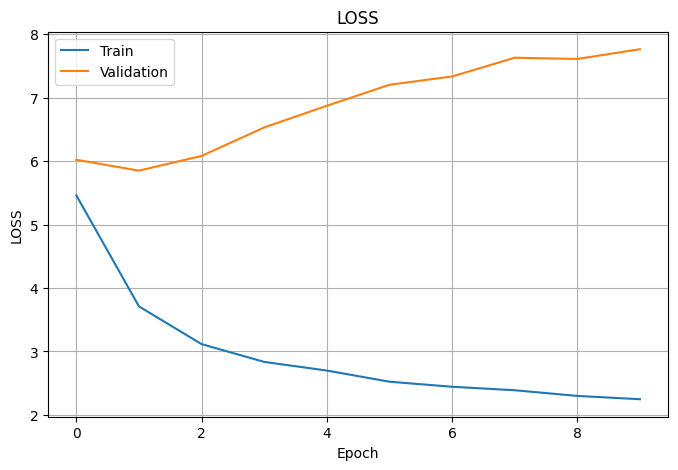

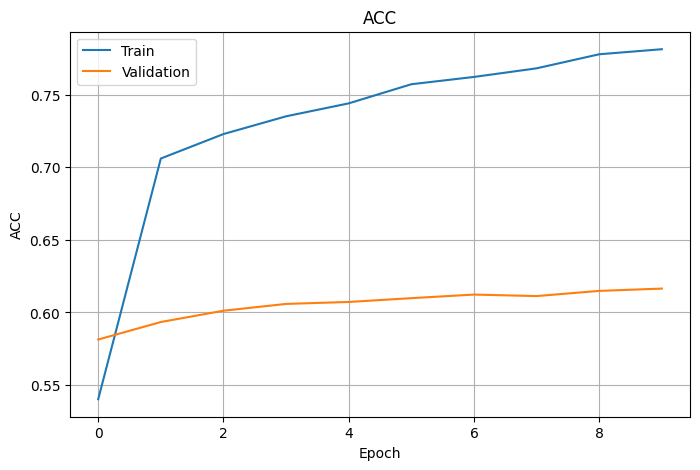

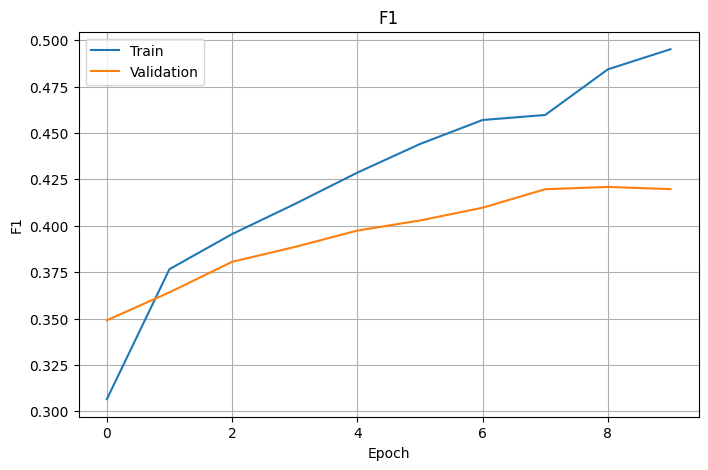

In [103]:
# New EfficientNet-B0-based model training and evaluation without dwa and weights but with data augmentation
model_effb0 = MultiHeadClassifierEffB0Reg(num_classes)
history_effb0 = train_and_validate_reg(
    model_effb0,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    lr=1e-4,
    weight_decay=1e-5,
    model_path='best_model_effb0reg_reg.pth'
)
plot_history(history_effb0)

In [104]:
# Test New ResNet18-based model trained without DWA and new loss_fn
test_rn = test_model(
    model_rn,
    test_loader,
    train_ds.inverse_label_maps,
    device=None,
    print_reports=True,
    model_path='/kaggle/working/best_model_rnreg_reg.pth'
)

Test: 100%|██████████| 99/99 [00:14<00:00,  6.89it/s]


=== Test Evaluation ===
[crop_name] Accuracy: 0.9790, Macro-F1: 0.4418
              precision    recall  f1-score   support

  green gram       0.72      0.59      0.65        61
       maize       0.98      1.00      0.99      3058
     sorghum       1.00      0.07      0.13        29
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.68      0.41      0.44      3149
weighted avg       0.98      0.98      0.97      3149

[growth_stage] Accuracy: 0.8142, Macro-F1: 0.8110
              precision    recall  f1-score   support

           F       0.70      0.79      0.74       894
           M       0.80      0.72      0.76       810
           S       0.86      0.83      0.84       160
           V       0.91      0.89      0.90      1285

    accuracy                           0.81      3149
   macro avg       0.82      0.81      0.81      3149
weighted avg       0.82      0.81      0.82      3149

[damage]

In [105]:
# Test New EfficientNet-B0-based trained without DWA and new loss_fn
test_effb0 = test_model(
    model_effb0,
    test_loader,
    train_ds.inverse_label_maps,
    device=None,
    print_reports=True, 
    model_path='/kaggle/working/best_model_effb0reg_reg.pth'
)

Test: 100%|██████████| 99/99 [00:12<00:00,  7.99it/s]


=== Test Evaluation ===
[crop_name] Accuracy: 0.9765, Macro-F1: 0.4009
              precision    recall  f1-score   support

  green gram       0.73      0.44      0.55        61
       maize       0.98      1.00      0.99      3058
     sorghum       0.50      0.03      0.06        29
     soybean       0.00      0.00      0.00         1

    accuracy                           0.98      3149
   macro avg       0.55      0.37      0.40      3149
weighted avg       0.97      0.98      0.97      3149

[growth_stage] Accuracy: 0.8136, Macro-F1: 0.8075
              precision    recall  f1-score   support

           F       0.74      0.70      0.72       894
           M       0.79      0.77      0.78       810
           S       0.83      0.84      0.84       160
           V       0.87      0.92      0.89      1285

    accuracy                           0.81      3149
   macro avg       0.81      0.81      0.81      3149
weighted avg       0.81      0.81      0.81      3149

[damage]

As a result, the best metric - Macro-F1 - was obtained on the baseline of the ResNet18 model with DWA. Some damage classes are not predicted at all, although they have quite a lot of samples. Perhaps the labels are mixed up, need to check the dataset class and the train, evaluate, test functions. The best quality is on the growth_stage task, the worst is on the damage. Due to Kaggle quota expiration and time constraints, I cannot check the labels and restart the code now. I will leave this for the model improvement step. Also, it is absolutely necessary to try to expand the minor classes for each of the tasks through augmentations. Weights for classes on the one hand helps against overfiting, but on the other - pure Macro-F1.

# Target revision

After feedback from teacher regarding models quality, we should delete some underrepresented classes, because it seems impossible to obtain good quality with them even using special augmentations.    
So, let's drop:
- from crop name: 'green gram', 'sorghum', 'soybean'
- from damage: 'DS', 'ND', 'PS', 'DS', 'WN', 'FD'.   
Rest of the labels leave as it is.

In [106]:
labels_df_cleaned.columns

Index(['filename', 'crop_name', 'growth_stage', 'damage', 'extent',
       'stratify_label'],
      dtype='object')

## Delete rare classes from 'crop_name' and 'damage'

In [107]:
labels_df_cleaned = labels_df_cleaned[
(labels_df_cleaned['crop_name'] == 'maize') 
& ((labels_df_cleaned['damage'] == 'G') | (labels_df_cleaned['damage'] == 'WD') | (labels_df_cleaned['damage'] == 'DR'))
]
# Check label cardinality 
for col in ['crop_name', 'growth_stage', 'damage', 'extent']:
    print(f"{col}: {labels_df_cleaned[col].nunique()} unique classes")

crop_name: 1 unique classes
growth_stage: 4 unique classes
damage: 3 unique classes
extent: 11 unique classes


In [108]:
labels_df_cleaned = labels_df_cleaned[['filename', 'growth_stage', 'damage', 'extent']]
labels_df_cleaned.columns

Index(['filename', 'growth_stage', 'damage', 'extent'], dtype='object')

## Create new train, valid, test splits

In [109]:
# 1. Composite label for stratification
labels_df_cleaned['stratify_label'] = (
    labels_df_cleaned['growth_stage'].astype(str) + '_' +
    labels_df_cleaned['damage'].astype(str) + '_' +
    labels_df_cleaned['extent'].astype(str)
)

# 2. Separate out rare classes (occurring < 2 times)
label_counts = labels_df_cleaned['stratify_label'].value_counts()
rare_labels = label_counts[label_counts < 2].index

rare_samples = labels_df_cleaned[labels_df_cleaned['stratify_label'].isin(rare_labels)]
stratifiable_df = labels_df_cleaned[~labels_df_cleaned['stratify_label'].isin(rare_labels)]

# 3. Stratified split on stratifiable data
train_val_df, test_df = train_test_split(
    stratifiable_df,
    test_size=0.15,
    stratify=stratifiable_df['stratify_label'],
    random_state=42
)

train_df, val_df = train_test_split(
    train_val_df,
    test_size=0.15 / 0.85,  # ~17.6% of train_val
    stratify=train_val_df['stratify_label'],
    random_state=42
)

# 4. Add rare samples to training set
train_df = pd.concat([train_df, rare_samples], ignore_index=True)

# 5. Clean up
for d in [train_df, val_df, test_df]:
    d.drop(columns=['stratify_label'], inplace=True)

print(f"Train size: {len(train_df)}")
print(f"Val size: {len(val_df)}")
print(f"Test size: {len(test_df)}")

# 6. Inspect distribution
def inspect_splits(*splits, target='crop_name'):
    for i, split in enumerate(splits):
        print(f"Split {i}:")
        print(split[target].value_counts(normalize=True))
        print()

inspect_splits(train_df, val_df, test_df, target='growth_stage')
inspect_splits(train_df, val_df, test_df, target='damage')
inspect_splits(train_df, val_df, test_df, target='extent')

Train size: 13809
Val size: 2957
Test size: 2957
Split 0:
growth_stage
V    0.411181
F    0.289449
M    0.250054
S    0.049316
Name: proportion, dtype: float64

Split 1:
growth_stage
V    0.411566
F    0.289144
M    0.250254
S    0.049036
Name: proportion, dtype: float64

Split 2:
growth_stage
V    0.411566
F    0.289821
M    0.250592
S    0.048022
Name: proportion, dtype: float64

Split 0:
damage
G     0.435658
WD    0.386849
DR    0.177493
Name: proportion, dtype: float64

Split 1:
damage
G     0.435238
WD    0.387217
DR    0.177545
Name: proportion, dtype: float64

Split 2:
damage
G     0.434900
WD    0.387217
DR    0.177883
Name: proportion, dtype: float64

Split 0:
extent
0.0      0.434789
10.0     0.204649
20.0     0.121949
30.0     0.082845
40.0     0.059309
50.0     0.028677
60.0     0.020639
90.0     0.017742
80.0     0.017597
70.0     0.011659
100.0    0.000145
Name: proportion, dtype: float64

Split 1:
extent
0.0     0.435915
10.0    0.204599
20.0    0.121745
30.0    0.08217

In [110]:
train_df.to_csv("/kaggle/working/train_new.csv", index=False)
val_df.to_csv("/kaggle/working/valid_new.csv", index=False)
test_df.to_csv("/kaggle/working/test_new.csv", index=False)
labels_df_cleaned.to_csv("/kaggle/working/crop_labels_cleaned_new.csv", index=False) # just in case keep whole dataset

As a result, we would not predict crop name anymore, because we left only one of them. So, we nedd to re-create dataset class.

## Create new dataset

In [111]:
class MultiHeadEotGDataset(Dataset):
    def __init__(self, csv_file, image_dir, transform=None, label_maps=None):
        self.df = pd.read_csv(csv_file)
        self.image_dir = image_dir
        self.transform = transform

        # Only 3 labels
        self.label_cols = ['growth_stage', 'damage', 'extent']

        # If label_maps is not passed, build it (only for train)
        if label_maps is None:
            self.label_maps = {
                col: {val: i for i, val in enumerate(sorted(self.df[col].unique()))}
                for col in self.label_cols
            }
        else:
            self.label_maps = label_maps

        # Reverse mappings: int → string
        self.inverse_label_maps = {
            col: {i: val for val, i in self.label_maps[col].items()}
            for col in self.label_cols
        }

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img_path = os.path.join(self.image_dir, row['filename'])
        image = Image.open(img_path).convert("RGB")

        if self.transform:
            image = self.transform(image)

        labels = {
            col: torch.tensor(self.label_maps[col][row[col]], dtype=torch.long)
            for col in self.label_cols
        }

        return image, labels

In [112]:
csv_path = "/kaggle/working/crop_labels_cleaned_new.csv"
image_dir = "/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images"
dataset = MultiHeadEotGDataset(csv_path, image_dir)

## Showing images

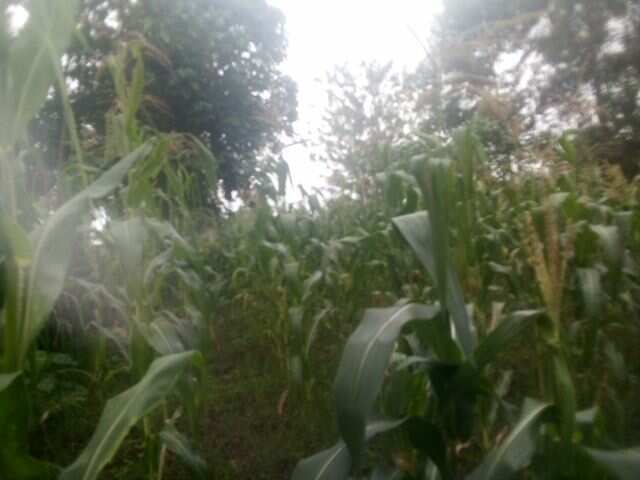

In [113]:
dataset[0][0]

In [114]:
def show_dataset_samples(dataset, num_samples=5):
    indices = random.sample(range(len(dataset)), num_samples)
    plt.figure(figsize=(num_samples * 3, 4))

    for i, idx in enumerate(indices):
        image, label = dataset[idx]
        
        plt.subplot(1, num_samples, i + 1)
        # Для тензора из transform, например ToTensor
        if isinstance(image, torch.Tensor):
            image_np = image.permute(1, 2, 0).numpy()
        else:
            image_np = image  # PIL Image
        
        plt.imshow(image_np)
        
        if isinstance(label, dict):
            title_lines = []
            for key in label:
                class_idx = label[key].item()
                class_name = dataset.inverse_label_maps[key].get(class_idx, f"?{class_idx}")
                title_lines.append(f"{key}: {class_name}")
            title = "\n".join(title_lines)
        else:
            # В случае одиночной метки
            class_idx = label.item()
            title = f"Label: {class_idx}"

        plt.title(title, fontsize=9)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

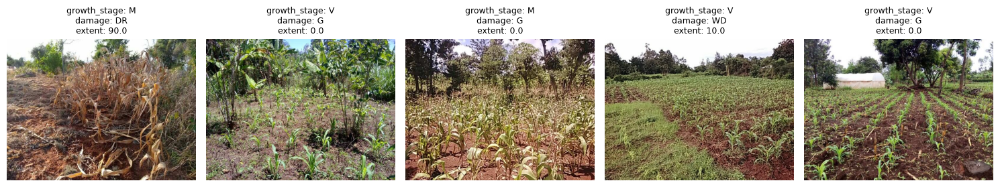

In [115]:
show_dataset_samples(dataset, num_samples=5)

## Data normalization

In [116]:
# Compute train mean and std for further data normalization
# Paths
csv_path = "/kaggle/working/train_new.csv"
image_dir = "/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images"

# Load CSV and extract filenames
df = pd.read_csv(csv_path)
image_paths = [os.path.join(image_dir, fname) for fname in df['filename']]

# Transform to tensor (resizing for consistency)
to_tensor = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

# Accumulate sums
n_images = 0
mean = torch.zeros(3)
std = torch.zeros(3)

for img_path in tqdm(image_paths, desc="Processing images"):
    img = Image.open(img_path).convert("RGB")
    tensor = to_tensor(img)

    mean += tensor.mean(dim=(1, 2))
    std += tensor.std(dim=(1, 2))
    n_images += 1

mean /= n_images
std /= n_images

print(f"Mean: {mean}")
print(f"Std: {std}")

Processing images: 100%|██████████| 13809/13809 [01:27<00:00, 157.53it/s]

Mean: tensor([0.4536, 0.4510, 0.3253])
Std: tensor([0.2462, 0.2511, 0.2887])


## Train, valid, test creation

In [117]:
# Build train, valid, test from dataset
def get_eotg_datasets(
    image_dir,
    train_csv="/kaggle/working/train_new.csv",
    valid_csv="/kaggle/working/valid_new.csv",
    test_csv="/kaggle/working/test_new.csv",
    image_size=(256, 256),
    mean=(0.4536, 0.4510, 0.3253),
    std=(0.2462, 0.2511, 0.2887)
):
    # Shared image transforms
    transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

    # Train dataset creates label maps
    train_ds = MultiHeadEotGDataset(train_csv, image_dir, transform=transform)

    # Valid and test reuse label maps from train
    valid_ds = MultiHeadEotGDataset(
        valid_csv, image_dir, transform=transform, label_maps=train_ds.label_maps
    )
    test_ds = MultiHeadEotGDataset(
        test_csv, image_dir, transform=transform, label_maps=train_ds.label_maps
    )

    return train_ds, valid_ds, test_ds

In [118]:
image_dir = "/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images"

train_ds, valid_ds, test_ds = get_eotg_datasets(image_dir)

In [119]:
# Function for checking samples after transformation
def show_dataset_samples_after_transform(dataset, num_samples=5):
    indices = random.sample(range(len(dataset)), num_samples)
    plt.figure(figsize=(num_samples * 3, 4))

    for i, idx in enumerate(indices):
        image, label = dataset[idx]

        if isinstance(image, torch.Tensor):
            image_pil = F.to_pil_image(image)
        else:
            image_pil = image

        plt.subplot(1, num_samples, i + 1)
        plt.imshow(image_pil)

        if isinstance(label, dict):
            title_lines = []
            for key in label:
                class_idx = label[key].item()
                class_name = dataset.inverse_label_maps[key].get(class_idx, f"?{class_idx}")
                title_lines.append(f"{key}: {class_name}")
            title = "\n".join(title_lines)
        else:
            title = f"Label: {label.item()}"

        plt.title(title, fontsize=9)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

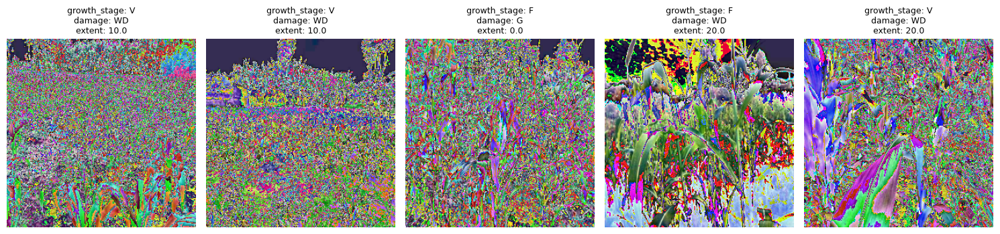

In [120]:
show_dataset_samples_after_transform(train_ds, num_samples=5)

In [121]:
print("Train:", train_ds.label_maps['damage'])
print("Valid:", valid_ds.label_maps['damage'])

Train: {'DR': 0, 'G': 1, 'WD': 2}
Valid: {'DR': 0, 'G': 1, 'WD': 2}


In [122]:
print("Train:", train_ds.label_maps['extent'])
print("Valid:", valid_ds.label_maps['extent'])

Train: {0.0: 0, 10.0: 1, 20.0: 2, 30.0: 3, 40.0: 4, 50.0: 5, 60.0: 6, 70.0: 7, 80.0: 8, 90.0: 9, 100.0: 10}
Valid: {0.0: 0, 10.0: 1, 20.0: 2, 30.0: 3, 40.0: 4, 50.0: 5, 60.0: 6, 70.0: 7, 80.0: 8, 90.0: 9, 100.0: 10}


In [123]:
print("Train:", train_ds.label_maps['growth_stage'])
print("Valid:", valid_ds.label_maps['growth_stage'])

Train: {'F': 0, 'M': 1, 'S': 2, 'V': 3}
Valid: {'F': 0, 'M': 1, 'S': 2, 'V': 3}


In [124]:
print("Classes in valid extent:", sorted(valid_ds.df['extent'].unique()))

Classes in valid extent: [0.0, 10.0, 20.0, 30.0, 40.0, 50.0, 60.0, 70.0, 80.0, 90.0]


In [125]:
# Create dataloaders
train_loader = DataLoader(train_ds, batch_size=32, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_ds, batch_size=32, shuffle=False, num_workers=2)
test_loader  = DataLoader(test_ds, batch_size=32, shuffle=False, num_workers=2)

# New models training and testing

Now, let's try to use Weights and Biases for experiments traking. Model realisations are the same, slightly chenge training and testing code.

In [126]:
import wandb

from kaggle_secrets import UserSecretsClient
user_secrets = UserSecretsClient()
secret_value_0 = user_secrets.get_secret("WANDB _API_KEY")

wandb.login(key=secret_value_0)

wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: anastasiia-gapeeva (a-gapeeva) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


True

In [127]:
def init_wandb_run(
    model_name: str,
    label_maps: dict,
    image_size=(256, 256),
    num_epochs=10,
    learning_rate=1e-4,
    group="effb0_vs_rn18",
    optimizer='Adam',
    loss='CrossEntropy',
    tags=['baseline']
):
    config = {
        "architecture": model_name,
        "image_size": image_size,
        "epochs": num_epochs,
        "learning_rate": learning_rate,
        "optimizer": optimizer,
        "loss": loss,
        "labels": list(label_maps.keys()),
        "num_classes": {k: len(v) for k, v in label_maps.items()}
    }

    wandb.init(
        project="eotg-multilabel",
        name=f"{model_name}_{wandb.util.generate_id()[:4]}",  # run's name
        config=config,
        group=group,
        tags=tags
    )

## Baseline models same as before

In [128]:
# Model based on ResNet18
class MultiHeadClassifierRN18(nn.Module):
    def __init__(self, num_classes_dict):
        super().__init__()
        base_model = resnet18(weights=ResNet18_Weights.IMAGENET1K_V1) # pre-trained model weights on the ImageNet-1K dataset
        self.backbone = nn.Sequential(*list(base_model.children())[:-1])  # remove FC

        self.flatten = nn.Flatten()

        self.heads = nn.ModuleDict({
            name: nn.Linear(base_model.fc.in_features, num_classes)
            for name, num_classes in num_classes_dict.items()
        })

    def forward(self, x):
        x = self.backbone(x)
        x = self.flatten(x)

        outputs = {name: head(x) for name, head in self.heads.items()}
        return outputs  # returns dict: {crop_name: logits, growth_stage: logits, ...}

In [129]:
# Model based on EfficientNet-B0
class MultiHeadClassifierEffB0(nn.Module):
    def __init__(self, num_classes_dict):
        super().__init__()
        base_model = efficientnet_b0(weights=EfficientNet_B0_Weights.IMAGENET1K_V1)

        # Delete classification head and replace it with our heads
        self.backbone = base_model.features
        self.pool = base_model.avgpool  # AdaptiveAvgPool2d(output_size=1)
        self.flatten = nn.Flatten()

        in_features = base_model.classifier[1].in_features  # usually 1280

        self.heads = nn.ModuleDict({
            name: nn.Linear(in_features, num_classes)
            for name, num_classes in num_classes_dict.items()
        })

    def forward(self, x):
        x = self.backbone(x)
        x = self.pool(x)
        x = self.flatten(x)

        outputs = {name: head(x) for name, head in self.heads.items()}
        return outputs  # dict: {crop_name: logits, ...}

In [130]:
num_classes = {col: len(map_) for col, map_ in train_ds.label_maps.items()}
num_classes

{'growth_stage': 4, 'damage': 3, 'extent': 11}

In [131]:
def train_one_epoch(model, dataloader, optimizer, criterion, device):
    model.train()
    running_loss = 0.0
    all_preds = defaultdict(list)
    all_labels = defaultdict(list)

    for inputs, labels in tqdm(dataloader, desc='Train'):
        inputs = inputs.to(device)
        labels = {k: v.to(device) for k, v in labels.items()}

        outputs = model(inputs)
        loss = sum(criterion(outputs[k], labels[k]) for k in outputs.keys() & labels.keys())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

        for key in outputs.keys() & labels.keys():
            preds = torch.argmax(outputs[key], dim=1)
            all_preds[key].extend(preds.cpu().numpy())
            all_labels[key].extend(labels[key].cpu().numpy())

    avg_loss = running_loss / len(dataloader)
    avg_acc = np.mean([accuracy_score(all_labels[k], all_preds[k]) for k in all_preds])
    avg_f1 = np.mean([f1_score(all_labels[k], all_preds[k], average='macro', zero_division=0) for k in all_preds])

    return avg_loss, avg_acc, avg_f1

In [132]:
@torch.inference_mode()
def evaluate(model, dataloader, criterion, inverse_label_maps, device, print_reports=True):
    model.eval()
    running_loss = 0.0
    all_preds = defaultdict(list)
    all_labels = defaultdict(list)

    with torch.no_grad():
        for inputs, labels in tqdm(dataloader, desc='Valid'):
            inputs = inputs.to(device)
            labels = {k: v.to(device) for k, v in labels.items()}

            outputs = model(inputs)
            loss = sum(criterion(outputs[k], labels[k]) for k in outputs.keys() & labels.keys())
            running_loss += loss.item()

            for key in outputs.keys() & labels.keys():
                preds = torch.argmax(outputs[key], dim=1)
                all_preds[key].extend(preds.cpu().numpy())
                all_labels[key].extend(labels[key].cpu().numpy())

    avg_loss = running_loss / len(dataloader)
    avg_acc = np.mean([accuracy_score(all_labels[k], all_preds[k]) for k in all_preds])
    avg_f1 = np.mean([f1_score(all_labels[k], all_preds[k], average='macro', zero_division=0) for k in all_preds])

    if print_reports:
        for key in all_preds:
            y_true = list(map(int, all_labels[key]))
            y_pred = list(map(int, all_preds[key]))
            unique_labels = sorted(set(y_true + y_pred))
            target_names = [str(inverse_label_maps[key][int(i)]) for i in unique_labels]

            print(f"\n[Validation Report] Task: {key}")
            print(classification_report(y_true, y_pred, target_names=target_names, zero_division=0))

    return avg_loss, avg_acc, avg_f1

In [ ]:
def train_and_validate(model, inverse_label_maps, num_epochs=10, 
                       lr=1e-4, model_path='/kaggle/working/best_model.pth', model_name='best_model'):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    best_f1 = 0.0
    best_model_state = None
    best_epoch = -1

    history = {
        "train_loss": [], "val_loss": [],
        "train_acc": [], "val_acc": [],
        "train_f1": [], "val_f1": [],
    }

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")

        train_loss, train_acc, train_f1 = train_one_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, val_f1 = evaluate(
            model,
            valid_loader,
            criterion,
            inverse_label_maps,
            device,
            print_reports=False
        )

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_f1'].append(train_f1)
        history['val_f1'].append(val_f1)

        print(f"[Train] Loss: {train_loss:.4f} | Acc: {train_acc:.4f} | F1: {train_f1:.4f}")
        print(f"[Valid] Loss: {val_loss:.4f} | Acc: {val_acc:.4f} | F1: {val_f1:.4f}")

        # wandb logging
        wandb.log({
            "epoch": epoch + 1,
            "train_loss": train_loss,
            "train_acc": train_acc,
            "train_f1": train_f1,
            "val_loss": val_loss,
            "val_acc": val_acc,
            "val_f1": val_f1,
        })

        # Save best model
        if val_f1 > best_f1:
            best_f1 = val_f1
            best_epoch = epoch
            best_model_state = model.state_dict()
            torch.save(best_model_state, model_path)
            print(f"Saved new best model with F1 = {best_f1:.4f}")

            # wandb artifact
            artifact = wandb.Artifact(
                name=model_name,
                type="model",
                description=f"Best model (val_f1={best_f1:.4f})",
                metadata={
                    "architecture": wandb.config.get("architecture", "unknown"),
                    "val_f1": best_f1,
                    "best_epoch": epoch + 1,
                    "lr": lr,
                }
            )
            artifact.add_file(model_path)
            wandb.log_artifact(artifact)

        # Refreshable plots
        clear_output(wait=True)
        metrics = ['loss', 'acc', 'f1']
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, metric in enumerate(metrics):
            axs[i].plot(history[f"train_{metric}"], label='Train')
            axs[i].plot(history[f"val_{metric}"], label='Validation')
            axs[i].set_title(f"{metric.upper()} over Epochs")
            axs[i].set_xlabel("Epoch")
            axs[i].set_ylabel(metric.upper())
            axs[i].legend()
            axs[i].grid(True)
        plt.tight_layout()
        plt.show()

    # Final evaluation on best model
    print(f"\nEvaluating best model from epoch {best_epoch + 1} with F1 = {best_f1:.4f}")
    model.load_state_dict(best_model_state)
    model.to(device)
    evaluate(
        model,
        valid_loader,
        criterion,
        inverse_label_maps,
        device,
        print_reports=True
    )

    wandb.finish()
    return history

In [ ]:
def test_model(model, dataloader, inverse_label_maps, device=None, print_reports=True, model_path='/kaggle/working/best_model.pth'):
    if device is None:
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model.to(device)
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.eval()

    all_preds = defaultdict(list)
    all_labels = defaultdict(list)

    with torch.no_grad():
        for inputs, labels in tqdm(dataloader, desc='Test'):
            inputs = inputs.to(device)
            labels = {k: v.to(device) for k, v in labels.items()}

            outputs = model(inputs)
            for key in outputs.keys() & labels.keys():
                preds = torch.argmax(outputs[key], dim=1)
                all_preds[key].extend(preds.cpu().numpy())
                all_labels[key].extend(labels[key].cpu().numpy())

    print("\n=== Test Evaluation ===")

    for key in all_preds:
        y_true = list(map(int, all_labels[key]))
        y_pred = list(map(int, all_preds[key]))
        unique_labels = sorted(set(y_true + y_pred))
        target_names = [str(inverse_label_maps[key][int(i)]) for i in unique_labels]
    
        acc = accuracy_score(y_true, y_pred)
        f1 = f1_score(y_true, y_pred, average='macro', zero_division=0)
    
        print(f"[{key}] Accuracy: {acc:.4f}, Macro-F1: {f1:.4f}")
        if print_reports:
            print(classification_report(y_true, y_pred, target_names=target_names, zero_division=0))
    
        # Loging in wandb
        wandb.log({
            f"test/{key}_accuracy": acc,
            f"test/{key}_f1": f1
        })

In [ ]:
model_rn = MultiHeadClassifierRN18(num_classes)
model_effb0 = MultiHeadClassifierEffB0(num_classes)

In [ ]:
init_wandb_run(
    model_name="resnet18",
    label_maps=train_ds.label_maps,
    num_epochs=10,
    learning_rate=1e-4,
    group="effb0_vs_rn18"
)

history_rn = train_and_validate(
    model_rn,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    model_path="best_model_rn_new.pth",
    model_name='resnet18_bsl'
)

In [ ]:
wandb.init(
    project="eotg-multilabel",
    name="test_run_resnet18",
    group="effb0_vs_rn18",
    job_type="test"
)

test_model(
    model_rn,
    test_loader,
    inverse_label_maps=train_ds.inverse_label_maps, 
    model_path='/kaggle/working/best_model_rn_new.pth'
)

In [ ]:
init_wandb_run(
    model_name="effb0",
    label_maps=train_ds.label_maps,
    num_epochs=10,
    learning_rate=1e-4
)
history_effb0 = train_and_validate(
    model_effb0,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    model_path="best_model_effb0_new.pth",
    model_name='effb0_bsl'
)

In [ ]:
wandb.init(
    project="eotg-multilabel",
    name="test_run_effb0",
    group="effb0_vs_rn18",
    job_type="test"
)

test_model(
    model_effb0,
    test_loader,
    inverse_label_maps=train_ds.inverse_label_maps, 
    model_path='/kaggle/working/best_model_effb0_new.pth'
)

##  New train with Early stopping, ReduceLROnPlateau, L2 regularization and Augmentations

In [ ]:
# Let's re-create datasets and transforms
train_csv="/kaggle/working/train_new.csv"
valid_csv="/kaggle/working/valid_new.csv"
test_csv="/kaggle/working/test_new.csv"

image_dir = "/kaggle/input/eyes-on-the-ground-image-data/EotG_data_final_no_git/images"

image_size=(256, 256)
mean=(0.4536, 0.4510, 0.3253)
std=(0.2462, 0.2511, 0.2887)

# Define train image transform
train_transform = transforms.Compose([
    transforms.RandomResizedCrop(image_size, scale=(0.8, 1.0)),
    transforms.RandomHorizontalFlip(p=0.5),                             
    transforms.RandomVerticalFlip(p=0.2),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.02),
    transforms.RandomRotation(degrees=15), 
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std),
])

# Define test/valid image transform
test_transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

# Create datasets
train_ds = MultiHeadEotGDataset(train_csv, image_dir, transform=train_transform)
valid_ds = MultiHeadEotGDataset(valid_csv, image_dir, transform=test_transform)
test_ds = MultiHeadEotGDataset(test_csv, image_dir, transform=test_transform)

# Create dataloaders
train_loader = DataLoader(train_ds, batch_size=32, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_ds, batch_size=32, shuffle=False, num_workers=2)
test_loader  = DataLoader(test_ds, batch_size=32, shuffle=False, num_workers=2)

In [ ]:
# Re-create training and evaluation function with early stopping adding
def train_and_validate_reg(
    model,
    inverse_label_maps,
    num_epochs=10,
    lr=1e-4,
    model_path='/kaggle/working/best_model.pth',
    model_name='best_model'
    weight_decay=1e-5,
    early_stopping_patience=5,
    reduce_lr_patience=2,
    reduce_lr_factor=0.5
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)
    scheduler = ReduceLROnPlateau(optimizer, mode='max', factor=reduce_lr_factor,
                                  patience=reduce_lr_patience, verbose=True)

    best_f1 = 0.0
    best_model_state = None
    best_epoch = -1
    early_stopping_counter = 0

    history = {
        "train_loss": [], "val_loss": [],
        "train_acc": [], "val_acc": [],
        "train_f1": [], "val_f1": [],
    }

    for epoch in range(num_epochs):
        print(f"\nEpoch {epoch + 1}/{num_epochs}")

        train_loss, train_acc, train_f1 = train_one_epoch(model, train_loader, optimizer, criterion, device)
        val_loss, val_acc, val_f1 = evaluate(
            model,
            valid_loader,
            criterion,
            inverse_label_maps,
            device,
            print_reports=False
        )

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_f1'].append(train_f1)
        history['val_f1'].append(val_f1)

        print(f"[Train] Loss: {train_loss:.4f} | Acc: {train_acc:.4f} | F1: {train_f1:.4f}")
        print(f"[Valid] Loss: {val_loss:.4f} | Acc: {val_acc:.4f} | F1: {val_f1:.4f}")

        # wandb logging
        wandb.log({
            "epoch": epoch + 1,
            "train_loss": train_loss,
            "train_acc": train_acc,
            "train_f1": train_f1,
            "val_loss": val_loss,
            "val_acc": val_acc,
            "val_f1": val_f1,
            "lr": optimizer.param_groups[0]["lr"]
        })

        # ReduceLROnPlateau
        scheduler.step(val_f1)

        # Plot
        clear_output(wait=True)
        metrics = ['loss', 'acc', 'f1']
        fig, axs = plt.subplots(1, 3, figsize=(18, 5))
        for i, metric in enumerate(metrics):
            axs[i].plot(history[f"train_{metric}"], label='Train')
            axs[i].plot(history[f"val_{metric}"], label='Validation')
            axs[i].set_title(f"{metric.upper()} over Epochs")
            axs[i].set_xlabel("Epoch")
            axs[i].set_ylabel(metric.upper())
            axs[i].legend()
            axs[i].grid(True)
        plt.tight_layout()
        plt.show()

        # Early stopping and model saving
        if val_f1 > best_f1:
            best_f1 = val_f1
            best_epoch = epoch
            best_model_state = model.state_dict()
            torch.save(best_model_state, model_path)
            print(f"Saved new best model with F1 = {best_f1:.4f}")
            early_stopping_counter = 0

            # wandb artifact
            artifact = wandb.Artifact(
                name=model_name,
                type="model",
                description=f"Best model (val_f1={best_f1:.4f})",
                metadata={
                    "architecture": wandb.config.get("architecture", "unknown"),
                    "val_f1": best_f1,
                    "best_epoch": epoch + 1,
                    "lr": lr,
                    "weight_decay": weight_decay
                }
            )
            artifact.add_file(model_path)
            wandb.log_artifact(artifact)
        else:
            early_stopping_counter += 1
            print(f"⏸ Early stopping counter: {early_stopping_counter}/{early_stopping_patience}")
            if early_stopping_counter >= early_stopping_patience:
                print("Early stopping triggered.")
                break

    # Final evaluation
    print(f"\n Evaluating best model from epoch {best_epoch + 1} with F1 = {best_f1:.4f}")
    model.load_state_dict(best_model_state)
    model.to(device)
    evaluate(
        model,
        valid_loader,
        criterion,
        inverse_label_maps,
        device,
        print_reports=True
    )

    wandb.finish()
    return history

In [ ]:
# Try ResNet18 with early stopping
init_wandb_run(
    model_name="resnet18_reg",
    label_maps=train_ds.label_maps,
    num_epochs=10,
    learning_rate=1e-4,
    group="effb0_vs_rn18"
)

history_rn = train_and_validate_reg(
    model_rn,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    lr=1e-4,
    weight_decay=1e-5,
    early_stopping_patience=5,
    reduce_lr_patience=2,
    reduce_lr_factor=0.5,
    model_path='best_model_rn_reg_new.pth',
    model_name='resnet18_reg'
)

In [ ]:
# Test ResNet18 with early stopping
wandb.init(
    project="eotg-multilabel",
    name="test_run_rn18_reg",
    group="effb0_vs_rn18",
    job_type="test"
)

test_model(
    model_rn,
    test_loader,
    inverse_label_maps=train_ds.inverse_label_maps, 
    model_path='/kaggle/working/best_model_rn_reg_new.pth'
)

In [ ]:
# Try EfficientNet-B0 with early stopping
init_wandb_run(
    model_name="effb0_reg",
    label_maps=train_ds.label_maps,
    num_epochs=10,
    learning_rate=1e-4,
    group="effb0_vs_rn18"
)

history_rn = train_and_validate_reg(
    model_effb0,
    inverse_label_maps=train_ds.inverse_label_maps,
    num_epochs=10,
    lr=1e-4,
    weight_decay=1e-5,
    early_stopping_patience=5,
    reduce_lr_patience=2,
    reduce_lr_factor=0.5,
    model_path='best_model_effb0_reg_new.pth',
    model_name='effb0_reg'
)

In [ ]:
# Test EfficientNet-B0 with early stopping
wandb.init(
    project="eotg-multilabel",
    name="test_run_effb0_reg",
    group="effb0_vs_rn18",
    job_type="test"
)

test_model(
    model_effb0,
    test_loader,
    inverse_label_maps=train_ds.inverse_label_maps, 
    model_path='/kaggle/working/best_model_effb0_reg_new.pth'
)

# Conclusions

As can be seen from the log graphs, the models are still overfitting: the error on the valid increases with the number of epochs, F1 and accuracy do not change much, while on the train, on the contrary, the error decreases and F1 and accuracy increase. At the same time, removing minor classes significantly improved all metrics on the test for damage. Extent and growth stage have approximately same performance as before.    
Using early stopping, ReducelROnPlateau, L2 regularization, augmentations insufficiently improved metrics.   
Both models have almost same performance.   

At the next step we can try augmentations for underrepresented classes in all labels, DWA, new model architecture with BatchNorm and Dropout, weighted loss function, labels smoothing for loss function.

Further model improvements available [here](https://colab.research.google.com/drive/1PGiHLUwLGiY5pNJpfCVfIMSHWldeApIO?usp=sharing)